# Longitudinal Beta Analysis of BSSu Percept recordings

## 0. Loading packages, defining paths

USE KERNEL: bssu (Python 3.10.10)

In [1]:
# Importing Python and external packages


import os
import sys
import importlib
from importlib import reload 
from dataclasses import dataclass, field, fields
from itertools import compress
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from cycler import cycler

import scipy
import scipy.io as sio
from scipy import signal
from scipy.signal import spectrogram, hann, butter, filtfilt, freqz
from scipy import stats

import seaborn as sns
import pingouin as pg
import itertools
from itertools import combinations
from statannotations.Annotator import Annotator
import statsmodels.api as sm
import statsmodels.formula.api as smf
from patsy import dmatrices
import plotly.express as px

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold, GridSearchCV
from sklearn.metrics import classification_report

# import openpyxl
# from openpyxl import Workbook, load_workbook
# import xlrd
import pickle
import json
import csv

#mne
import mne_bids
import mne
from mne.time_frequency import tfr_morlet 
from mne.stats import permutation_cluster_test


# TODO: add README file: 
# pip install pingouin
# pip install statannotations
# pip install fooof
         


Import PyPerceive (has already been installed into the environment bssu)

In [2]:
import py_perceive

If using environment pyPerceive_dev and main branch from gitHub: Set Path to load PyPerceive

In [5]:
#######################     USE THIS DIRECTORY FOR IMPORTING PYPERCEIVE REPO  #######################

# create a path to the BetaSenSightLongterm folder 
# and a path to the code folder within the BetaSenSightLongterm Repo
BetaSenSightLongterm_path = os.getcwd()
while BetaSenSightLongterm_path[-8:] != 'Research':
    BetaSenSightLongterm_path = os.path.dirname(BetaSenSightLongterm_path)

# directory to PyPerceive code folder
PyPerceive_path = os.path.join(BetaSenSightLongterm_path,'PyPerceive_Project', 'Code', 'PyPerceive', 'code')
sys.path.append(PyPerceive_path)

# # change directory to PyPerceive code path within BetaSenSightLongterm Repo
os.chdir(PyPerceive_path)
os.getcwd()

FileNotFoundError: [WinError 2] Das System kann die angegebene Datei nicht finden: 'c:\\Users\\jebe12\\Research\\PyPerceive_Project\\Code\\PyPerceive\\code'

Load PyPerceive

In [3]:
from py_perceive.PerceiveImport.classes import (
    main_class, modality_class, metadata_class,
    session_class, condition_class, task_class,
    contact_class, run_class
)
import py_perceive.PerceiveImport.methods.load_rawfile as load_rawfile
import py_perceive.PerceiveImport.methods.find_folders as find_folders
import py_perceive.PerceiveImport.methods.metadata_helpers as metaHelpers


importlib.reload(main_class)
importlib.reload(session_class)
importlib.reload(task_class)
importlib.reload(condition_class)
importlib.reload(contact_class)
importlib.reload(metadata_class)
importlib.reload(modality_class)
importlib.reload(load_rawfile)
importlib.reload(find_folders)
importlib.reload(run_class)
importlib.reload(metaHelpers)

<module 'py_perceive.PerceiveImport.methods.metadata_helpers' from 'C:\\Users\\jebe12\\Research\\PyPerceive_Project\\Code\\PyPerceive\\src\\py_perceive\\PerceiveImport\\methods\\metadata_helpers.py'>

Import Gunnar`s meet Toolbox

In [4]:
#######################     USE THIS DIRECTORY FOR WORKING WITH FOLDERS INSIDE OF CODE FOLDER OF BETASENSIGHTLONGTERM REPO  #######################


# create a path to the BetaSenSightLongterm folder 
# and a path to the code folder within the BetaSenSightLongterm Repo
current_path = os.getcwd()
while current_path[-8:] != 'Research':
    current_path = os.path.dirname(current_path)

# directory to code folder
code_path = os.path.join(current_path, 'Longterm_beta_project','Code', 'meet')
sys.path.append(code_path)

# # change directory to code path within BetaSenSightLongterm Repo
os.chdir(code_path)
os.getcwd()


'c:\\Users\\jebe12\\Research\\Longterm_beta_project\\Code\\meet'

In [5]:
import meet as meet

Set Path back to BetaSenSightLongterm Repo

In [6]:
#######################     USE THIS DIRECTORY FOR WORKING WITH FOLDERS INSIDE OF CODE FOLDER OF BETASENSIGHTLONGTERM REPO  #######################


# create a path to the BetaSenSightLongterm folder 
# and a path to the code folder within the BetaSenSightLongterm Repo
current_path = os.getcwd()
while current_path[-8:] != 'Research':
    current_path = os.path.dirname(current_path)

# directory to code folder
code_path = os.path.join(current_path, 'Longterm_beta_project','Code', 'BetaSenSightLongterm')
sys.path.append(code_path)

# # change directory to code path within BetaSenSightLongterm Repo
os.chdir(code_path)
os.getcwd()

'c:\\Users\\jebe12\\Research\\Longterm_beta_project\\Code\\BetaSenSightLongterm'

Load analysis functions

In [16]:
# tfr, processing
import src.bssu.tfr.BSSuPsd as BSSuPsd
import src.bssu.tfr.FastFourierPSD as FFpsd

# bipolar Channel Analysis
import src.bssu.bipolar.power_spectra_plots as power_spectra_plots
import src.bssu.bipolar.PeakFrequencies_PSD as PeakFrequency_psd
import src.bssu.bipolar.BIP_channelGroups as BIP_channelGroups
import src.bssu.bipolar.BIP_perChannelAnalysis as BIP_perChannel
import src.bssu.bipolar.cluster_perm as cluster_perm


# monopolar Referencing
import src.bssu.monopolar.MonoRef_JLB as MonoRefJLB
import src.bssu.monopolar.GroupMonopolarPSD as groupMonopol

# Ranking Order
import src.bssu.ranking.HighestRankedChannelPSD as highestRank
import src.bssu.ranking.monopolPSDaverage_withinSubject as PSDaverageMonopol
import src.bssu.ranking.BIPchannelGroups_ranks as BIP_ranks
import src.bssu.ranking.Permutation_rankings as Permute_ranks


# Clinical stimulation parameters
import src.bssu.stimulation.activeStimulationContacts as activeStimContacts

# utility functions
import src.bssu.utils.loadResults as loadResults
import src.bssu.utils.find_folders as find_folders
import src.bssu.utils.writeGroupDataframes as writeGroupDF

# import Classes
from src.bssu.classes import (metadataAnalysis_class, mainAnalysis_class, sessionAnalysis_class, 
                              channelAnalysis_class, featureAnalysis_class, frequencyBand_class)

# import mni coordinates
import src.bssu.mni.load_rotated_coordinates as load_mni


importlib.reload(BSSuPsd)
importlib.reload(MonoRefJLB)
importlib.reload(loadResults)
importlib.reload(highestRank)
importlib.reload(groupMonopol)
importlib.reload(PSDaverageMonopol)
importlib.reload(FFpsd)
importlib.reload(find_folders)
importlib.reload(metadataAnalysis_class)
importlib.reload(mainAnalysis_class)
importlib.reload(sessionAnalysis_class)
importlib.reload(channelAnalysis_class)
importlib.reload(featureAnalysis_class)
importlib.reload(frequencyBand_class)
importlib.reload(PeakFrequency_psd)
importlib.reload(power_spectra_plots)
importlib.reload(BIP_channelGroups)
importlib.reload(BIP_ranks)
importlib.reload(activeStimContacts)
importlib.reload(Permute_ranks)
importlib.reload(BIP_perChannel)
importlib.reload(load_mni)
importlib.reload(writeGroupDF)
importlib.reload(cluster_perm)

<module 'src.bssu.bipolar.cluster_perm' from 'c:\\Users\\jebe12\\Research\\Longterm_beta_project\\Code\\BetaSenSightLongterm\\src\\bssu\\bipolar\\cluster_perm.py'>

In [8]:
# load if you want to see complete Dataframes
pd.set_option("display.max_rows", None)

## 0. Load PSD data using classes

In [26]:
data = mainAnalysis_class.MainClass(
        sub="024",
        hemisphere="Right",
        filter="band-pass",
        result="PSDaverageFrequencyBands",
        incl_session=["postop", "fu3m", "fu12m", "fu18m"],
        pickChannels=['03', '13', '02', '12', '01', '23', 
                        '1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C', 
                        '1A2A', '1B2B', '1C2C'],
        normalization=["rawPsd"],
        freqBands=["beta", "lowBeta", "highBeta"],
        feature=["averagedPSD"]
    )

In [27]:
data.postop.BIP_01.rawPsd.Result_DF

,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD
postop_LFP_R_01_STN_MT_psdAverage_rawPsd_alpha,postop,LFP_R_01_STN_MT,alpha,rawPsd,0.542981
postop_LFP_R_01_STN_MT_psdAverage_rawPsd_lowBeta,postop,LFP_R_01_STN_MT,lowBeta,rawPsd,0.455778
postop_LFP_R_01_STN_MT_psdAverage_rawPsd_highBeta,postop,LFP_R_01_STN_MT,highBeta,rawPsd,0.179073
postop_LFP_R_01_STN_MT_psdAverage_rawPsd_beta,postop,LFP_R_01_STN_MT,beta,rawPsd,0.275318
postop_LFP_R_01_STN_MT_psdAverage_rawPsd_narrowGamma,postop,LFP_R_01_STN_MT,narrowGamma,rawPsd,0.022019


## 0.a Load PSD average from all subjects to share

In [32]:
incl_sub = ["017", "019", "021", "024", "025", "026", "029", "030", "031", "032", "033", "037", "038", "040", "041", "045"]
hemispheres = ["Right", "Left"]

psdAverage_dataframe = pd.DataFrame()

for sub in incl_sub:

    for hem in hemispheres:

        # load data from classes
        mainClass_data = mainAnalysis_class.MainClass(
            sub=sub,
            hemisphere=hem,
            filter="band-pass",
            result="PSDaverageFrequencyBands",
            incl_session=["fu3m"],
            pickChannels=['03', '13', '02', '12', '01', '23', 
                            '1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C', 
                            '1A2A', '1B2B', '1C2C'],
            normalization=["rawPsd"],
            freqBands=["beta", "lowBeta", "highBeta"],
            feature=["averagedPSD"]
        )

        # get the fu3m Dataframe
        fu3m_DF = mainClass_data.fu3m.Result_DF
        fu3m_DF_copy = fu3m_DF.copy()

        # add columnn subject_hemisphere
        fu3m_DF_copy["subject_hemisphere"] = f"{sub}_{hem}"

        # add column recording_montage
        for index, row in fu3m_DF_copy.iterrows():
            bipolarChannel = row["bipolarChannel"].split("_")
            recording_montage = bipolarChannel[2] # just take 03, 02, etc from bipolarChannel column

            fu3m_DF_copy.loc[index, "recording_montage"] = recording_montage
        
        # only get rows with rawPsd and beta 
        fu3m_DF_copy = fu3m_DF_copy[fu3m_DF_copy.absoluteOrRelativePSD == "rawPsd"]
        fu3m_DF_copy = fu3m_DF_copy[fu3m_DF_copy.frequencyBand == "beta"]

        # rename column averagedPSD to beta_psd
        fu3m_DF_copy = fu3m_DF_copy.rename(columns={"averagedPSD": "beta_psd"})
        
        # drop columns bipolarChannel, 
        fu3m_DF_copy = fu3m_DF_copy.drop(columns=["bipolarChannel", "frequencyBand", "absoluteOrRelativePSD"])

        # concatenate all dataframes together
        psdAverage_dataframe = pd.concat([psdAverage_dataframe, fu3m_DF_copy], ignore_index=True)
                



# write Dataframe to Excel
# store each Dataframe in seperate sheets of an Excel file
current_path = os.getcwd()
while current_path[-8:] != 'Research':
    current_path = os.path.dirname(current_path)

Excel_path = os.path.join(current_path, 'Longterm_beta_project','data', 'imagingData', 'SenSight_fu3m_beta_psd.xlsx')

# create an Excel writer, so that different sheets are written within the same excel file
with pd.ExcelWriter(Excel_path) as writer:
    
    psdAverage_dataframe.to_excel(writer, sheet_name="beta_psd")





In [33]:
psdAverage_dataframe

,session,beta_psd,subject_hemisphere,recording_montage
0,fu3m,0.203105,017_Right,03
1,fu3m,0.281449,017_Right,13
2,fu3m,0.400901,017_Right,02
3,fu3m,0.298595,017_Right,12
4,fu3m,0.131716,017_Right,01
...,...,...,...,...
475,fu3m,0.210877,045_Left,2B2C
476,fu3m,0.215862,045_Left,2A2C
477,fu3m,0.417217,045_Left,1A2A
478,fu3m,0.463712,045_Left,1B2B


In [6]:
write_DF_function = writeGroupDF.write_BIPChannelGroups_ALLpsd(
    incl_sub=["017", "019", "021", "024", "025", "026", "028", "029", "030", "031", "032", "033", "038"], 
    signalFilter="band-pass",
    normalization="rawPsd",
    freqBand="beta"
)

In [7]:
write_DF_function["psdAverage_dataframe"].head()

,session,absoluteOrRelativePSD,beta_psd,subject_hemisphere,recording_montage,recording_montage_group,recording_montage_specificGroup
0,fu3m,rawPsd,0.203105,017_Right,03,circular,circular_ring_ring
1,fu3m,rawPsd,0.281449,017_Right,13,circular,circular_ring_segm_long
2,fu3m,rawPsd,0.400901,017_Right,02,circular,circular_ring_segm_long
3,fu3m,rawPsd,0.298595,017_Right,12,circular,circular_segm_segm
4,fu3m,rawPsd,0.131716,017_Right,01,circular,circular_ring_segm_short


write Dataframe for all subject hemispheres with ranks and relative PSD to rank 1

In [8]:
loaded_DF = writeGroupDF.write_BIPChannelGroups_psdRanks_relToRank1(
    signalFilter="band-pass",
    normalization="rawPsd",
    freqBand="beta"
)

pickle file loaded:  BIPChannelGroups_ALL_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
file:  BIPChannelGroups_psdRanks_relToRank1_beta_rawPsd_band-pass.pickle 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [9]:
loaded_DF["psdRank_and_relative_dataframe"].head()

,session,absoluteOrRelativePSD,beta_psd,subject_hemisphere,recording_montage,recording_montage_group,recording_montage_specificGroup,rank,relativePSD_to_beta_Rank1
0,fu3m,rawPsd,0.298595,017_Right,12,circular,circular_segm_segm,2.0,0.998455
1,fu3m,rawPsd,0.131716,017_Right,01,circular,circular_ring_segm_short,3.0,0.440439
2,fu3m,rawPsd,0.299057,017_Right,23,circular,circular_ring_segm_short,1.0,1.000000
3,fu12m,rawPsd,0.189567,017_Right,12,circular,circular_segm_segm,3.0,0.240420
4,fu12m,rawPsd,0.242426,017_Right,01,circular,circular_ring_segm_short,2.0,0.307458


In [87]:
loaded_DF = loadResults.load_BIPChannelGroups_ALL(
    freqBand="beta",
    normalization="rawPsd",
    signalFilter="band-pass"
)

pickle file loaded:  BIPChannelGroups_ALL_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [89]:
loaded_DF.head()

,session,absoluteOrRelativePSD,beta_psd,subject_hemisphere,recording_montage,recording_montage_group,recording_montage_specificGroup
0,fu3m,rawPsd,0.203105,017_Right,03,circular,circular_ring_ring
1,fu3m,rawPsd,0.281449,017_Right,13,circular,circular_ring_segm_long
2,fu3m,rawPsd,0.400901,017_Right,02,circular,circular_ring_segm_long
3,fu3m,rawPsd,0.298595,017_Right,12,circular,circular_segm_segm
4,fu3m,rawPsd,0.131716,017_Right,01,circular,circular_ring_segm_short


In [12]:
loadedDF = loadResults.load_BIPChannelGroups_psdRanks_relToRank1(
    freqBand="beta",
    normalization="rawPsd",
    signalFilter="band-pass"
)

pickle file loaded:  BIPChannelGroups_psdRanks_relToRank1_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [13]:
loadedDF

,session,absoluteOrRelativePSD,beta_psd,subject_hemisphere,recording_montage,recording_montage_group,recording_montage_specificGroup,rank,relativePSD_to_beta_Rank1
0,fu3m,rawPsd,0.298595,017_Right,12,circular,circular_segm_segm,2.0,0.998455
1,fu3m,rawPsd,0.131716,017_Right,01,circular,circular_ring_segm_short,3.0,0.440439
2,fu3m,rawPsd,0.299057,017_Right,23,circular,circular_ring_segm_short,1.0,1.000000
3,fu12m,rawPsd,0.189567,017_Right,12,circular,circular_segm_segm,3.0,0.240420
4,fu12m,rawPsd,0.242426,017_Right,01,circular,circular_ring_segm_short,2.0,0.307458
...,...,...,...,...,...,...,...,...,...
859,postop,rawPsd,0.461321,038_Left,1B2B,segm_interlevel,segm_interlevel,2.0,0.937270
860,postop,rawPsd,0.492197,038_Left,1C2C,segm_interlevel,segm_interlevel,1.0,1.000000
861,fu3m,rawPsd,0.832371,038_Left,1A2A,segm_interlevel,segm_interlevel,3.0,0.218176
862,fu3m,rawPsd,3.815143,038_Left,1B2B,segm_interlevel,segm_interlevel,1.0,1.000000


## 0.b Load MNI coordinates (MATLAB file)

load mni coordinates from ea_reconstruction.mat and write to Excel

In [8]:
# import scipy.io as sio

In [171]:
mni_coord = load_mni.load_mni_coordinates(
    incl_sub=["017", "021", "024", "025", "026", "029", "030", "031", "032", "033", "035", "037", "038", "040"]
)

017
021
024
025
026
029
030
031
032
033
035
037
038
040


In [159]:
dataframe = mni_coord["reco_native_concat"]

In [160]:
current_path = os.getcwd()
while current_path[-8:] != 'Research':
    current_path = os.path.dirname(current_path)

excel_path = os.path.join(current_path, 'Longterm_beta_project','data', 'imagingData', "SenSightElectrode_coordinates.xlsx")

Excel = dataframe.to_excel(excel_path, sheet_name="reco_native")

In [110]:
mni_file = sio.loadmat(filename)
reco_native = mni_file["reco"][0][0][1]
reco_scrf = mni_file["reco"][0][0][2]
reco_mni = mni_file["reco"][0][0][3]

reco_native_left = reco_native[0][0][0][0][1]
reco_native_right = reco_native[0][0][0][0][0]
reco_native_right

array([[ 10.92534017, -20.76462455,   4.51565886],
       [ 11.47406148, -19.6780057 ,   6.23049542],
       [ 11.30600398, -20.73371852,   6.5836627 ],
       [ 12.27981215, -20.45232261,   6.09375048],
       [ 12.23534718, -19.20139677,   8.01747275],
       [ 12.06728968, -20.25710958,   8.37064004],
       [ 13.04109785, -19.97571368,   7.88072781],
       [ 13.24726156, -19.31096729,   9.96593974]])

In [82]:
reco_native_right_DF = pd.DataFrame(reco_native_right, columns=["reco_native_x", "reco_native_y", "reco_native_z"])
reco_native_right_DF.insert(0, "subject_hemisphere", "017_right")
reco_native_right_DF

,subject_hemisphere,reco_native_x,reco_native_y,reco_native_z
0,017_right,10.925340,-20.764625,4.515659
1,017_right,11.474061,-19.678006,6.230495
2,017_right,11.306004,-20.733719,6.583663
3,017_right,12.279812,-20.452323,6.093750
4,017_right,12.235347,-19.201397,8.017473
5,017_right,12.067290,-20.257110,8.370640
6,017_right,13.041098,-19.975714,7.880728
7,017_right,13.247262,-19.310967,9.965940


In [66]:
reco_scrf = mni_file["reco"][0][0][2]
reco_scrf_right = reco_scrf[0][0][0][0][0]
reco_scrf_left = reco_scrf[0][0][0][0][1]
reco_scrf_right

array([[ 11.33632667, -20.30704806,   4.84957446],
       [ 11.89545046, -19.20181807,   6.60743876],
       [ 11.72863746, -20.25486191,   6.96559351],
       [ 12.71226938, -19.977076  ,   6.46245198],
       [ 12.67124289, -18.706022  ,   8.43635905],
       [ 12.50442989, -19.75906584,   8.7945138 ],
       [ 13.48806181, -19.48127993,   8.29137226],
       [ 13.70249358, -18.79487006,  10.42778134]])

In [96]:
reco_mni = mni_file["reco"][0][0][3]
reco_mni_right = reco_mni[0][0][0][0][0]
reco_mni_left =  reco_mni[0][0][0][0][1]

NameError: name 'mni_file' is not defined

load and calculate MEAN coordinates: use automatized function

In [15]:
# coordinates=scrf and =mni, doesn´t work if sub019 or sub034 are included because coordinates don´t exists!!

mni_mean_coord = load_mni.calculate_mean_coordinates_bipolarRecordings(
    incl_sub=["017", "021", "024", "025", "026", "029", "030", "031", "032", "033", "037", "038", "040"],
    coordinates="mni"
)

In [11]:
mni_mean_coord["merged_Dataframe"]

,native_mean_coord_x,native_mean_coord_y,native_mean_coord_z,subject_hemisphere_recording,montageType_regular,montageType_specific,session,beta_psd,subject_hemisphere,recording_montage
0,12.086301,-20.037796,7.240799,017_Right_03,circular,circular_ring_ring,fu3m,0.203105,017_Right,03
1,12.466944,-19.799491,8.134288,017_Right_13,circular,circular_ring_segm_long,fu3m,0.281449,017_Right,13
2,11.686626,-20.288016,6.302636,017_Right_02,circular,circular_ring_segm_long,fu3m,0.400901,017_Right,02
3,12.067269,-20.049711,7.196125,017_Right_12,circular,circular_segm_segm,fu3m,0.298595,017_Right,12
4,11.305983,-20.526320,5.409148,017_Right_01,circular,circular_ring_segm_short,fu3m,0.131716,017_Right,01
...,...,...,...,...,...,...,...,...,...,...
415,-9.737576,-14.392092,6.940851,040_Left_2B2C,segm_intralevel,segm_intralevel,fu3m,1.482883,040_Left,2B2C
416,-9.254583,-14.187132,7.144772,040_Left_2A2C,segm_intralevel,segm_intralevel,fu3m,0.982738,040_Left,2A2C
417,-8.574004,-14.102508,6.224704,040_Left_1A2A,segm_interlevel,segm_interlevel,fu3m,0.788906,040_Left,1A2A
418,-9.539991,-14.512427,5.816860,040_Left_1B2B,segm_interlevel,segm_interlevel,fu3m,1.557680,040_Left,1B2B


Calculate MEAN xyz native coordinates of each recording montage per subject_hemisphere

In [254]:
subject_list = ["017", "019", "021", "024", "025", "026", "029", "030", "031", "032", "033", "034", "035", "037", "038", "040"]
hemispheres = ["Right", "Left"]

current_path = os.getcwd()
while current_path[-8:] != 'Research':
    current_path = os.path.dirname(current_path)

reco_native_concat = pd.DataFrame()

for sub in subject_list:
    
    # directory to data folder with mni coordinates
    data_path = os.path.join(current_path, 'Longterm_beta_project','data', 'imagingData', f"sub-{sub}")
    filename = os.path.join(data_path, "ea_reconstruction.mat")

    # load .mat file
    mni_file = sio.loadmat(filename)

    print(sub)

    reco_native = mni_file["reco"][0][0][1]


    for h, hem in enumerate(hemispheres):
        
        reco_native_hem = reco_native[0][0][0][0][h] # 0 = Right, 1 = Left
        reco_native_DF = pd.DataFrame(reco_native_hem, columns=["reco_native_x", "reco_native_y", "reco_native_z"])
        reco_native_DF.insert(0, "subject_hemisphere", f"{sub}_{hem}") # insert column with subject_hemisphere on first position
        reco_native_concat = pd.concat([reco_native_concat, reco_native_DF], ignore_index=True)
       




017
019
021
024
025
026
029
030
031
032
033
034
035
037
038
040


In [258]:
sub_list = list(reco_native_concat.subject_hemisphere.unique())
len(sub_list)

32

In [105]:
reco_native_concat

contact_list = ["0", "1A", "1B", "1C", "2A", "2B", "2C", "3"] * 32

reco_native_concat["electrode_contact"] = contact_list
# reco_native_concat["electrode_contact"] = reco_native_concat[["subject_hemisphere", "electrode_contact"]].apply("_".join, axis=1)
reco_native_concat

,subject_hemisphere,reco_native_x,reco_native_y,reco_native_z,electrode_contact
0,017_Right,10.925340,-20.764625,4.515659,0
1,017_Right,11.474061,-19.678006,6.230495,1A
2,017_Right,11.306004,-20.733719,6.583663,1B
3,017_Right,12.279812,-20.452323,6.093750,1C
4,017_Right,12.235347,-19.201397,8.017473,2A
...,...,...,...,...,...
251,040_Left,-8.438771,-15.539226,5.794525,1C
252,040_Left,-9.072800,-13.680018,6.981476,2A
253,040_Left,-10.038787,-14.089937,6.573632,2B
254,040_Left,-9.436365,-14.694246,7.308069,2C


In [236]:
sub_hem_unique = list(reco_native_concat.subject_hemisphere.unique())
contact_list = ["0", "1A", "1B", "1C", "2A", "2B", "2C", "3"]
recording_montage_list = ["0_3", "1_3", "0_2", "1_2", "0_1", "2_3", "1A_1B", "1B_1C", "1A_1C", "2A_2B", "2B_2C", "2A_2C", "1A_2A", "1B_2B", "1C_2C"]


x_val = {}
y_val = {}
z_val = {}
x_mean_coordinate = {}
y_mean_coordinate = {}
z_mean_coordinate = {}

for sub_hem in sub_hem_unique:

    # only take DF of one electrode
    single_electrode = reco_native_concat[reco_native_concat.subject_hemisphere == sub_hem]


    for c in contact_list:

        single_contact = single_electrode[single_electrode.electrode_contact == c]

        x_val[f"{sub_hem}_{c}"] = float(single_contact.reco_native_x.values)
        y_val[f"{sub_hem}_{c}"] = float(single_contact.reco_native_y.values)
        z_val[f"{sub_hem}_{c}"] = float(single_contact.reco_native_z.values)

    # calculate mean x, y, z coordinates for 1 and 2
    x_val[f"{sub_hem}_1"] = np.mean([x_val[f"{sub_hem}_1A"], x_val[f"{sub_hem}_1B"], x_val[f"{sub_hem}_1C"]])
    y_val[f"{sub_hem}_1"] = np.mean([y_val[f"{sub_hem}_1A"], y_val[f"{sub_hem}_1B"], y_val[f"{sub_hem}_1C"]])
    z_val[f"{sub_hem}_1"] = np.mean([z_val[f"{sub_hem}_1A"], z_val[f"{sub_hem}_1B"], z_val[f"{sub_hem}_1C"]])

    x_val[f"{sub_hem}_2"] = np.mean([x_val[f"{sub_hem}_2A"], x_val[f"{sub_hem}_2B"], x_val[f"{sub_hem}_2C"]])
    y_val[f"{sub_hem}_2"] = np.mean([y_val[f"{sub_hem}_2A"], y_val[f"{sub_hem}_2B"], y_val[f"{sub_hem}_2C"]])
    z_val[f"{sub_hem}_2"] = np.mean([z_val[f"{sub_hem}_2A"], z_val[f"{sub_hem}_2B"], z_val[f"{sub_hem}_2C"]])


for sub_hem in sub_hem_unique:
    for recording in recording_montage_list:

        rec = recording.split("_") # rec[0] is first contact, rec[1] is second contact
        
        x_mean_coordinate[f"{sub_hem}_{recording}"] = np.mean([x_val[f"{sub_hem}_{rec[0]}"], x_val[f"{sub_hem}_{rec[1]}"]])
        y_mean_coordinate[f"{sub_hem}_{recording}"] = np.mean([y_val[f"{sub_hem}_{rec[0]}"], y_val[f"{sub_hem}_{rec[1]}"]])
        z_mean_coordinate[f"{sub_hem}_{recording}"] = np.mean([z_val[f"{sub_hem}_{rec[0]}"], z_val[f"{sub_hem}_{rec[1]}"]])

        
x_mean_df = pd.DataFrame.from_dict(x_mean_coordinate, orient="index", columns=["native_mean_coord_x"])
y_mean_df = pd.DataFrame.from_dict(y_mean_coordinate, orient="index", columns=["native_mean_coord_y"])
z_mean_df = pd.DataFrame.from_dict(z_mean_coordinate, orient="index", columns=["native_mean_coord_z"])

mean_xyz_coord = pd.concat([x_mean_df, y_mean_df, z_mean_df], axis=1)
mean_xyz_coord


,native_mean_coord_x,native_mean_coord_y,native_mean_coord_z
017_Right_0_3,12.086301,-20.037796,7.240799
017_Right_1_3,12.466944,-19.799491,8.134288
017_Right_0_2,11.686626,-20.288016,6.302636
017_Right_1_2,12.067269,-20.049711,7.196125
017_Right_0_1,11.305983,-20.526320,5.409148
...,...,...,...
040_Left_2B_2C,-9.737576,-14.392092,6.940851
040_Left_2A_2C,-9.254583,-14.187132,7.144772
040_Left_1A_2A,-8.574004,-14.102508,6.224704
040_Left_1B_2B,-9.539991,-14.512427,5.816860


In [248]:
sub_hem_rec = mean_xyz_coord.index.tolist()
sub_hem_rec_tocolumn = []

# extract from the index (017_Right_0_3) sub_hem and recording montage and store in seperate columns

for i, string in enumerate(sub_hem_rec):

    sub_hem_rec_split = string.split("_")

    sub_hem_str = '_'.join([sub_hem_rec_split[0], sub_hem_rec_split[1]])
    rec_str = ''.join([sub_hem_rec_split[2], sub_hem_rec_split[3]])
    sub_hem_rec_string = '_'.join([sub_hem_str, rec_str])
    sub_hem_rec_tocolumn.append(sub_hem_rec_string)


# add columns subject_hemisphere and recording montage to dataframe
mean_xyz_coord["subject_hemisphere_recording"] = sub_hem_rec_tocolumn
mean_xyz_coord

,native_mean_coord_x,native_mean_coord_y,native_mean_coord_z,subject_hemisphere,recording_montage,subject_hemisphere_recording
017_Right_0_3,12.086301,-20.037796,7.240799,017_Right,0_3,017_Right_03
017_Right_1_3,12.466944,-19.799491,8.134288,017_Right,1_3,017_Right_13
017_Right_0_2,11.686626,-20.288016,6.302636,017_Right,0_2,017_Right_02
017_Right_1_2,12.067269,-20.049711,7.196125,017_Right,1_2,017_Right_12
017_Right_0_1,11.305983,-20.526320,5.409148,017_Right,0_1,017_Right_01
...,...,...,...,...,...,...
040_Left_2B_2C,-9.737576,-14.392092,6.940851,040_Left,2B_2C,040_Left_2B2C
040_Left_2A_2C,-9.254583,-14.187132,7.144772,040_Left,2A_2C,040_Left_2A2C
040_Left_1A_2A,-8.574004,-14.102508,6.224704,040_Left,1A_2A,040_Left_1A2A
040_Left_1B_2B,-9.539991,-14.512427,5.816860,040_Left,1B_2B,040_Left_1B2B


In [237]:
# sub_hem_rec = mean_xyz_coord.index.tolist()
# sub_hem = []
# recording_montage = []

# # extract from the index (017_Right_0_3) sub_hem and recording montage and store in seperate columns

# for i, string in enumerate(sub_hem_rec):

#     sub_hem_rec_split = string.split("_")

#     sub_hem_str = '_'.join([sub_hem_rec_split[0], sub_hem_rec_split[1]])
#     sub_hem.append(sub_hem_str)

#     rec_str = '_'.join([sub_hem_rec_split[2], sub_hem_rec_split[3]])
#     recording_montage.append(rec_str)


# # add columns subject_hemisphere and recording montage to dataframe
# mean_xyz_coord["subject_hemisphere"] = sub_hem
# mean_xyz_coord["recording_montage"] = recording_montage



,native_mean_coord_x,native_mean_coord_y,native_mean_coord_z,subject_hemisphere,recording_montage
017_Right_0_3,12.086301,-20.037796,7.240799,017_Right,0_3
017_Right_1_3,12.466944,-19.799491,8.134288,017_Right,1_3
017_Right_0_2,11.686626,-20.288016,6.302636,017_Right,0_2
017_Right_1_2,12.067269,-20.049711,7.196125,017_Right,1_2
017_Right_0_1,11.305983,-20.526320,5.409148,017_Right,0_1
...,...,...,...,...,...
040_Left_2B_2C,-9.737576,-14.392092,6.940851,040_Left,2B_2C
040_Left_2A_2C,-9.254583,-14.187132,7.144772,040_Left,2A_2C
040_Left_1A_2A,-8.574004,-14.102508,6.224704,040_Left,1A_2A
040_Left_1B_2B,-9.539991,-14.512427,5.816860,040_Left,1B_2B


In [247]:
psdAverage_dataframe["subject_hemisphere_recording"] = psdAverage_dataframe[["subject_hemisphere", "recording_montage"]].agg('_'.join, axis=1)
psdAverage_dataframe.drop(columns=["subject_hemisphere", "recording_montage"])

,session,beta_psd,subject_hemisphere_recording
0,fu3m,0.203105,017_Right_03
1,fu3m,0.281449,017_Right_13
2,fu3m,0.400901,017_Right_02
3,fu3m,0.298595,017_Right_12
4,fu3m,0.131716,017_Right_01
...,...,...,...
475,fu3m,0.210877,045_Left_2B2C
476,fu3m,0.215862,045_Left_2A2C
477,fu3m,0.417217,045_Left_1A2A
478,fu3m,0.463712,045_Left_1B2B


In [252]:
merged_DF_native = mean_xyz_coord.merge(psdAverage_dataframe, left_on="subject_hemisphere_recording", right_on="subject_hemisphere_recording")
merged_DF_native.drop(columns=["subject_hemisphere_y", "recording_montage_x"], inplace=True)
merged_DF_native.rename(columns={"subject_hemisphere_x":"subject_hemisphere", "recording_montage_y":"recording_montage"}, inplace=True)
merged_DF_native

,native_mean_coord_x,native_mean_coord_y,native_mean_coord_z,subject_hemisphere,subject_hemisphere_recording,session,beta_psd,recording_montage
0,12.086301,-20.037796,7.240799,017_Right,017_Right_03,fu3m,0.203105,03
1,12.466944,-19.799491,8.134288,017_Right,017_Right_13,fu3m,0.281449,13
2,11.686626,-20.288016,6.302636,017_Right,017_Right_02,fu3m,0.400901,02
3,12.067269,-20.049711,7.196125,017_Right,017_Right_12,fu3m,0.298595,12
4,11.305983,-20.526320,5.409148,017_Right,017_Right_01,fu3m,0.131716,01
...,...,...,...,...,...,...,...,...
415,-9.737576,-14.392092,6.940851,040_Left,040_Left_2B2C,fu3m,1.482883,2B2C
416,-9.254583,-14.187132,7.144772,040_Left,040_Left_2A2C,fu3m,0.982738,2A2C
417,-8.574004,-14.102508,6.224704,040_Left,040_Left_1A2A,fu3m,0.788906,1A2A
418,-9.539991,-14.512427,5.816860,040_Left,040_Left_1B2B,fu3m,1.557680,1B2B


In [253]:
# save as Excel file
current_path = os.getcwd()
while current_path[-8:] != 'Research':
    current_path = os.path.dirname(current_path)

Excel_path = os.path.join(current_path, 'Longterm_beta_project','data', 'imagingData', 'SenSightElectrode_MEANcoordinates_native.xlsx')

# create an Excel writer, so that different sheets are written within the same excel file
with pd.ExcelWriter(Excel_path) as writer:
    
    merged_DF_native.to_excel(writer, sheet_name="mean_reco_native")

## 0.c Load beta PSD relative to rank 1 (=1.0) and rank 8 (=0) contacts

In [124]:
monopol_relPsd_0_to_8 = writeGroupDF.write_monopol_rel_psd_from0To8(
    incl_sub=["017", "019", "021", "024", "025", "026", "028", "029", "030", "031", "032", "033", "038"],
    signalFilter="band-pass",
    normalization="rawPsd",
    freqBand="beta"
)

pickle file loaded:  sub017_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
pickle file loaded:  sub017_Left_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
pickle file loaded:  sub019_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-019
pickle file loaded:  sub019_Left_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-019
pickle file loaded:  sub021_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-021
pickle file loaded:  sub021_Left_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pi

In [126]:
monopol_relPsd_0_to_8.head()

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,relativePSD_beta_from_0_to_1,relativePSD_beta_to_mean_std,currentPolarity,clinicalUse
0,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,5.0,0.631459,-0.098256,1.0,active
1,1C,2.0+0.0j,-0.325000-0.562917j,017_Left,fu3m,0.134140,6.0,0.153724,-0.811742,0.5,active
2,2A,4.0+0.0j,0.650000+0.000000j,017_Left,fu3m,0.158134,2.0,0.823492,1.009836,0.5,active
3,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu12m,0.428184,1.0,1.000000,2.251914,0.25,active
4,2A,4.0+0.0j,0.650000+0.000000j,017_Right,fu12m,0.305900,3.0,0.306505,0.156010,0.25,active


## Cluster Permutation across Segmented Inter recording averages of all STNs between different sessions: in what frequency clusters are differences between sessions?

Write dataframes with grand averages of power spectra for each session comparison

In [160]:
comp_sessions = writeGroupDF.write_ses_comparison_power_spectra(
    incl_sub=["017", "019", "021", "024", "025", "026", "028", "029", "030", "031", "032", "033", "038"],
    incl_channels="SegmIntra",
    signalFilter="band-pass"
)

file:  power_spectra_band-pass_SegmIntra_session_comparisons.pickle 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [9]:
loaded_session_comparisons = loadResults.load_power_spectra_session_comparison(
    incl_channels="SegmIntra",
    signalFilter="unfiltered"
)

In [11]:
loaded_session_comparisons["postop_fu3m_df"].head()

,session,bipolar_channel,power_spectrum,freqencies,stn
024_Left_postop_1A1B,postop,1A1B,"[0.0334949625, 0.1528012203, 0.1829760471, 0.1...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",024_Left
024_Left_postop_1B1C,postop,1B1C,"[0.0803916628, 0.3796621249, 0.2981447512, 0.1...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",024_Left
024_Left_postop_1A1C,postop,1A1C,"[0.1570321861, 0.7174080186, 0.4689976757, 0.2...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",024_Left
024_Left_postop_2A2B,postop,2A2B,"[0.9847653971, 4.2851860027, 2.7530226383, 0.9...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",024_Left
024_Left_postop_2B2C,postop,2B2C,"[0.0380670913, 0.2261184772, 0.1763702008, 0.1...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",024_Left


use method cluster_permutation_power_spectra_betw_sessions

In [20]:
cluster_permutation = cluster_perm.cluster_permutation_power_spectra_betw_sesssions(
    incl_channels="SegmInter",
    signalFilter="unfiltered"
)

Using a threshold of 3.942303
stat_fun(H1): min=0.008957 max=54.294705
Running initial clustering …
Found 2 clusters


c:\Users\jebe12\Research\Longterm_beta_project\Code\BetaSenSightLongterm\src\bssu\bipolar\cluster_perm.py:94: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  F_obs, clusters, cluster_pv, H0 = permutation_cluster_test(list_for_cluster_permutation, n_permutations=1000)
100%|██████████| Permuting : 999/999 [00:00<00:00, 4269.99it/s]


Using a threshold of 3.977779
stat_fun(H1): min=5.045898 max=60.635371
Running initial clustering …
Found 1 cluster


c:\Users\jebe12\Research\Longterm_beta_project\Code\BetaSenSightLongterm\src\bssu\bipolar\cluster_perm.py:94: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  F_obs, clusters, cluster_pv, H0 = permutation_cluster_test(list_for_cluster_permutation, n_permutations=1000)
100%|██████████| Permuting : 999/999 [00:00<00:00, 3713.10it/s]

Using a threshold of 4.300950
stat_fun(H1): min=2.390462 max=28.365043
Running initial clustering …
Found 4 clusters



c:\Users\jebe12\Research\Longterm_beta_project\Code\BetaSenSightLongterm\src\bssu\bipolar\cluster_perm.py:94: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  F_obs, clusters, cluster_pv, H0 = permutation_cluster_test(list_for_cluster_permutation, n_permutations=1000)
100%|██████████| Permuting : 999/999 [00:00<00:00, 2491.86it/s]

Using a threshold of 3.930692
stat_fun(H1): min=0.000064 max=5.827051



c:\Users\jebe12\Research\Longterm_beta_project\Code\BetaSenSightLongterm\src\bssu\bipolar\cluster_perm.py:94: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  F_obs, clusters, cluster_pv, H0 = permutation_cluster_test(list_for_cluster_permutation, n_permutations=1000)


Running initial clustering …
Found 1 cluster


100%|██████████| Permuting : 999/999 [00:00<00:00, 2271.12it/s]


Using a threshold of 4.006873
stat_fun(H1): min=0.000148 max=5.646013
Running initial clustering …
Found 3 clusters


c:\Users\jebe12\Research\Longterm_beta_project\Code\BetaSenSightLongterm\src\bssu\bipolar\cluster_perm.py:94: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  F_obs, clusters, cluster_pv, H0 = permutation_cluster_test(list_for_cluster_permutation, n_permutations=1000)
100%|██████████| Permuting : 999/999 [00:00<00:00, 2436.72it/s]


Using a threshold of 4.006873
stat_fun(H1): min=0.000109 max=2.600297
Running initial clustering …
Found 0 clusters
file:  cluster_permutation_session_comparisons_SegmInter_unfiltered.pickle 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\results


c:\Users\jebe12\Research\Longterm_beta_project\Code\BetaSenSightLongterm\src\bssu\bipolar\cluster_perm.py:94: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  F_obs, clusters, cluster_pv, H0 = permutation_cluster_test(list_for_cluster_permutation, n_permutations=1000)
c:\Users\jebe12\Research\Longterm_beta_project\Code\BetaSenSightLongterm\src\bssu\bipolar\cluster_perm.py:94: RuntimeWarning: No clusters found, returning empty H0, clusters, and cluster_pv
  F_obs, clusters, cluster_pv, H0 = permutation_cluster_test(list_for_cluster_permutation, n_permutations=1000)


Load Cluster Permutation results

In [23]:
# raw PSD was used

incl_channels = "SegmInter"
signalFilter = "band-pass"

# find the path to the results folder
results_path = find_folders.get_local_path(folder="GroupResults")

# create filename
filename = f"cluster_permutation_session_comparisons_{incl_channels}_{signalFilter}.pickle"

filepath = os.path.join(results_path, filename)

# load the pickle file
with open(filepath, "rb") as file:
    data = pickle.load(file)


postop_fu3m = data["clusters"][0]
postop_fu12m = data["clusters"][1]
postop_fu18m = data["clusters"][2]
fu3m_fu12m = data["clusters"][3]
fu3m_fu18m = data["clusters"][4]
fu12m_fu18m = data["clusters"][5]


In [24]:
data

,session_comparison,F_obs,clusters,cluster_pv,H0,sample_size
postop_fu3m,postop_fu3m,"[13.082767018385624, 12.933654928918356, 11.30...","[([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10],), ([13, ...","[0.02, 0.001]","[1768.2400634179205, 0.0, 0.0, 0.0, 0.0, 20.13...",48
postop_fu12m,postop_fu12m,"[17.986904049062193, 16.29579459019707, 28.056...","[([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 1...",[0.001],"[2226.493900440662, 0.0, 14.989235916146372, 2...",36
postop_fu18m,postop_fu18m,"[12.715744244573374, 12.703711199253025, 5.836...","[([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 1...","[0.012, 0.183, 0.001]","[1060.7364004496587, 8.74046240364601, 27.7603...",12
fu3m_fu12m,fu3m_fu12m,"[2.4317923881332466, 2.3061807205518585, 5.690...","[([2],), ([4, 5, 6, 7],)]","[0.38, 0.103]","[23.419515277800674, 49.92517949680011, 55.511...",54
fu3m_fu18m,fu3m_fu18m,"[1.4366253511574232, 1.2591869742284425, 0.710...","[([6, 7, 8],), ([28, 29, 30],), ([78],)]","[0.232, 0.228, 0.4]","[14.077017018812011, 21.830468410662203, 8.777...",30
fu12m_fu18m,fu12m_fu18m,"[0.21092044626451337, 0.27942744484239634, 0.1...",[],[],[],30


In [335]:
postop_fu3m

[(array([ 5,  6,  7,  8,  9, 10]),),
 (array([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29,
         30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46,
         47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63,
         64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80,
         81, 82, 83, 84, 85, 86, 87, 88, 89]),)]

In [336]:
postop_fu12m

[(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
         17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
         34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
         51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
         68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
         85, 86, 87, 88, 89]),)]

In [337]:
postop_fu18m

[(array([2]),),
 (array([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),),
 (array([17]),),
 (array([27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43,
         44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60,
         61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77,
         78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89]),)]

In [338]:
fu3m_fu12m

[(array([2, 3, 4, 5, 6, 7]),)]

In [339]:
fu3m_fu18m

[(array([6, 7, 8]),), (array([28, 29, 30]),), (array([78]),)]

In [340]:
fu12m_fu18m

array([], dtype=float64)

In [99]:
session_1 = "postop"
session_2 = "fu3m"

results_path = find_folders.get_local_path(folder="GroupResults")
filenames = [f'cluster_permutation_{session_1}_to_{session_2}.json', f'cluster_permutation_{session_2}_to_{session_1}.json', ]

max_freq = 90

results = []
for filename in filenames:
    with open(os.path.join(results_path, filename)) as file:
        json_data = json.load(file)
    
    result_df = pd.DataFrame(json_data)    
    results.append(np.vstack(result_df['power_spectrum_average_segm_inter'].values)[:,:max_freq])

    
F_obs, clusters, cluster_pv, H0 = permutation_cluster_test(results)

Using a threshold of 4.170877
stat_fun(H1): min=0.201603 max=23.757066
Running initial clustering …
Found 4 clusters


C:\Users\jebe12\AppData\Local\Temp\ipykernel_14364\4030390549.py:18: RuntimeWarning: Ignoring argument "tail", performing 1-tailed F-test
  F_obs, clusters, cluster_pv, H0 = permutation_cluster_test(results)
100%|██████████| Permuting : 1023/1023 [00:00<00:00, 12265.76it/s]


In [106]:
result_df['power_spectrum_average_segm_inter'].values

array([list([0.0017667519, 0.0007837994, 2.37455e-05, 0.0008201695, 0.0209756427, 0.1246935897, 0.3053217544, 0.4137470105, 0.2992417174, 0.2116712033, 0.2240241153, 0.2313385591, 0.1888638765, 0.1752023816, 0.1518367868, 0.1542515761, 0.1733901206, 0.1784625282, 0.1731622438, 0.1641824686, 0.1438991537, 0.1540344347, 0.1595836115, 0.1666148255, 0.1845699822, 0.1585731325, 0.1660721142, 0.1952222756, 0.1987750929, 0.2010202544, 0.1882810831, 0.1561585118, 0.1443025601, 0.1337705051, 0.1093431218, 0.1038934819, 0.1100571083, 0.0953623745, 0.079343375, 0.0736884691, 0.0869204755, 0.0771134173, 0.074081451, 0.072179535, 0.0639175537, 0.0535121636, 0.0587025189, 0.0567048982, 0.0504505701, 0.0526161015, 0.0390108384, 0.0443250902, 0.0472280132, 0.0460784731, 0.0414233694, 0.0410002064, 0.0386907534, 0.0358537286, 0.0347706983, 0.0414935669, 0.0436081745, 0.0407695633, 0.0302832847, 0.0330152996, 0.04109466, 0.0339097531, 0.0314949383, 0.0311169482, 0.0310977702, 0.0305907488, 0.0293964342,

In [111]:
list1 = [0,1,2]
list2 = [3,4,5]
list3 = [6,7,8]
multiple_lists = np.array([list1, list2, list3])

np.vstack(multiple_lists)[:,:2]


array([[0, 1],
       [3, 4],
       [6, 7]])

In [100]:
np.vstack(result_df['power_spectrum_average_segm_inter'].values)[:,:max_freq]

array([[1.76675190e-03, 7.83799400e-04, 2.37455000e-05, ...,
        2.03189448e-02, 1.85518450e-02, 1.60167394e-02],
       [1.82734528e-02, 8.49640890e-03, 4.74636000e-05, ...,
        1.08454514e-02, 1.11221748e-02, 1.10334488e-02],
       [4.10021200e-03, 1.82028880e-03, 3.49027000e-05, ...,
        1.20301820e-02, 1.05661045e-02, 9.55509810e-03],
       ...,
       [2.58592440e-03, 1.16627130e-03, 2.01458000e-05, ...,
        1.02419202e-02, 1.07216710e-02, 9.32530760e-03],
       [3.50709940e-03, 1.61666770e-03, 2.53264000e-05, ...,
        1.33677706e-02, 1.25243210e-02, 1.12772434e-02],
       [1.99795510e-03, 8.80122400e-04, 2.37125000e-05, ...,
        1.03082145e-02, 9.90151020e-03, 8.77307370e-03]])

get Power spectra from all STNs, sorted in columns with different sessions

In [33]:
stn_power_spectra = mainAnalysis_class.MainClass(
                sub="017",
                hemisphere="Right",
                filter="unfiltered",
                result="PowerSpectrum",
                incl_session=["postop", "fu3m", "fu12m", "fu18m"],
                pickChannels=['1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C'],
                normalization=["rawPsd"],
                feature=["frequency", "time_sectors", "rawPsd", "SEM_rawPsd"]
            )

In [11]:
stn_power_spectra.fu3m.

In [34]:
incl_sub = ["017", "019", "021", "024", "025", "026", "028", "029", "030", "031", "032", "033", "038"]
sessions = ["postop", "fu3m", "fu12m", "fu18m"]
hemispheres = ["Right", "Left"]
segm_inter_channels = ['1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C']

single_segm_inter_dict = {}
# averaged_across_stn_df = pd.DataFrame()

for sub in incl_sub:

    for hem in hemispheres:

        # load all sessions and segmented channel data per STN
        stn_power_spectra = mainAnalysis_class.MainClass(
                sub=sub,
                hemisphere=hem,
                filter="band-pass",
                result="PowerSpectrum",
                incl_session=["postop", "fu3m", "fu12m", "fu18m"],
                pickChannels=segm_inter_channels,
                normalization=["rawPsd"],
                feature=["frequency", "time_sectors", "rawPsd", "SEM_rawPsd"]
            )
        
        for ses in sessions:
            
            # check which sessions exist
            try:
                getattr(stn_power_spectra, ses)

            except AttributeError:
                continue

            for chan in segm_inter_channels: 
                    
                # get the power spectra and frequencies from each channel
                chan_data = getattr(stn_power_spectra, ses)
                chan_data = getattr(chan_data, f"BIP_{chan}")
                
                power_spectrum = np.array(chan_data.rawPsd.data)
                freqs = np.array(chan_data.frequency.data)

                # save all segmented inter channels of an STN in a dict
                single_segm_inter_dict[f"{sub}_{hem}_{ses}_{chan}"] = [sub, hem, ses, chan, power_spectrum, freqs]


single_segm_inter_df = pd.DataFrame(single_segm_inter_dict)
single_segm_inter_df.rename(index={
    0: "subject",
    1: "hemisphere",
    2: "session",
    3: "segmented_inter_chan",
    4: "power_spectrum",
    5: "freqencies"
}, inplace=True)
single_segm_inter_df = single_segm_inter_df.transpose()

single_segm_inter_df.head()




,subject,hemisphere,session,segmented_inter_chan,power_spectrum,freqencies
017_Right_fu3m_1A1B,017,Right,fu3m,1A1B,"[0.0020674987, 0.0009027734, 1.09407e-05, 0.00...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
017_Right_fu3m_1B1C,017,Right,fu3m,1B1C,"[0.0027577201, 0.0012637723, 1.37353e-05, 0.00...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
017_Right_fu3m_1A1C,017,Right,fu3m,1A1C,"[0.002430042, 0.0010910596, 1.64429e-05, 0.000...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
017_Right_fu3m_2A2B,017,Right,fu3m,2A2B,"[0.0011809372, 0.0005571873, 1.05959e-05, 0.00...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
017_Right_fu3m_2B2C,017,Right,fu3m,2B2C,"[0.0012141115, 0.0005312171, 1.69953e-05, 0.00...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."


In [12]:
# join sub, hem, ses columns together

single_segm_inter_df["stn"] = single_segm_inter_df[['subject', 'hemisphere']].agg('_'.join, axis=1)
single_segm_inter_df.drop(columns=['subject', 'hemisphere'], inplace=True)
single_segm_inter_df.head()

,session,segmented_inter_chan,power_spectrum,freqencies,stn
017_Right_fu3m_1A1B,fu3m,1A1B,"[0.0020674987, 0.0009027734, 1.09407e-05, 0.00...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",017_Right
017_Right_fu3m_1B1C,fu3m,1B1C,"[0.0027577201, 0.0012637723, 1.37353e-05, 0.00...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",017_Right
017_Right_fu3m_1A1C,fu3m,1A1C,"[0.002430042, 0.0010910596, 1.64429e-05, 0.000...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",017_Right
017_Right_fu3m_2A2B,fu3m,2A2B,"[0.0011809372, 0.0005571873, 1.05959e-05, 0.00...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",017_Right
017_Right_fu3m_2B2C,fu3m,2B2C,"[0.0012141115, 0.0005312171, 1.69953e-05, 0.00...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",017_Right


In [13]:
# take the average over all power spectra of each stn_session
averaged_across_stn_dict = {}

stn_unique = list(single_segm_inter_df.stn.unique())

for stn in stn_unique:

    # filter the df and only get rows with stn
    stn_df = single_segm_inter_df.loc[(single_segm_inter_df["stn"]==stn)]

    for ses in sessions:

        # check if session exists 
        if ses not in stn_df.session.values:
            continue

        stn_session_df = stn_df.loc[(stn_df["session"]==ses)]

        # save one vector with frequencies (all the same)
        freqs = stn_session_df.freqencies.values[0]

        # calculate the grand average of all segmented inter channels of one STN
        segm_inter_average = np.mean(stn_session_df.power_spectrum.values)

        # save in average dict
        averaged_across_stn_dict[f"{stn}_{ses}_averaged"] = [stn, ses, segm_inter_average, freqs]


averaged_across_stn_df = pd.DataFrame(averaged_across_stn_dict)
averaged_across_stn_df.rename(index={
    0: "stn",
    1: "session",
    2: "power_spectrum_average_segm_inter",
    3: "frequencies"
}, inplace=True)

averaged_across_stn_df = averaged_across_stn_df.transpose()
    

In [14]:
averaged_across_stn_df.head()

,stn,session,power_spectrum_average_segm_inter,frequencies
017_Right_fu3m_averaged,017_Right,fu3m,"[0.00195544745, 0.0008768692499999999, 1.45571...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
017_Right_fu12m_averaged,017_Right,fu12m,"[0.0025915773833333332, 0.0011333249, 4.084434...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
017_Left_fu3m_averaged,017_Left,fu3m,"[0.0009421179333333334, 0.00041452668333333335...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
017_Left_fu12m_averaged,017_Left,fu12m,"[0.002351904033333333, 0.00105987285, 3.070666...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
019_Right_fu3m_averaged,019_Right,fu3m,"[0.0015697545333333335, 0.0006800078166666667,...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."


In [15]:
postop_df = averaged_across_stn_df.loc[(averaged_across_stn_df["session"]=="postop")]
fu3m_df = averaged_across_stn_df.loc[(averaged_across_stn_df["session"]=="fu3m")]
fu12m_df = averaged_across_stn_df.loc[(averaged_across_stn_df["session"]=="fu12m")]
fu18m_df = averaged_across_stn_df.loc[(averaged_across_stn_df["session"]=="fu18m")]

In [67]:
stn_postop = list(postop_df.stn.unique())
stn_fu3m = list(fu3m_df.stn.unique())
stn_fu12m = list(fu12m_df.stn.unique())

postop_fu3m_comparison = list(set(stn_postop) & set(stn_fu3m))
fu3m_fu12m_comparison = list(set(stn_fu3m) & set(stn_fu12m))

In [69]:
fu3m_fu12m_comparison.sort()

In [70]:
fu3m_fu12m_comparison

['017_Left',
 '017_Right',
 '019_Left',
 '019_Right',
 '021_Left',
 '021_Right',
 '024_Left',
 '024_Right',
 '025_Left',
 '025_Right',
 '026_Left',
 '026_Right',
 '029_Left',
 '029_Right',
 '030_Left',
 '030_Right',
 '033_Left',
 '033_Right']

In [18]:
data_fu3m = pd.DataFrame()
data_fu12m = pd.DataFrame()


for stn in fu3m_fu12m_comparison:

    fu3m_comparison_to_fu12m = fu3m_df.loc[(fu3m_df["stn"]==stn)]
    fu12m_comparison_to_fu3m = fu12m_df.loc[(fu12m_df["stn"]==stn)]

    data_fu3m = pd.concat([data_fu3m, fu3m_comparison_to_fu12m])
    data_fu12m = pd.concat([data_fu12m, fu12m_comparison_to_fu3m])



In [19]:
data_fu3m

,stn,session,power_spectrum_average_segm_inter,frequencies
021_Left_fu3m_averaged,021_Left,fu3m,"[0.00168715235, 0.0007283975, 2.16547666666666...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
029_Left_fu3m_averaged,029_Left,fu3m,"[0.0017667518500000003, 0.0007837994499999999,...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
026_Right_fu3m_averaged,026_Right,fu3m,"[0.0007993711666666667, 0.00035253936666666667...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
033_Left_fu3m_averaged,033_Left,fu3m,"[0.0029562880666666666, 0.0013888930666666667,...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
033_Right_fu3m_averaged,033_Right,fu3m,"[0.0013034376166666667, 0.0005925359833333333,...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
021_Right_fu3m_averaged,021_Right,fu3m,"[0.0013247702666666667, 0.00061125875, 1.05091...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
025_Right_fu3m_averaged,025_Right,fu3m,"[0.005234201566666667, 0.002433302583333333, 2...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
025_Left_fu3m_averaged,025_Left,fu3m,"[0.0011314300333333334, 0.0005209585333333333,...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
017_Right_fu3m_averaged,017_Right,fu3m,"[0.00195544745, 0.0008768692499999999, 1.45571...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
017_Left_fu3m_averaged,017_Left,fu3m,"[0.0009421179333333334, 0.00041452668333333335...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."


In [20]:
# compute permutation test between sessions fu3m and fu12m

compare_df = [data_fu3m, data_fu3m]
results = []
max_freq = 90

for df in compare_df:

    results.append(np.vstack(df['power_spectrum_average_segm_inter'].values)[:,:max_freq])


In [21]:
results

[array([[1.68715235e-03, 7.28397500e-04, 2.16547667e-05, ...,
         1.00309043e-02, 9.63772962e-03, 9.89730195e-03],
        [1.76675185e-03, 7.83799450e-04, 2.37455000e-05, ...,
         2.03189448e-02, 1.85518450e-02, 1.60167394e-02],
        [7.99371167e-04, 3.52539367e-04, 7.51065000e-06, ...,
         6.80029187e-03, 6.78812243e-03, 6.51104165e-03],
        ...,
        [2.70729307e-03, 1.19687035e-03, 2.05679667e-05, ...,
         1.25084355e-02, 1.13726943e-02, 1.00167143e-02],
        [2.27957578e-03, 1.00096185e-03, 3.97584333e-05, ...,
         8.52333787e-03, 7.79476830e-03, 8.22886548e-03],
        [1.92281408e-03, 8.36704683e-04, 4.31092833e-05, ...,
         7.46144595e-03, 6.27714748e-03, 5.49346583e-03]]),
 array([[1.68715235e-03, 7.28397500e-04, 2.16547667e-05, ...,
         1.00309043e-02, 9.63772962e-03, 9.89730195e-03],
        [1.76675185e-03, 7.83799450e-04, 2.37455000e-05, ...,
         2.03189448e-02, 1.85518450e-02, 1.60167394e-02],
        [7.99371167e-04, 

In [22]:
results_path = find_folders.get_local_path(folder="GroupResults")

data_fu3m.to_json(os.path.join(results_path, "cluster_permutation_fu3m_tofu12m.json"))

In [23]:
data_postop = pd.DataFrame()
data_fu3m = pd.DataFrame()


for stn in postop_fu3m_comparison:

    postop_comparison_to_fu3m = postop_df.loc[(postop_df["stn"]==stn)]
    fu3m_comparison_to_postop = fu3m_df.loc[(fu3m_df["stn"]==stn)]

    data_postop = pd.concat([data_postop, postop_comparison_to_fu3m])
    data_fu3m = pd.concat([data_fu3m, fu3m_comparison_to_postop])




In [65]:
results_path = find_folders.get_local_path(folder="GroupResults")

data_postop.to_json(os.path.join(results_path, "cluster_permutation_postop_fu3m.json"))

In [66]:
data_fu3m.to_json(os.path.join(results_path, "cluster_permutation_fu3m.json"))


In [33]:
fu12m_df

,stn_session,power_spectrum_average_segm_inter,frequencies
017_Right_fu12m_averaged,017_Right_fu12m,"[0.0025915773833333332, 0.0011333249, 4.084434...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
017_Left_fu12m_averaged,017_Left_fu12m,"[0.002351904033333333, 0.00105987285, 3.070666...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
019_Right_fu12m_averaged,019_Right_fu12m,"[0.0038262299, 0.00164000525, 5.41428666666666...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
019_Left_fu12m_averaged,019_Left_fu12m,"[0.002869531333333333, 0.0013129418833333333, ...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
021_Right_fu12m_averaged,021_Right_fu12m,"[0.002071020566666667, 0.0008502749833333334, ...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
021_Left_fu12m_averaged,021_Left_fu12m,"[0.0017680126166666665, 0.0007942686333333333,...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
024_Right_fu12m_averaged,024_Right_fu12m,"[0.004035366616666667, 0.0017748551833333334, ...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
024_Left_fu12m_averaged,024_Left_fu12m,"[0.005787762083333334, 0.0027197895666666665, ...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
025_Right_fu12m_averaged,025_Right_fu12m,"[0.00435570675, 0.0019931080833333332, 3.25014...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
025_Left_fu12m_averaged,025_Left_fu12m,"[0.0016421283000000002, 0.0006845205666666667,...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."


In [30]:
fu18m_df

,stn_session,power_spectrum_average_segm_inter,frequencies
019_Right_fu18m_averaged,019_Right_fu18m,"[0.00179696745, 0.0007921192666666667, 2.18224...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
019_Left_fu18m_averaged,019_Left_fu18m,"[0.00266302125, 0.0011417054833333332, 3.05008...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
021_Right_fu18m_averaged,021_Right_fu18m,"[0.0038529756166666668, 0.0016815578666666666,...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
021_Left_fu18m_averaged,021_Left_fu18m,"[0.003599223333333333, 0.0015606112499999998, ...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
024_Right_fu18m_averaged,024_Right_fu18m,"[0.0029981689, 0.0013156016, 2.766875e-05, 0.0...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
024_Left_fu18m_averaged,024_Left_fu18m,"[0.0031092788166666666, 0.0014889959833333333,...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
029_Right_fu18m_averaged,029_Right_fu18m,"[0.007108499216666667, 0.0029048462166666664, ...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
029_Left_fu18m_averaged,029_Left_fu18m,"[0.004097248566666667, 0.0017596433999999999, ...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
033_Right_fu18m_averaged,033_Right_fu18m,"[0.0032644018, 0.00142660495, 4.07213833333333...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."
033_Left_fu18m_averaged,033_Left_fu18m,"[0.0028966650666666666, 0.0012897423, 3.380685...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ..."


## Plot grand average across STNs of segmented Intra recordings (normalized to 40-90 Hz)

figure:  grand_average_power_spectra_SegmInter_rawPsd_unfiltered.png 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\figures


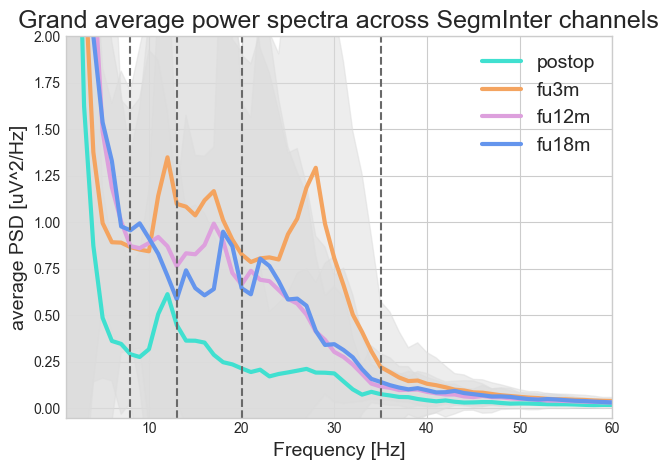

In [316]:
grand_average_power_spectra = power_spectra_plots.power_spectra_grand_average_per_session(
    incl_sub=["017", "019", "021", "024", "025", "026", "028", "029", "030", "031", "032", "033", "038"],
    channel_group="SegmInter",
    signalFilter="unfiltered",
    absolute_or_relative_psd="rawPsd"

)

In [317]:
grand_average_power_spectra

,session,frequencies,power_spectrum_grand_average,standard_deviation,sample_size
postop,postop,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[0.7604813740611109, 4.491046357253705, 3.5332...","[1.5672983044833104, 7.986632353382109, 7.0034...",54
fu3m,fu3m,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[0.9983364919416666, 5.898813345156943, 4.0419...","[1.6157836428961443, 6.724558404677458, 4.7425...",72
fu12m,fu12m,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[1.5126105328250001, 7.465063678118335, 6.5726...","[1.6324912383589587, 8.355013537421993, 6.6309...",60
fu18m,fu18m,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[1.833261018933333, 8.145119950686668, 5.41199...","[3.321255562046404, 13.576729394701067, 7.2669...",30


In [299]:
incl_sub=["017", "019", "021", "024", "025", "026", "028", "029", "030", "031", "032", "033", "038"]

sessions = ["postop", "fu3m", "fu12m", "fu18m"]
hemispheres = ["Right", "Left"]
channels = ['1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C']
signalFilter = "band-pass"

single_channels_dict = {}

for sub in incl_sub:

    for hem in hemispheres:

        # load all sessions and selected channel data per STN
        stn_power_spectra = mainAnalysis_class.MainClass(
                sub=sub,
                hemisphere=hem,
                filter=signalFilter,
                result="PowerSpectrum",
                incl_session=["postop", "fu3m", "fu12m", "fu18m"],
                pickChannels=channels,
                normalization=["rawPsd"],
                feature=["frequency", "time_sectors", 
                         "rawPsd", "SEM_rawPsd",
                         "normPsdToSum40to90Hz", "SEM_normPsdToSum40to90Hz"]
            )
        
        for ses in sessions:
            
            # check which sessions exist
            try:
                getattr(stn_power_spectra, ses)

            except AttributeError:
                continue

            for chan in channels: 
                    
                # get the power spectra and frequencies from each channel
                chan_data = getattr(stn_power_spectra, ses)
                chan_data = getattr(chan_data, f"BIP_{chan}")
                
                power_spectrum = np.array(chan_data.normPsdToSum40to90Hz.data)
                freqs = np.array(chan_data.frequency.data)

                # save all channels of an STN in a dict
                single_channels_dict[f"{sub}_{hem}_{ses}_{chan}"] = [sub, hem, ses, chan, power_spectrum, freqs]

# Dataframe with all single channels and their power_spectra + frequencies
single_channels_df = pd.DataFrame(single_channels_dict)
single_channels_df.rename(index={
    0: "subject",
    1: "hemisphere",
    2: "session",
    3: "bipolar_channel",
    4: "power_spectrum",
    5: "frequencies"
}, inplace=True)
single_channels_df = single_channels_df.transpose()

# join sub, hem columns together -> stn
single_channels_df["stn"] = single_channels_df[['subject', 'hemisphere']].agg('_'.join, axis=1)
single_channels_df.drop(columns=['subject', 'hemisphere'], inplace=True)


In [221]:
single_channels_df.head()

,session,bipolar_channel,power_spectrum,frequencies,stn
017_Right_fu3m_1A1B,fu3m,1A1B,"[0.1356575698, 0.0592348846, 0.0007178691, 0.0...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",017_Right
017_Right_fu3m_1B1C,fu3m,1B1C,"[0.1519677632, 0.0696418195, 0.0007569021, 0.0...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",017_Right
017_Right_fu3m_1A1C,fu3m,1A1C,"[0.1143966583, 0.0513627236, 0.0007740639, 0.0...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",017_Right
017_Right_fu3m_2A2B,fu3m,2A2B,"[0.0776135996, 0.0366194855, 0.0006963847, 0.0...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",017_Right
017_Right_fu3m_2B2C,fu3m,2B2C,"[0.0872686089, 0.038183133, 0.0012215945, 0.06...","[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...",017_Right


In [307]:
#session_df.power_spectrum.values

session_df.power_spectrum.count()

108

(-2.0, 80.0)

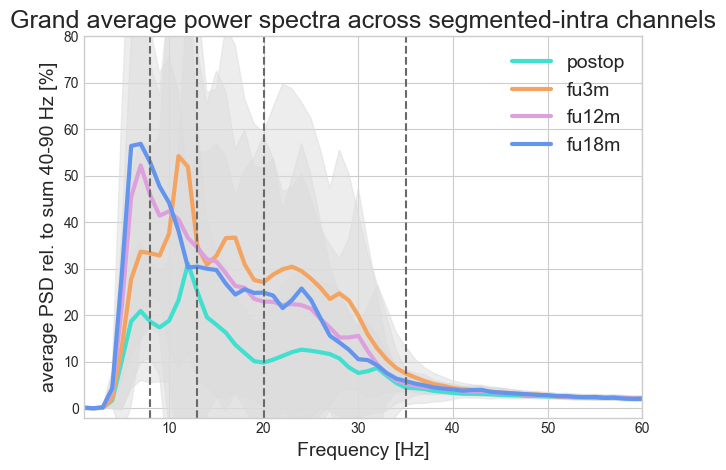

In [308]:
# Plot all power spectra in one figure, one color for each session

# 4 colors used for the cycle of matplotlib 
cycler_colors = cycler("color", ["turquoise", "sandybrown", "plum", "cornflowerblue"])
plt.rc('axes', prop_cycle=cycler_colors)

fig = plt.figure(layout="tight")

average_spectra = {}
sample_size = {}

for idx, ses in enumerate(sessions):

    session_df = single_channels_df.loc[single_channels_df.session==ses]

    frequencies = session_df.frequencies.values[0]

    power_spectrum_session_grand_average = np.mean(session_df.power_spectrum.values)
    standard_deviation_session = np.std(session_df.power_spectrum.values)

    average_spectra[f"{ses}"] = [frequencies, power_spectrum_session_grand_average, standard_deviation_session]
    sample_size[f"{ses}"] = len(session_df.power_spectrum.values)


    plt.plot(frequencies, power_spectrum_session_grand_average, label=ses, linewidth=3)

    plt.fill_between(frequencies, 
                 power_spectrum_session_grand_average-standard_deviation_session,
                 power_spectrum_session_grand_average+standard_deviation_session,
                 color="gainsboro", alpha=0.5)


plt.title("Grand average power spectra across segmented-intra channels", fontdict={"size": 18})
plt.legend(loc= 'upper right', fontsize=14)

# add lines for freq Bands
plt.axvline(x=8, color='dimgrey', linestyle='--')
plt.axvline(x=13, color='dimgrey', linestyle='--')
plt.axvline(x=20, color='dimgrey', linestyle='--')
plt.axvline(x=35, color='dimgrey', linestyle='--')

plt.xlabel("Frequency [Hz]", fontdict={"size": 14})
plt.xlim(1, 60)
plt.ylabel("average PSD rel. to sum 40-90 Hz [%]", fontdict={"size": 14})
plt.ylim(-2, 80)




In [310]:
sample_size["fu3m"]

144

In [247]:
average_spectra["postop"][2]

array([1.05272534e-01, 4.56564473e-02, 2.53438648e-03, 1.99256867e-01,
       1.74414185e+00, 1.04803500e+01, 1.45195800e+01, 1.49244203e+01,
       1.31958929e+01, 1.16722779e+01, 1.31227686e+01, 3.12350082e+01,
       6.22828593e+01, 3.56053143e+01, 2.08532213e+01, 1.57384085e+01,
       1.42291711e+01, 1.04504769e+01, 9.44234404e+00, 8.27861826e+00,
       9.49307840e+00, 1.25513364e+01, 1.52539174e+01, 1.65596424e+01,
       1.66598105e+01, 1.37364566e+01, 1.52426115e+01, 1.49846924e+01,
       1.46658103e+01, 1.11549374e+01, 9.84834387e+00, 1.39488446e+01,
       1.77767198e+01, 1.27390834e+01, 7.05225104e+00, 3.81950276e+00,
       3.28163910e+00, 3.07328288e+00, 2.36429187e+00, 2.04440032e+00,
       1.44238632e+00, 8.77571880e-01, 9.42701841e-01, 9.09058614e-01,
       1.02162696e+00, 7.60907039e-01, 7.84993732e-01, 7.51651937e-01,
       5.81537397e-01, 5.61490286e-01, 5.40102234e-01, 5.20649419e-01,
       5.83633129e-01, 4.91723346e-01, 5.29004045e-01, 5.14957711e-01,
      

Text(0, 0.5, 'grand average PSD to sum 40-90 Hz[%]')

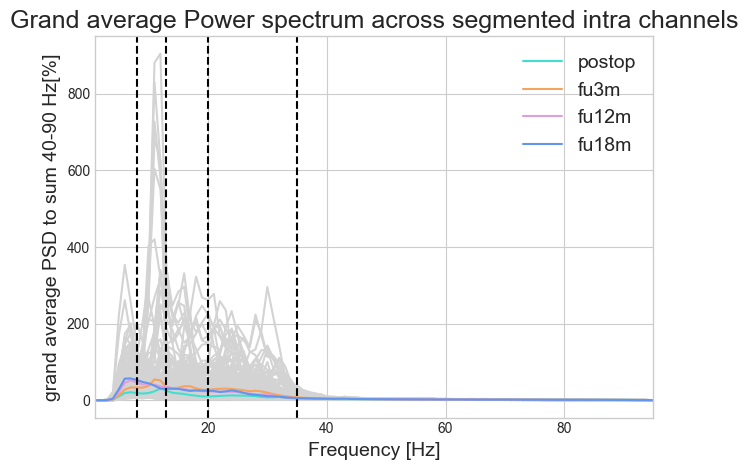

In [244]:
# Plot all power spectra in one figure, one color for each session

# 4 colors used for the cycle of matplotlib 
cycler_colors = cycler("color", ["turquoise", "sandybrown", "plum", "cornflowerblue"])
plt.rc('axes', prop_cycle=cycler_colors)

fig = plt.figure(layout="tight")

average_spectra = {}

for idx, ses in enumerate(sessions):

    session_df = single_channels_df.loc[single_channels_df.session==ses]

    frequencies = session_df.frequencies.values[0]

    # plot each single channel power spectrum in light grey
    for s, spectrum in enumerate(list(session_df.power_spectrum.values)):

        plt.plot(frequencies, spectrum, color="lightgray")

    power_spectrum_session_grand_average = np.mean(session_df.power_spectrum.values)
    standard_deviation_session = np.std(session_df.power_spectrum.values)

    average_spectra[f"{ses}"] = [frequencies, power_spectrum_session_grand_average, standard_deviation_session]

# plot the grand average in color on top of the grey single channels
for session in sessions:
        
    plt.plot(average_spectra[f"{session}"][0], 
             average_spectra[f"{session}"][1], label=session, )
    #plt.fill_between(frequencies, 
                #  power_spectrum_session_grand_average-standard_deviation_session,
                #  power_spectrum_session_grand_average+standard_deviation_session,
                #  color="lightgray", alpha=0.5)


        
   


plt.title("Grand average Power spectrum across segmented intra channels", fontdict={"size": 18})
plt.legend(loc= 'upper right', edgecolor="black", fontsize=14)

# add lines for freq Bands
plt.axvline(x=8, color='black', linestyle='--')
plt.axvline(x=13, color='black', linestyle='--')
plt.axvline(x=20, color='black', linestyle='--')
plt.axvline(x=35, color='black', linestyle='--')

plt.xlabel("Frequency [Hz]", fontdict={"size": 14})
plt.xlim(1, 95)
plt.ylabel("grand average PSD to sum 40-90 Hz[%]", fontdict={"size": 14})





## 1. Calculate PSD averages of Beta, High Beta and Low Beta

Creating RawArray with float64 data, n_channels=6, n_times=5288
    Range : 0 ... 5287 =      0.000 ...    21.148 secs
Ready.
Creating RawArray with float64 data, n_channels=6, n_times=5288
    Range : 0 ... 5287 =      0.000 ...    21.148 secs
Ready.
Creating RawArray with float64 data, n_channels=3, n_times=5313
    Range : 0 ... 5312 =      0.000 ...    21.248 secs
Ready.


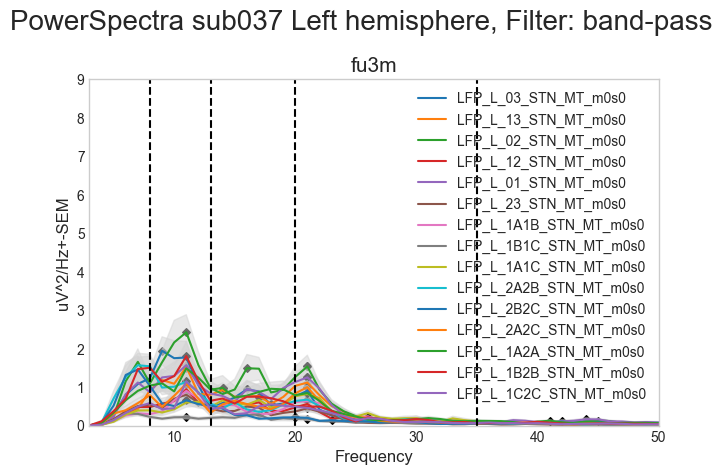

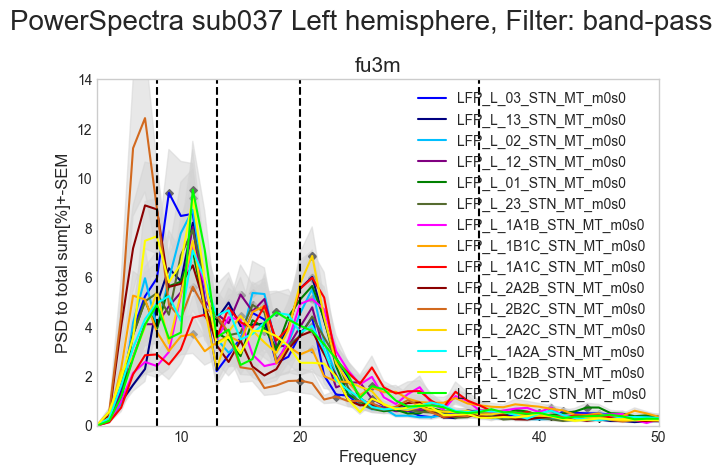

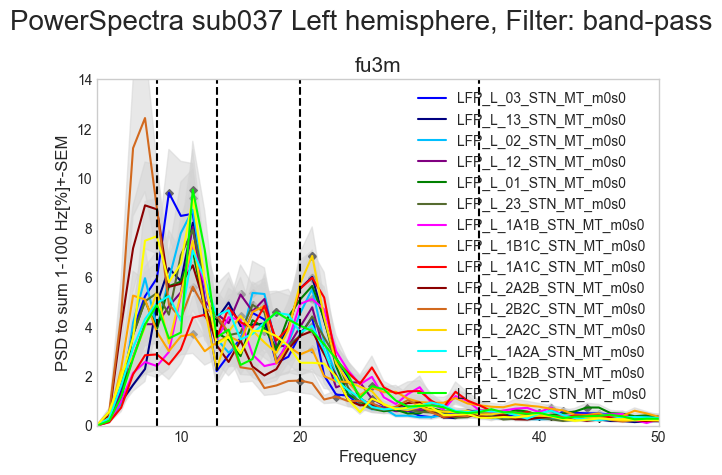

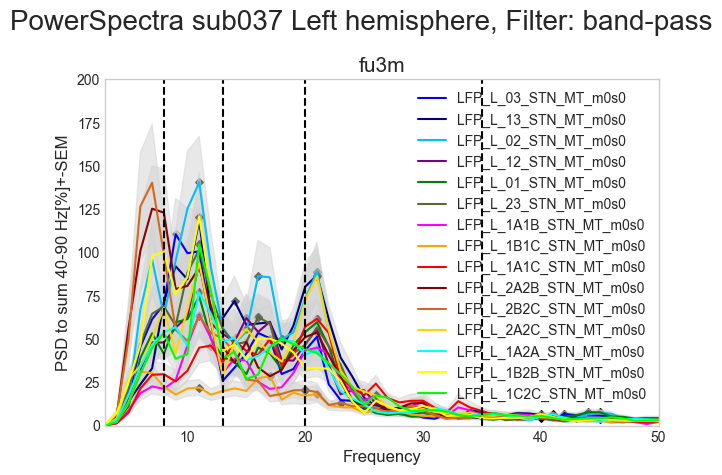

In [11]:
# plot Spectrograms if only one session is available
FF_psd = FFpsd.spectrogram_Psd_onlyONEsession(
    incl_sub = "037", 
    incl_session = ["fu3m"],
    incl_condition = ["m0s0"],
    pickChannels=['03', '13', '02', '12', '01', '23',
                  '1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C',
                  '1A2A', '1B2B', '1C2C'],
    hemisphere="Left",
    filter = "band-pass"
)


	### WARNING: NaNs in Metadata Table sub-024 ###
NaNs in: sub024_ses-2021061806255999_run-BrainSense20210618063700.mat
NaNs in: sub024_ses-2021061806255999_run-BrainSense20210618064000.mat
NaNs in: sub024_ses-2021061806255999_run-BrainSense20210618064200.mat
NaNs in: sub024_ses-2021061808253999_run-BrainSense20210618084000.mat
NaNs in: sub024_ses-2021061808253999_run-BrainSense20210618084300.mat
NaNs in: sub024_ses-2021061808253999_run-BrainSense20210618084700.mat
NaNs in: sub024_ses-2021092106385396_run-BrainSense20210921070500.mat
NaNs in: sub024_ses-2021092106385396_run-BrainSense20210921072300.mat
NaNs in: sub024_ses-2021092107452096_run-BrainSense20210921074800.mat
NaNs in: sub024_ses-2021092107452096_run-BrainSense20210921080600.mat
NaNs in: sub024_ses-2021092107452096_run-BrainSense20210921082400.mat
NaNs in: sub-20210615PStn_ses-2022061010445782_run-BrainSense20220610105800.mat
NaNs in: sub-20210615PStn_ses-2022061010445782_run-BrainSense20220610111500.mat
NaNs in: sub-2021061

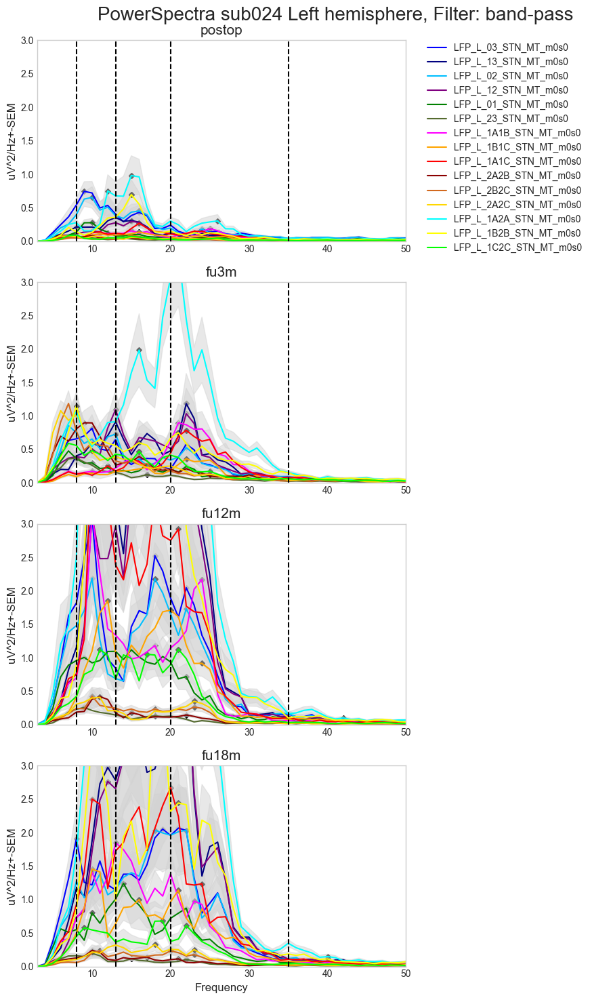

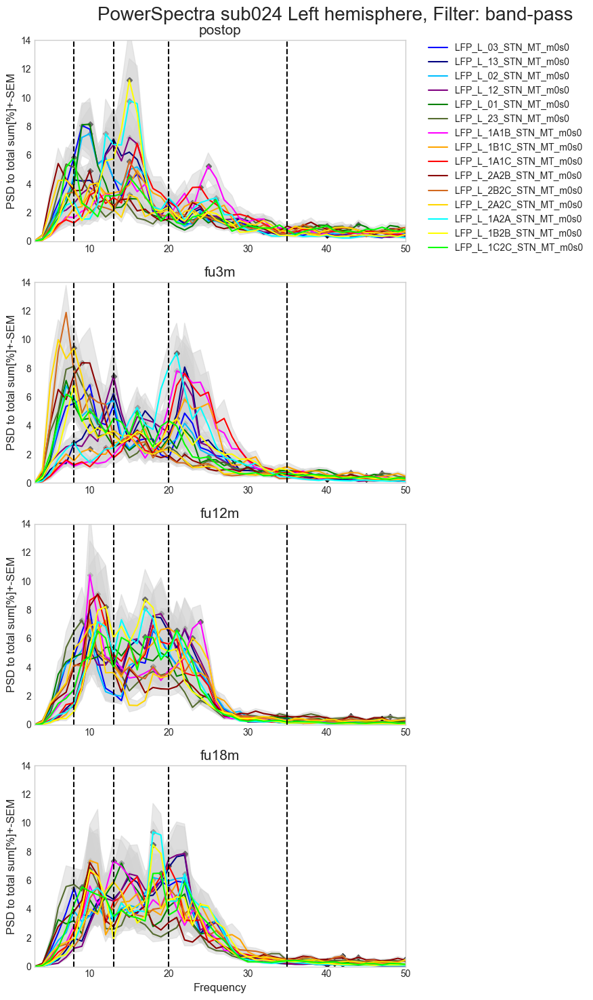

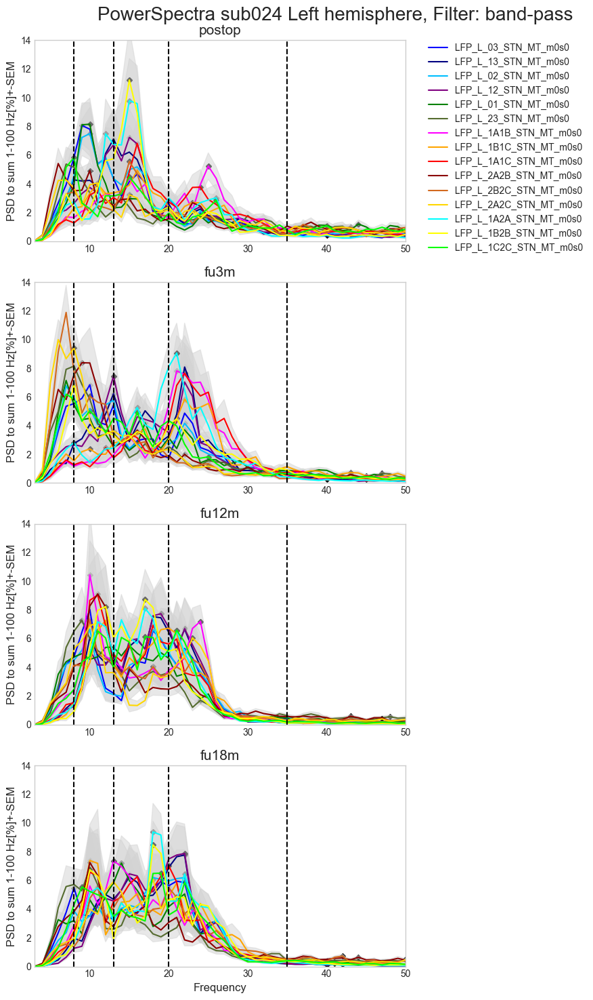

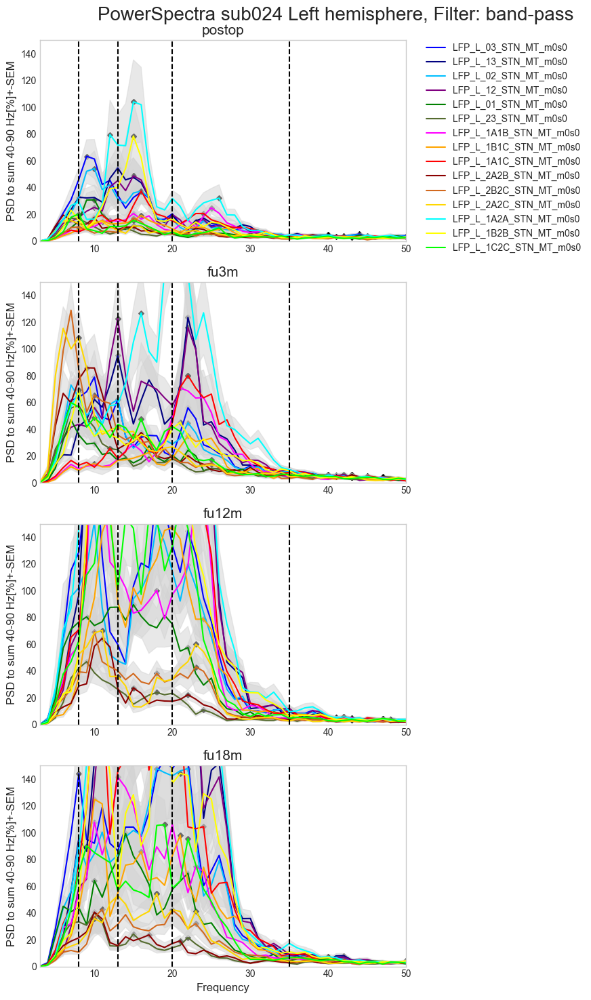

In [15]:
FF_psd_sub024 = FFpsd.spectrogram_Psd(
    incl_sub = "024", 
    incl_session = ["postop","fu3m", "fu12m", "fu18m"],
    incl_condition = ["m0s0"],
    pickChannels=['03', '13', '02', '12', '01', '23',
                  '1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C',
                  '1A2A', '1B2B', '1C2C'],
    hemisphere="Left",
    filter = "band-pass")

In [17]:
FF_psd_sub024['PSD_Dataframe']

,condition,session,bipolarChannel,frequency,time_sectors,rawPsd,SEM_rawPsd,normPsdToTotalSum,SEM_normPsdToTotalSum,normPsdToSumPsd1to100Hz,SEM_normPsdToSumPsd1to100Hz,normPsdToSum40to90Hz,SEM_normPsdToSum40to90Hz
postop_LFP_L_03_STN_MT_m0s0,m0s0,postop,LFP_L_03_STN_MT,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, ...","[0.0012517512059757035, 0.0005638832365526168,...","[0.00030325641223891283, 0.0001373124633716784...","[0.013556180529326483, 0.00610672705220989, 0....","[0.0032841978912112593, 0.0014870627114292015,...","[0.013558269038134335, 0.00610766787423628, 0....","[0.003284703865309766, 0.0014872918130971774, ...","[0.10661506653088527, 0.04802747422467838, 0.0...","[0.025829176287126204, 0.011695277262768937, 0..."
postop_LFP_L_13_STN_MT_m0s0,m0s0,postop,LFP_L_13_STN_MT,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, ...","[0.0007294373844140162, 0.00032988640804954033...","[0.00016609809185421647, 7.466373089213566e-05...","[0.014630874905040754, 0.006616780099532984, 0...","[0.003331554504623103, 0.00149758667428874, 6....","[0.014633426395092264, 0.006617934005140582, 0...","[0.00333213549709483, 0.0014978478396343205, 6...","[0.11254949868946384, 0.05090025633971365, 0.0...","[0.025628323103409848, 0.011520338361798709, 0..."
postop_LFP_L_02_STN_MT_m0s0,m0s0,postop,LFP_L_02_STN_MT,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, ...","[0.0011451601872766082, 0.000523312363088677, ...","[0.00024940477991153005, 0.0001179898372729496...","[0.013141432345086615, 0.006005338022824684, 0...","[0.0028620764834159534, 0.0013540074839815557,...","[0.013143419942737475, 0.00600624631009759, 0....","[0.0028625093629031846, 0.0013542122730809277,...","[0.09492816135169872, 0.04338002752153085, 0.0...","[0.020674432670970876, 0.009780778649966985, 0..."
postop_LFP_L_12_STN_MT_m0s0,m0s0,postop,LFP_L_12_STN_MT,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, ...","[0.0006588068450597938, 0.00031103995122979934...","[0.00014380345907058864, 6.895205921569005e-05...","[0.016038106512179302, 0.007572009770046967, 0...","[0.0035007760023874563, 0.0016785807224497836,...","[0.016041332692398824, 0.007573532934151384, 0...","[0.0035014802086030285, 0.0016789183810081384,...","[0.10820788309124811, 0.051087773194473884, 0....","[0.023619469050621414, 0.011325256284844801, 0..."
postop_LFP_L_01_STN_MT_m0s0,m0s0,postop,LFP_L_01_STN_MT,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, ...","[0.0003647006090892686, 0.00016245143823744222...","[8.812976167160638e-05, 3.741262968107717e-05,...","[0.010750288569565074, 0.004788584927111848, 0...","[0.002597803090876829, 0.0011028129791782397, ...","[0.010751928796792298, 0.004789315546325137, 0...","[0.002598199451154328, 0.0011029812410684467, ...","[0.0407499370579814, 0.018151562454709145, 0.0...","[0.009847206589594194, 0.004180311923483218, 0..."
postop_LFP_L_23_STN_MT_m0s0,m0s0,postop,LFP_L_23_STN_MT,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, ...","[0.00038864649570528274, 0.0001690332229678891...","[0.00011182033123555566, 4.945104624944279e-05...","[0.026883697579054386, 0.011692471429171392, 0...","[0.00773490563106988, 0.003420658585703495, 8....","[0.026892562116902063, 0.011696326864429578, 0...","[0.007737456112212333, 0.003421786501884212, 8...","[0.08630873569210004, 0.03753808132978118, 0.0...","[0.024832518806322198, 0.01098184938653741, 0...."
postop_LFP_L_1A1B_STN_MT_m0s0,m0s0,postop,LFP_L_1A1B_STN_MT,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, ...","[0.0003848104252172832, 0.00018547012094047278...","[0.0001330842922927137, 6.721616374492988e-05,...","[0.010734045724253516, 0.005173572824940317, 7...","[0.0037123

In [95]:
FF_psd_sub024["averagedPSD_unfiltered"]

,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD
postop_LFP_R_03_STN_MT_psdAverage_rawPsd_alpha,postop,LFP_R_03_STN_MT,alpha,rawPsd,0.223263
postop_LFP_R_03_STN_MT_psdAverage_rawPsd_lowBeta,postop,LFP_R_03_STN_MT,lowBeta,rawPsd,0.079083
postop_LFP_R_03_STN_MT_psdAverage_rawPsd_highBeta,postop,LFP_R_03_STN_MT,highBeta,rawPsd,0.040406
postop_LFP_R_03_STN_MT_psdAverage_rawPsd_beta,postop,LFP_R_03_STN_MT,beta,rawPsd,0.053859
postop_LFP_R_03_STN_MT_psdAverage_rawPsd_narrowGamma,postop,LFP_R_03_STN_MT,narrowGamma,rawPsd,0.01173
...,...,...,...,...,...
fu18m_LFP_R_1C2C_STN_MT_psdAverage_normPsdToSum40_90Hz_alpha,fu18m,LFP_R_1C2C_STN_MT,alpha,normPsdToSum40_90Hz,21.325513
fu18m_LFP_R_1C2C_STN_MT_psdAverage_normPsdToSum40_90Hz_lowBeta,fu18m,LFP_R_1C2C_STN_MT,lowBeta,normPsdToSum40_90Hz,12.79742
fu18m_LFP_R_1C2C_STN_MT_psdAverage_normPsdToSum40_90Hz_highBeta,fu18m,LFP_R_1C2C_STN_MT,highBeta,normPsdToSum40_90Hz,10.636081
fu18m_LFP_R_1C2C_STN_MT_psdAverage_normPsdToSum40_90Hz_beta,fu18m,LFP_R_1C2C_STN_MT,beta,normPsdToSum40_90Hz,11.387851


In [108]:
path = find_folders.get_local_path(folder="GroupResults")

In [55]:
dictionary = {"key": "value"}
dictionary["key"]

'value'

In [31]:
filepath = os.path.join("c:\\Users\\jebe12\\Research\\Longterm_beta_project\\results", "pickleFile")

# "wb" write bytes: pickle files can not be opened visually, it can only be opened by code
# pickle will save the output code as it is, so Dataframes can be saved just as they are

with open(filepath, "wb") as file: 
    pickle.dump(averagePSD_DF, file)

In [32]:
with open(filepath, "rb") as file:
    new_tfr = pickle.load(file)

In [100]:
data = loadcsv.load_PSDjson(
    sub="029",
    psdMethod = "Spectrogram",
    hemisphere="Left",
    filter = "band-pass"
    
)

## 2. Plot Channels seperately to visualize the development over time of each channel

In [6]:
data = mainAnalysis_class.MainClass(
    sub="029",
    hemisphere = "Left",
    filter = "band-pass",
    result = "PowerSpectrum",
    incl_session = ["postop", "fu3m", "fu12m", "fu18m"],
    pickChannels = ['03', '13', '02', '12', '01', '23', 
                    '1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C', 
                    '1A2A', '1B2B', '1C2C'],
    normalization = ["rawPsd", "normPsdToTotalSum", "normPsdToSum40_90Hz"],
    freqBands= None,
    feature = ["frequency", "rawPsd", "SEM_rawPsd", "normPsdToTotalSum", "SEM_normPsdToTotalSum",
               "normPsdToSum40to90Hz", "SEM_normPsdToSum40to90Hz"],
    
)

Create three groups: Ring, SegmInter, SegmIntra
- 1. for each group plot the PSD average of each channel over time (x=session, y=PSD average), average PSD over channels within a group (+- standard deviation)
- 2. each group is a column, plot one channel per Row, within one subplot: Power spectrum of one channel at different timepoints

In [21]:
data.postop.BIP_02.Result_DF

,session,bipolarChannel,frequency,time_sectors,rawPsd,SEM_rawPsd,normPsdToTotalSum,SEM_normPsdToTotalSum,normPsdToSumPsd1to100Hz,SEM_normPsdToSumPsd1to100Hz,normPsdToSum40to90Hz,SEM_normPsdToSum40to90Hz
postop_LFP_R_02_STN_MT,postop,LFP_R_02_STN_MT,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, ...","[0.0006976286, 0.0003060708, 1.23665e-05, 0.00...","[0.0001819614, 7.87827e-05, 1.9813e-06, 0.0001...","[0.0253695146, 0.0111303744, 0.0004497125, 0.0...","[0.0066170901, 0.0028649602, 7.20522e-05, 0.00...","[0.0253771084, 0.011133706, 0.0004498471, 0.02...","[0.0066190708, 0.0028658177, 7.20738e-05, 0.00...","[0.1244728751, 0.0546100201, 0.0022064676, 0.1...","[0.0324660618, 0.0140566279, 0.0003535168, 0.0..."


Plot each channel in a seperate subplot with all timepoints
- visually compare the development over time of each single channel 

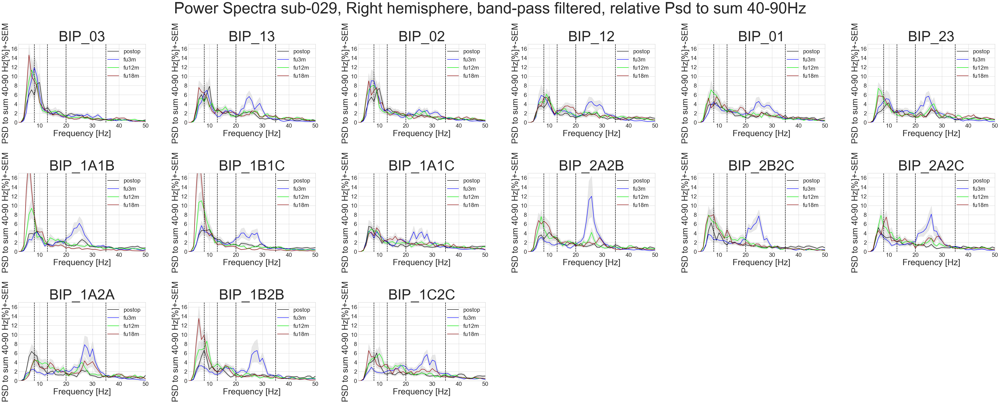

In [20]:
timepoints = ["postop", "fu3m", "fu12m", "fu18m"]

Ring = ['BIP_03', 'BIP_13', 'BIP_02', 'BIP_12', 'BIP_01', 'BIP_23']
SegmIntra = ['BIP_1A1B', 'BIP_1B1C', 'BIP_1A1C', 'BIP_2A2B', 'BIP_2B2C', 'BIP_2A2C']
SegmInter = ['BIP_1A2A', 'BIP_1B2B', 'BIP_1C2C']

groupChannels = ["Ring", "SegmIntra", "SegmInter"]

plt.style.use('seaborn-whitegrid')
fig = plt.figure(figsize= (50, 20), layout="tight")

# Create a list of 15 colors and add it to the cycle of matplotlib 
cycler_colors = cycler("color", ["black", "blue", "lime", "darkred"])
plt.rc('axes', prop_cycle=cycler_colors)


for g, group in enumerate(groupChannels):

    # loop through Ring, SegmIntra, SegmInter each will create a row (rows n=3)
    # eval(group) gives takes from the string "Ring" the variable Ring, so we can loop through the list Ring 
    for c, chan in enumerate(eval(group)):

        # subplot layout: one row for each group, max. 6 columns, if 6 BIP channels, index from left to right 1-16
        if group == "Ring":

            plt.subplot(3, 6, c+1, label=chan)
        
        elif group == "SegmIntra":
            plt.subplot(3, 6, c+7, label=chan,)
        
        elif group == "SegmInter":
            plt.subplot(3, 6, c+13, label=chan)

        else: 
            print("group must be Ring, SegmIntra or SegmInter")


        for tp in timepoints:
            PowerSpectrum = getattr(data, tp)
            PowerSpectrum = getattr(PowerSpectrum, chan)

            f = PowerSpectrum.frequency.data
            psd = np.array(PowerSpectrum.normPsdToTotalSum.data)
            sem = np.array(PowerSpectrum.SEM_normPsdToTotalSum.data)

            plt.title(f"{chan}", fontdict={"size": 50})
            plt.plot(f, psd, label = f"{tp}")
            plt.fill_between(f, psd-sem, psd+sem, color="lightgray", alpha=0.5)

            # add lines for freq Bands
            plt.axvline(x=8, color='black', linestyle='--')
            plt.axvline(x=13, color='black', linestyle='--')
            plt.axvline(x=20, color='black', linestyle='--')
            plt.axvline(x=35, color='black', linestyle='--')

            plt.xlabel("Frequency [Hz]", fontdict={"size": 30})
            # plt.ylim(0, 20) # for rel PSD to sum 1-100Hz
            # plt.ylim(0, 4) # for absolute PSD
            # plt.ylim(0, 150) # for rel PSD to sum 40-90Hz
            plt.ylim(0, 17) # for rel PSD to sum 40-90Hz
            plt.xlim(2, 50)
            plt.ylabel("PSD to sum 40-90 Hz[%]+-SEM", fontdict={"size": 30})
            plt.xticks(fontsize= 20), plt.yticks(fontsize= 20)
            plt.legend(loc= 'upper right', edgecolor="black", fontsize=20)

fig.suptitle("Power Spectra sub-029, Right hemisphere, band-pass filtered, relative Psd to sum 40-90Hz", fontsize=55, y=1.02)
fig.subplots_adjust(wspace=40, hspace=60)

#plt.tight_layout(pad=10, w_pad=10, h_pad=10)

plt.show()





Automatized code to plot each channel of one subject hemisphere in seperate subplots including all timepoints

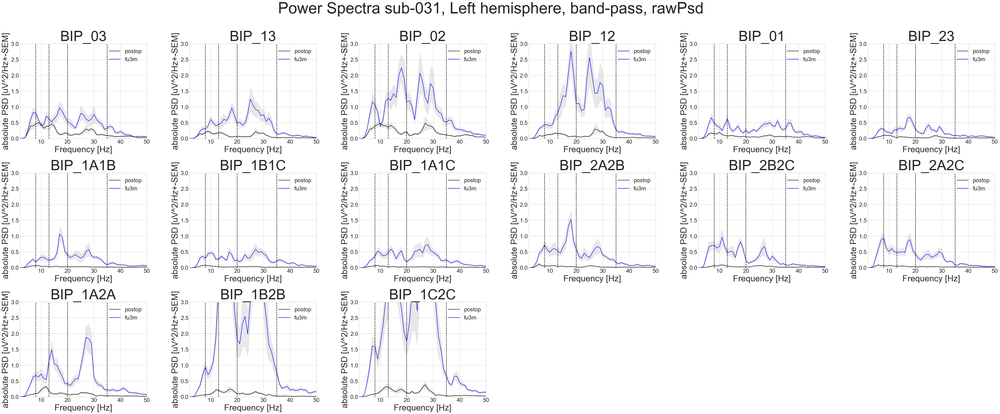

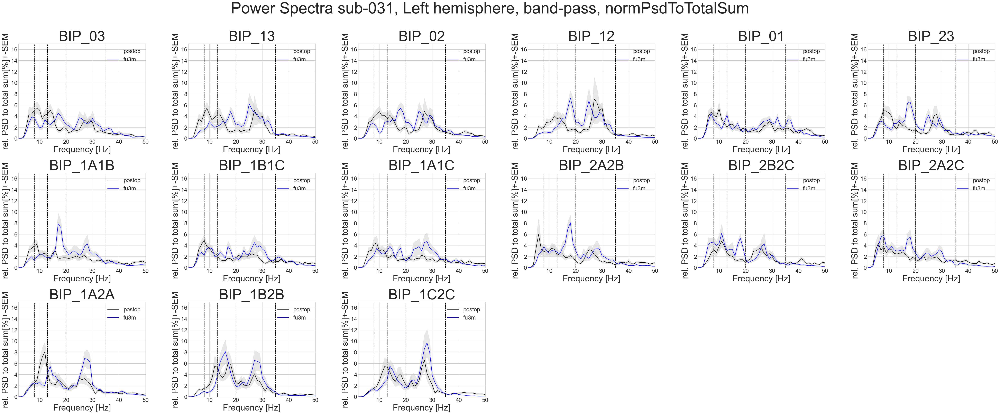

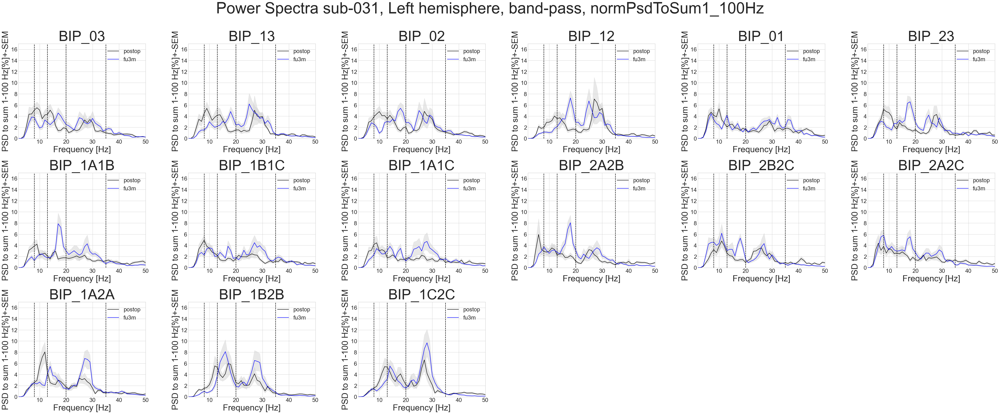

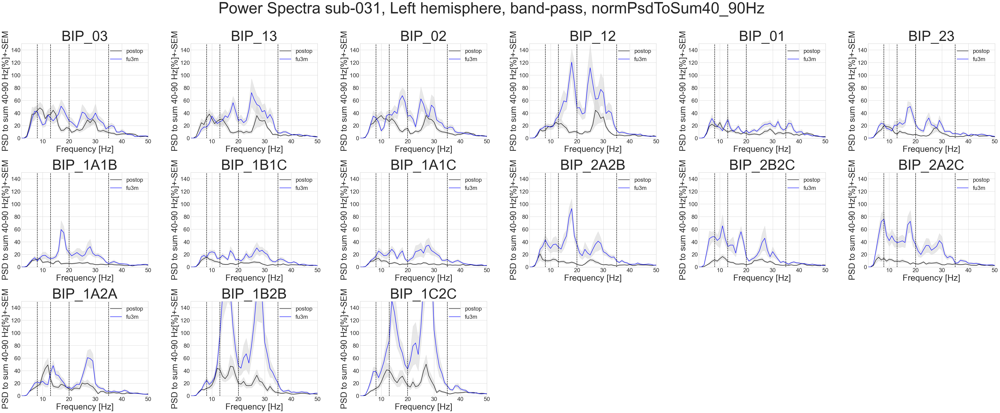

In [18]:

PowerSpectra_perChannels = PowerSpectraChannels.PowerSpectra_perChannel(
    sub="031",
    hemisphere="Left",
    incl_session=["postop", "fu3m"],
    signalFilter="band-pass",
    normalization=["rawPsd", "normPsdToTotalSum", "normPsdToSum1_100Hz", "normPsdToSum40_90Hz"]

)

In [ ]:
# RING: 6 Channels row1
plt.subplot(3, 6, 1) # row 1, column 1, count 1
plt.subplot(3, 6, 2) # row 1, column 2, count 1
plt.subplot(3, 6, 3) # row 1, column 2, count 1
plt.subplot(3, 6, 4) # row 1, column 2, count 1
plt.subplot(3, 6, 5) # row 1, column 2, count 1
plt.subplot(3, 6, 6) # row 1, column 2, count 1

# SegmIntra: 6 Channels row2
plt.subplot(3, 6, 7) # row 1, column 2, count 1
plt.subplot(3, 6, 8) # row 1, column 2, count 1
plt.subplot(3, 6, 9) # row 1, column 2, count 1
plt.subplot(3, 6, 10) # row 1, column 2, count 1
plt.subplot(3, 6, 11) # row 1, column 2, count 1
plt.subplot(3, 6, 12) # row 1, column 2, count 1

# SegmInter: 3 Channels row3
plt.subplot(3, 6, 13) # row 1, column 2, count 1
plt.subplot(3, 6, 14) # row 1, column 2, count 1
plt.subplot(3, 6, 15) # row 1, column 2, count 1

In [10]:
from ast import literal_eval

## 2a. Normalize each bipolar channel to Postop or 3MFU and plot over time for each channel

Use automatized method for plotting normalized PSD to Postop and 3MFU

TODO: statistical analysis -> Friedman or ANOVA test of paired groups?

new files:  normalizedToPostop_rawPsd_beta.pickle 
and: normalizedToFu3m_rawPsd_beta.pickle 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\results 
new figure: relativeTo_Fu3m_rawPsd_beta_barplot_plotPerBipolarChannel.png 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\figures


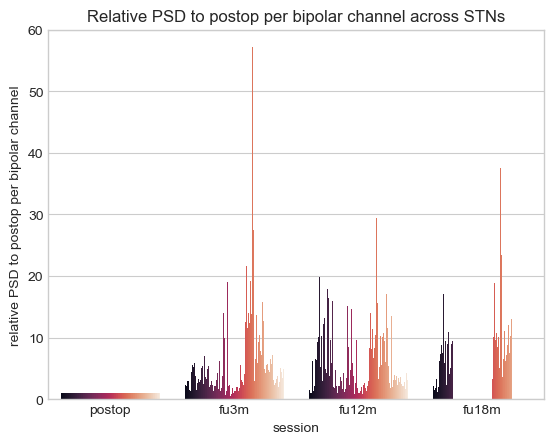

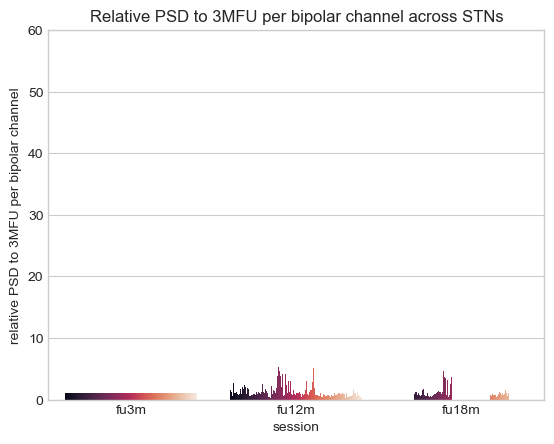

In [18]:
plotNormalizedPSD_perChannel = BIP_perChannel.BIP_channelNormalizedToSession(
    incl_sub=["017", "019", "024", "025", "026", "029", "030"],
    normalization="rawPsd",
    freqBand="beta",
    plot="plotPerBipolarChannel"
)

In [142]:
data.postop.BIP_01.rawPsd.beta.averagedPSD.data

0.2753179488

In [24]:
incl_sub =  ["017", "019", "024", "025", "026", "029", "030"]
hemispheres = ["Right", "Left"]
normalization = "rawPsd"
freqBand = "beta"
sessions = ["fu3m", "fu12m", "fu18m"]
BIP_channels = ['BIP_03', 'BIP_13', 'BIP_02', 'BIP_12', 'BIP_01', 'BIP_23', 
                'BIP_1A1B', 'BIP_1B1C', 'BIP_1A1C', 'BIP_2A2B', 'BIP_2B2C', 'BIP_2A2C',
                'BIP_1A2A', 'BIP_1B2B', 'BIP_1C2C']


normalized_psd_Dict = {}

for sub in incl_sub:
    for hem in hemispheres:

        sub_hem_data = mainAnalysis_class.MainClass(
            sub=sub,
            hemisphere=hem,
            filter="band-pass",
            result="PSDaverageFrequencyBands",
            incl_session=["postop", "fu3m", "fu12m", "fu18m"],
            pickChannels=['03', '13', '02', '12', '01', '23', 
                            '1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C', 
                            '1A2A', '1B2B', '1C2C'],
            normalization=[normalization],
            freqBands=["beta", "lowBeta", "highBeta"],
            feature=["averagedPSD"]
        )

        # for every channel get PSD for each session and normalize to postop
        for c, chan in enumerate(BIP_channels):

            # check if postop exists 
            try:
                getattr(sub_hem_data, "postop")
            
            except AttributeError:
                continue

            # first get postop PSD
            postop_PSD = getattr(sub_hem_data.postop, chan)
            postop_PSD = getattr(postop_PSD, normalization)
            postop_PSD = getattr(postop_PSD, freqBand)
            postop_PSD = postop_PSD.averagedPSD.data

            normalized_postop = postop_PSD/postop_PSD

            # store in dictionary
            normalized_psd_Dict[f"{sub}_{hem}_{chan}_postop"] = [sub, hem, "postop", chan, normalized_postop]

            # normalize all other session PSD values to postop PSD
            for ses in sessions:

                # check if session exists
                try: 
                    getattr(sub_hem_data, ses)
                
                except AttributeError:
                    continue

                session_PSD = getattr(sub_hem_data, ses)
                session_PSD = getattr(session_PSD, chan)
                session_PSD = getattr(session_PSD, normalization)
                session_PSD = getattr(session_PSD, freqBand)
                session_PSD = session_PSD.averagedPSD.data

                normalized_session_PSD = session_PSD/postop_PSD
                
                # store in dictionary
                normalized_psd_Dict[f"{sub}_{hem}_{chan}_{ses}"] = [sub, hem, ses, chan, normalized_session_PSD]







In [64]:
normalized_psd_Dataframe = pd.DataFrame(normalized_psd_Dict)
normalized_psd_Dataframe.rename(index={0: "subject", 1: "hemisphere", 2: "session", 3: "bipolarChannel", 4: "beta_Psd_normalized_to_postop"}, inplace=True)
normalized_psd_Dataframe = normalized_psd_Dataframe.transpose()
normalized_psd_Dataframe["subject_hemisphere"] = normalized_psd_Dataframe[["subject", "hemisphere"]].agg('_'.join, axis=1)
normalized_psd_Dataframe["subject_hemisphere_BIPchannel"] = normalized_psd_Dataframe[["subject", "hemisphere", "bipolarChannel"]].agg('_'.join, axis=1)
normalized_psd_Dataframe.drop(["subject", "hemisphere", "bipolarChannel"], axis=1, inplace=True)
normalized_psd_Dataframe

,session,beta_Psd_normalized_to_postop,subject_hemisphere,subject_hemisphere_BIPchannel
024_Right_BIP_03_postop,postop,1.0,024_Right,024_Right_BIP_03
024_Right_BIP_03_fu3m,fu3m,2.178214,024_Right,024_Right_BIP_03
024_Right_BIP_03_fu12m,fu12m,0.912131,024_Right,024_Right_BIP_03
024_Right_BIP_03_fu18m,fu18m,1.525136,024_Right,024_Right_BIP_03
024_Right_BIP_13_postop,postop,1.0,024_Right,024_Right_BIP_13
...,...,...,...,...
030_Left_BIP_1B2B_fu3m,fu3m,6.574167,030_Left,030_Left_BIP_1B2B
030_Left_BIP_1B2B_fu12m,fu12m,3.229433,030_Left,030_Left_BIP_1B2B
030_Left_BIP_1C2C_postop,postop,1.0,030_Left,030_Left_BIP_1C2C
030_Left_BIP_1C2C_fu3m,fu3m,4.885436,030_Left,030_Left_BIP_1C2C


In [ ]:
describe_arrays = {}



Text(0, 0.5, 'Beta PSD rel. to postop per bipolar channel')

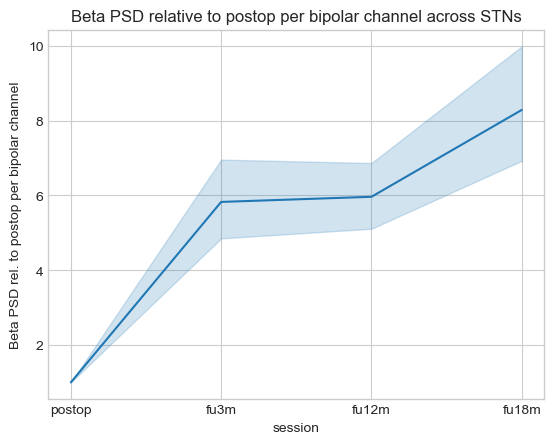

In [46]:
fig = plt.figure()

ax = sns.lineplot(data=normalized_psd_Dataframe, x="session", y="beta_Psd_normalized_to_postop")
plt.title("Beta PSD relative to postop per bipolar channel across STNs")
plt.ylabel("Beta PSD rel. to postop per bipolar channel")

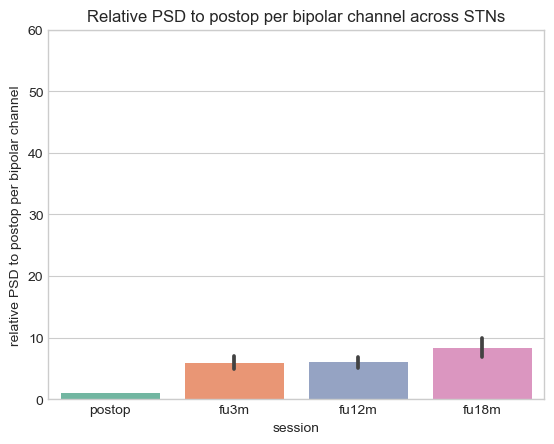

In [77]:
fig = plt.figure()

ax = sns.barplot(data=normalized_psd_Dataframe, x="session", y="beta_Psd_normalized_to_postop", palette="Set2")
plt.title("Relative PSD to postop per bipolar channel across STNs")
plt.ylabel("relative PSD to postop per bipolar channel")
plt.ylim(0, 60)

figures_path = find_folders.get_local_path(folder="GroupFigures")
fig.savefig(figures_path + f"\\relativeTo_Postop_rawPSD_beta_barplot.png", bbox_inches="tight")

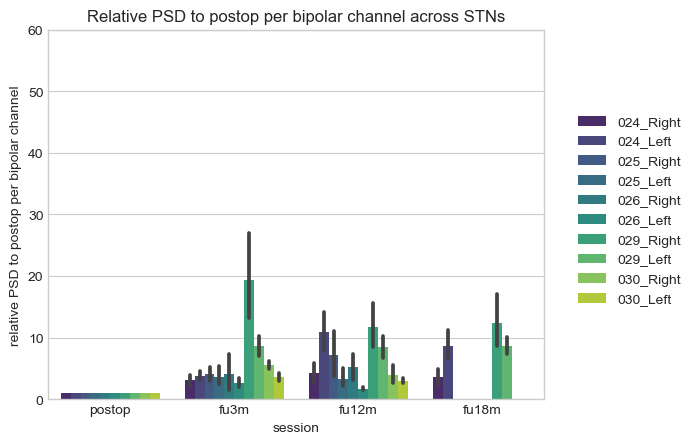

In [76]:
fig = plt.figure()

ax = sns.barplot(data=normalized_psd_Dataframe, x="session", y="beta_Psd_normalized_to_postop", hue="subject_hemisphere", palette="viridis")
plt.legend(loc="upper right", bbox_to_anchor=(1.3, 0.8))
plt.title("Relative PSD to postop per bipolar channel across STNs")
plt.ylabel("relative PSD to postop per bipolar channel")
plt.ylim(0, 60)

figures_path = find_folders.get_local_path(folder="GroupFigures")
fig.savefig(figures_path + f"\\relativeTo_Postop_rawPSD_beta_barplot_perSTN.png", bbox_inches="tight")



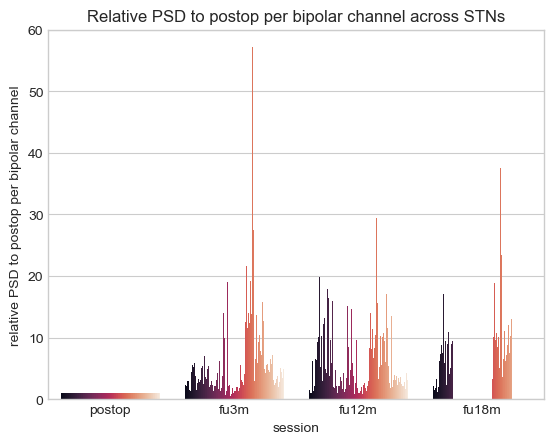

In [75]:
fig = plt.figure()

ax = sns.barplot(data=normalized_psd_Dataframe, x="session", y="beta_Psd_normalized_to_postop", hue="subject_hemisphere_BIPchannel", palette="rocket")
# plt.legend(loc="upper right", bbox_to_anchor=(1.3, 0.8))
ax.get_legend().remove()
plt.title("Relative PSD to postop per bipolar channel across STNs")
plt.ylabel("relative PSD to postop per bipolar channel")
plt.ylim(0, 60)

figures_path = find_folders.get_local_path(folder="GroupFigures")
fig.savefig(figures_path + f"\\relativeTo_Postop_rawPSD_beta_barplot_perSTN_BIPchannel.png", bbox_inches="tight")

Normalize to 3MFU

In [17]:
incl_sub =  ["017", "019", "024", "025", "026", "029", "030"]
hemispheres = ["Right", "Left"]
normalization = "rawPsd"
freqBand = "beta"
sessions = ["fu12m", "fu18m"]
BIP_channels = ['BIP_03', 'BIP_13', 'BIP_02', 'BIP_12', 'BIP_01', 'BIP_23', 
                'BIP_1A1B', 'BIP_1B1C', 'BIP_1A1C', 'BIP_2A2B', 'BIP_2B2C', 'BIP_2A2C',
                'BIP_1A2A', 'BIP_1B2B', 'BIP_1C2C']


normalizedToFu3m_psd_Dict = {}

for sub in incl_sub:
    for hem in hemispheres:

        sub_hem_data = mainAnalysis_class.MainClass(
            sub=sub,
            hemisphere=hem,
            filter="band-pass",
            result="PSDaverageFrequencyBands",
            incl_session=["fu3m", "fu12m", "fu18m"],
            pickChannels=['03', '13', '02', '12', '01', '23', 
                            '1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C', 
                            '1A2A', '1B2B', '1C2C'],
            normalization=[normalization],
            freqBands=["beta", "lowBeta", "highBeta"],
            feature=["averagedPSD"]
        )

        # for every channel get PSD for each session and normalize to postop
        for c, chan in enumerate(BIP_channels):

            # check if postop exists 
            try:
                getattr(sub_hem_data, "fu3m")
            
            except AttributeError:
                continue

            # first get postop PSD
            fu3m_PSD = getattr(sub_hem_data.fu3m, chan)
            fu3m_PSD = getattr(fu3m_PSD, normalization)
            fu3m_PSD = getattr(fu3m_PSD, freqBand)
            fu3m_PSD = fu3m_PSD.averagedPSD.data

            normalized_fu3m = fu3m_PSD/fu3m_PSD

            # store in dictionary
            normalizedToFu3m_psd_Dict[f"{sub}_{hem}_{chan}_fu3m"] = [sub, hem, "fu3m", chan, normalized_postop]

            # normalize all other session PSD values to postop PSD
            for ses in sessions:

                # check if session exists
                try: 
                    getattr(sub_hem_data, ses)
                
                except AttributeError:
                    continue

                session_PSD = getattr(sub_hem_data, ses)
                session_PSD = getattr(session_PSD, chan)
                session_PSD = getattr(session_PSD, normalization)
                session_PSD = getattr(session_PSD, freqBand)
                session_PSD = session_PSD.averagedPSD.data

                normalized_session_PSD = session_PSD/fu3m_PSD
                
                # store in dictionary
                normalizedToFu3m_psd_Dict[f"{sub}_{hem}_{chan}_{ses}"] = [sub, hem, ses, chan, normalized_session_PSD]



In [67]:
normalizedToFu3m_psd_Dataframe = pd.DataFrame(normalizedToFu3m_psd_Dict)
normalizedToFu3m_psd_Dataframe.rename(index={0: "subject", 1: "hemisphere", 2: "session", 3: "bipolarChannel", 4: "beta_Psd_normalized_to_fu3m"}, inplace=True)
normalizedToFu3m_psd_Dataframe = normalizedToFu3m_psd_Dataframe.transpose()
normalizedToFu3m_psd_Dataframe["subject_hemisphere"] = normalizedToFu3m_psd_Dataframe[["subject", "hemisphere"]].agg('_'.join, axis=1)
normalizedToFu3m_psd_Dataframe["subject_hemisphere_BIPchannel"] = normalizedToFu3m_psd_Dataframe[["subject", "hemisphere", "bipolarChannel"]].agg('_'.join, axis=1)
normalizedToFu3m_psd_Dataframe.drop(["subject", "hemisphere", "bipolarChannel"], axis=1, inplace=True)
normalizedToFu3m_psd_Dataframe

,session,beta_Psd_normalized_to_fu3m,subject_hemisphere,subject_hemisphere_BIPchannel
017_Right_BIP_03_fu3m,fu3m,1.0,017_Right,017_Right_BIP_03
017_Right_BIP_03_fu12m,fu12m,1.588441,017_Right,017_Right_BIP_03
017_Right_BIP_13_fu3m,fu3m,1.0,017_Right,017_Right_BIP_13
017_Right_BIP_13_fu12m,fu12m,2.01972,017_Right,017_Right_BIP_13
017_Right_BIP_02_fu3m,fu3m,1.0,017_Right,017_Right_BIP_02
...,...,...,...,...
030_Left_BIP_1A2A_fu12m,fu12m,1.241242,030_Left,030_Left_BIP_1A2A
030_Left_BIP_1B2B_fu3m,fu3m,1.0,030_Left,030_Left_BIP_1B2B
030_Left_BIP_1B2B_fu12m,fu12m,0.491231,030_Left,030_Left_BIP_1B2B
030_Left_BIP_1C2C_fu3m,fu3m,1.0,030_Left,030_Left_BIP_1C2C


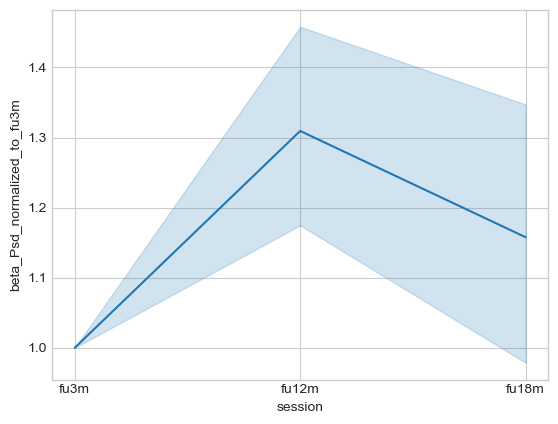

In [60]:
fig = plt.figure()

ax = sns.lineplot(data=normalizedToFu3m_psd_Dataframe, x="session", y="beta_Psd_normalized_to_fu3m")

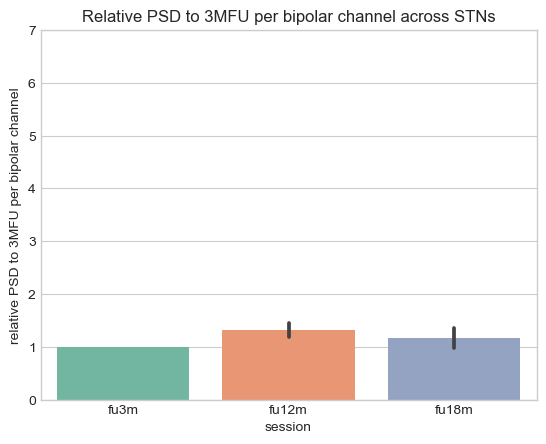

In [69]:
fig = plt.figure()

ax = sns.barplot(data=normalizedToFu3m_psd_Dataframe, x="session", y="beta_Psd_normalized_to_fu3m", palette="Set2")
plt.title("Relative PSD to 3MFU per bipolar channel across STNs")
plt.ylabel("relative PSD to 3MFU per bipolar channel")
plt.ylim(0, 7)

figures_path = find_folders.get_local_path(folder="GroupFigures")
fig.savefig(figures_path + f"\\relativeTo_Fu3m_rawPSD_beta_barplot.png", bbox_inches="tight")

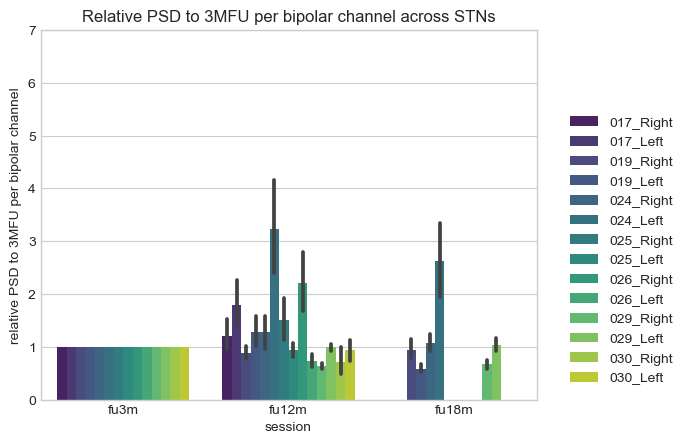

In [70]:
fig = plt.figure()

ax = sns.barplot(data=normalizedToFu3m_psd_Dataframe, x="session", y="beta_Psd_normalized_to_fu3m", hue="subject_hemisphere", palette="viridis")
plt.legend(loc="upper right", bbox_to_anchor=(1.3, 0.8))
plt.title("Relative PSD to 3MFU per bipolar channel across STNs")
plt.ylabel("relative PSD to 3MFU per bipolar channel")
plt.ylim(0, 7)

figures_path = find_folders.get_local_path(folder="GroupFigures")
fig.savefig(figures_path + f"\\relativeTo_Fu3m_rawPSD_beta_barplot_perSTN.png", bbox_inches="tight")

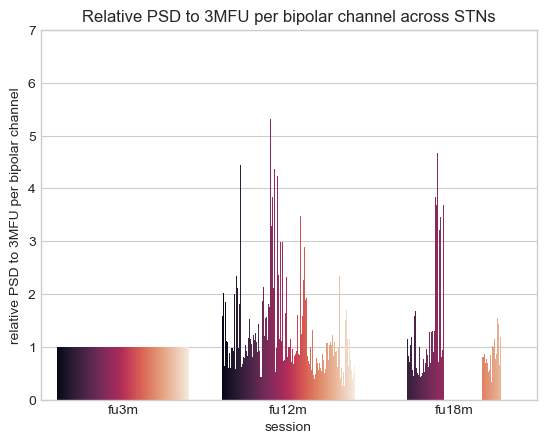

In [71]:
fig = plt.figure()

ax = sns.barplot(data=normalizedToFu3m_psd_Dataframe, x="session", y="beta_Psd_normalized_to_fu3m", hue="subject_hemisphere_BIPchannel", palette="rocket")
# plt.legend(loc="upper right", bbox_to_anchor=(1.3, 0.8))
ax.get_legend().remove()

plt.title("Relative PSD to 3MFU per bipolar channel across STNs")
plt.ylabel("relative PSD to 3MFU per bipolar channel")
plt.ylim(0, 7)

figures_path = find_folders.get_local_path(folder="GroupFigures")
fig.savefig(figures_path + f"\\relativeTo_Fu3m_rawPSD_beta_barplot_perSTN_BIPchannel.png", bbox_inches="tight")


## 3. Plot Channels in 3 groups: Ring, SegmIntra, SegmInter

Use the Function PowerSpectra_perChannelGroup

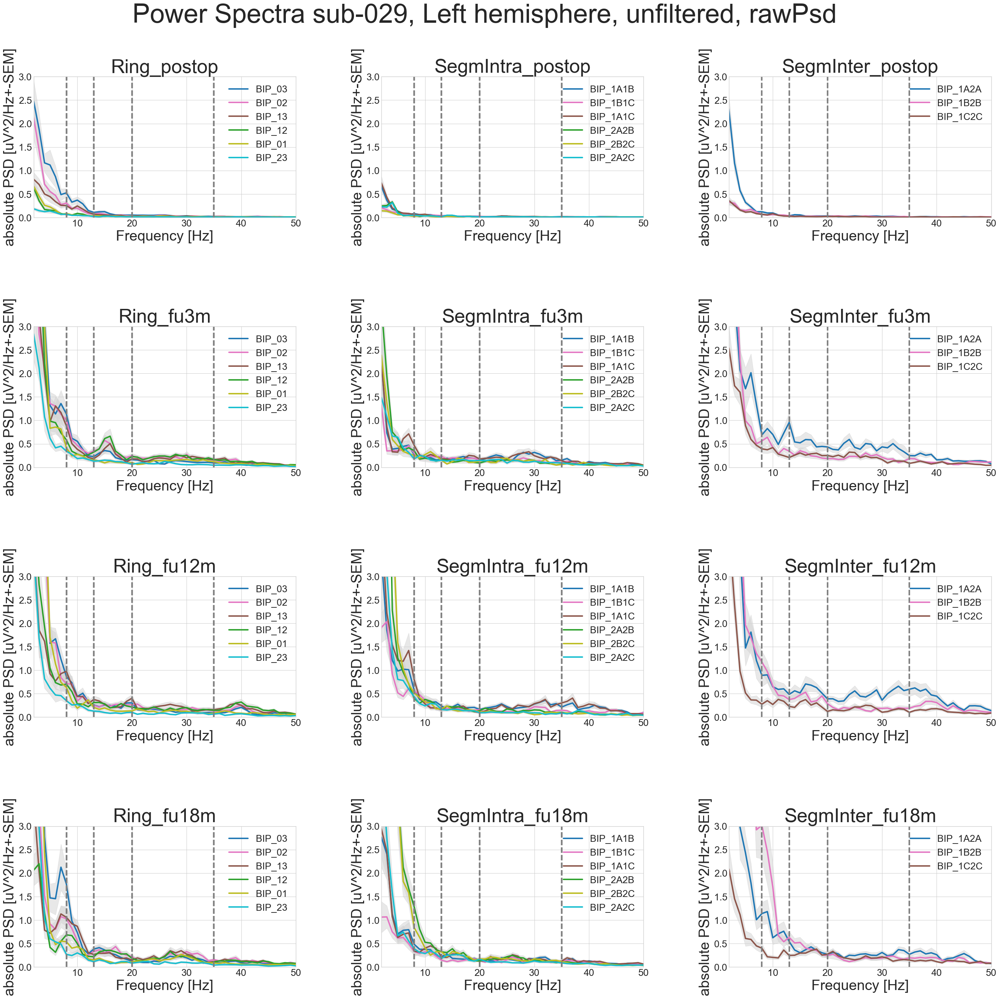

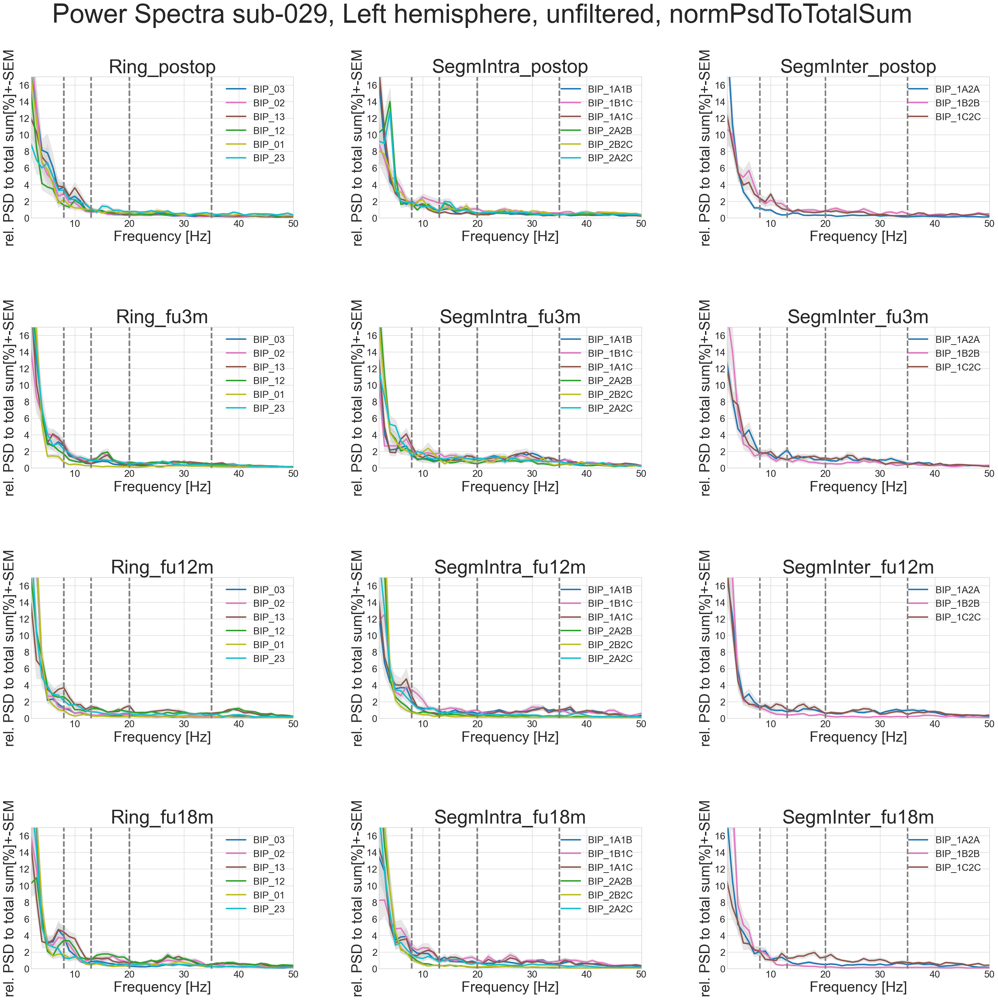

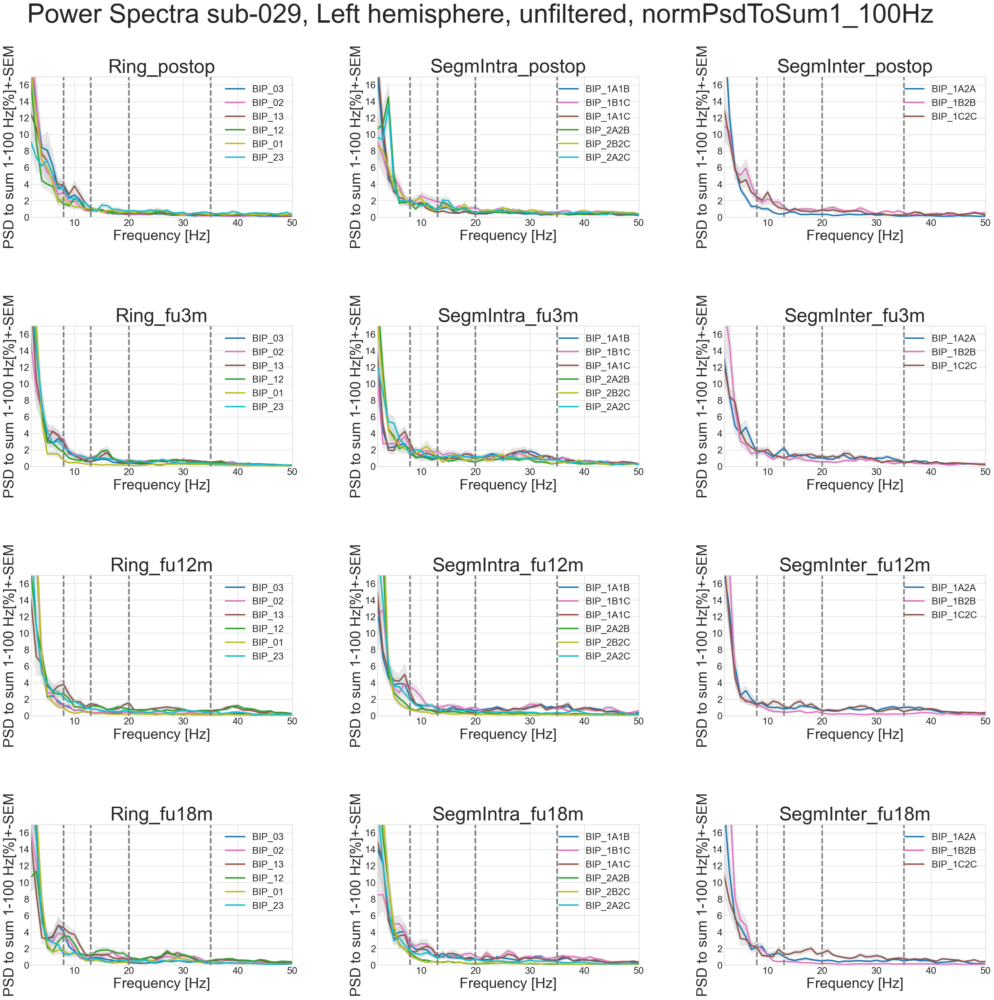

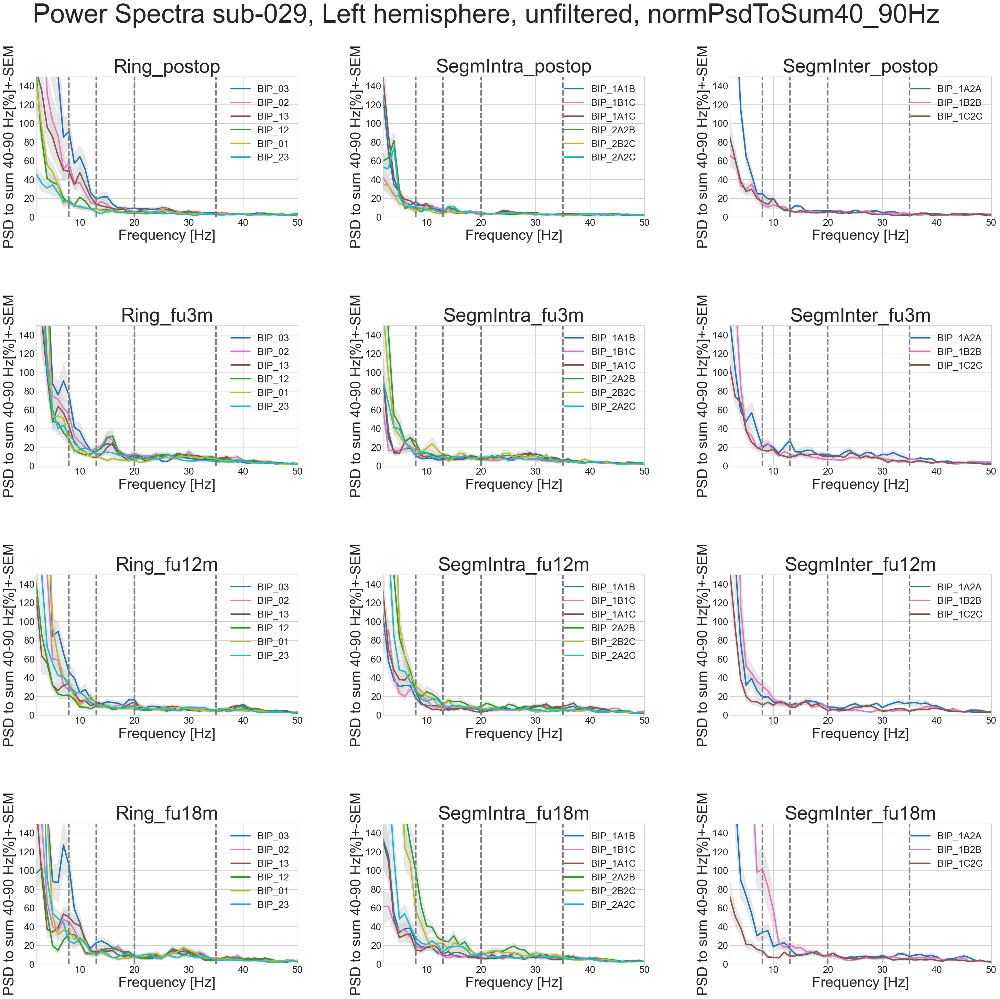

In [11]:
PowerSpectra = PowerSpectraChannels.PowerSpectra_perChannelGroup(
    sub="029",
    hemisphere="Left",
    incl_session=["postop", "fu3m", "fu12m", "fu18m"],
    signalFilter="band-pass",
    normalization=["rawPsd", "normPsdToTotalSum", "normPsdToSum1_100Hz", "normPsdToSum40_90Hz"]
)

In [6]:
data = mainAnalysis_class.MainClass(
    sub="029",
    hemisphere = "Right",
    filter = "band-pass",
    result = "PowerSpectrum",
    incl_session = ["postop", "fu3m", "fu12m", "fu18m"],
    pickChannels = ['03', '13', '02', '12', '01', '23', 
                    '1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C', 
                    '1A2A', '1B2B', '1C2C'],
    normalization = ["rawPsd", "normPsdToSum1_100Hz"],
    freqBands = None,
    feature= ["frequency", "rawPsd", "SEM_rawPsd"]
    
)

In [7]:
data.postop.BIP_01.Result_DF

,session,bipolarChannel,frequency,time_sectors,rawPsd,SEM_rawPsd,normPsdToTotalSum,SEM_normPsdToTotalSum,normPsdToSumPsd1to100Hz,SEM_normPsdToSumPsd1to100Hz,normPsdToSum40to90Hz,SEM_normPsdToSum40to90Hz
postop_LFP_R_01_STN_MT,postop,LFP_R_01_STN_MT,"[0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, ...","[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, ...","[0.0002510561, 0.000113694, 5.2937e-06, 0.0003...","[7.41735e-05, 3.31311e-05, 1.0201e-06, 7.4548e...","[0.0159937321, 0.0072429658, 0.0003372377, 0.0...","[0.0047252854, 0.0021106444, 6.49882e-05, 0.00...","[0.0159978521, 0.0072448316, 0.0003373246, 0.0...","[0.0047265026, 0.0021111881, 6.5005e-05, 0.004...","[0.0505988744, 0.0229143464, 0.0010669085, 0.0...","[0.0149492389, 0.0066773802, 0.0002056012, 0.0..."


Create 3 groups: Ring, SegmIntra, SegmInter (3 columns)
- plot all group channels within one plot
- 4 rows for each session timepoint

In [ ]:
# plt.subplot(4, 3, 1, label=chan) -> Ring postop 
# plt.subplot(4, 3, 2, label=chan) -> SegmIntra postop
# plt.subplot(4, 3, 3, label=chan) -> SegmInterr postop

# plt.subplot(4, 3, 4, label=chan) -> Ring fu3m
# plt.subplot(4, 3, 5, label=chan) -> SegmIntra fu3m
# plt.subplot(4, 3, 6, label=chan) -> SegmInterr fu3m


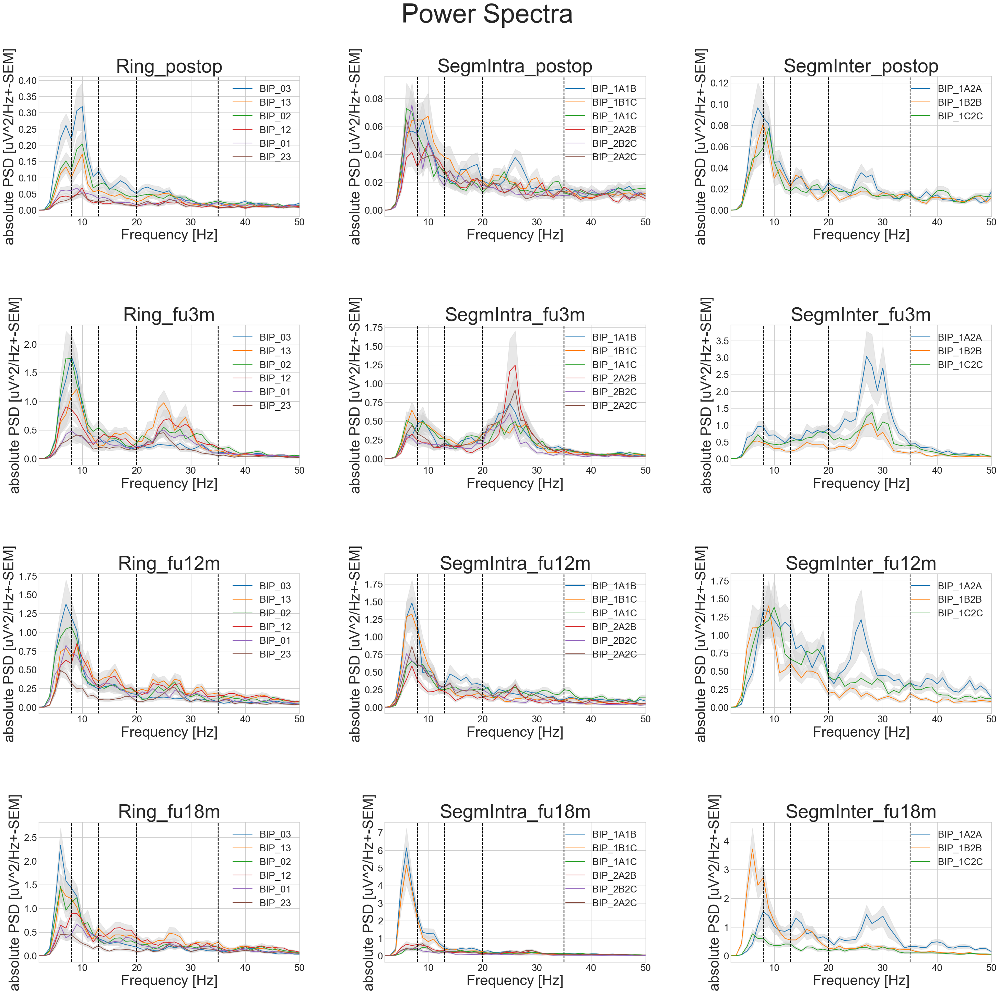

In [26]:
sessions = ["postop", "fu3m", "fu12m", "fu18m"]
groupChannels = ["Ring", "SegmIntra", "SegmInter"]

Ring = ['BIP_03', 'BIP_13', 'BIP_02', 'BIP_12', 'BIP_01', 'BIP_23']
SegmIntra = ['BIP_1A1B', 'BIP_1B1C', 'BIP_1A1C', 'BIP_2A2B', 'BIP_2B2C', 'BIP_2A2C']
SegmInter = ['BIP_1A2A', 'BIP_1B2B', 'BIP_1C2C']

fig = plt.figure(figsize= (30, 30), layout="tight")

for g, group in enumerate(groupChannels): # 0,1,2
      
    for s, ses in enumerate(sessions): # 0,1,2,3
    #for g, group in enumerate(groupChannels):

        if ses == "postop":
            plt.subplot(4,3,s+g+1, label=f"{group}_{ses}") # e.g. 0+0+1, 0+1+1, 0+2+1 = row1
        
        if ses == "fu3m":
            plt.subplot(4,3,s+g+3, label=f"{group}_{ses}") # e.g. 1+0+3, 1+1+3, 1+2+3 = row1
        
        if ses == "fu12m":
            plt.subplot(4,3,s+g+5, label=f"{group}_{ses}") # e.g. 2+0+5, 2+1+5, 2+2+5 = row1
        
        if ses == "fu18m":
            plt.subplot(4,3,s+g+7, label=f"{group}_{ses}") # e.g. 3+0+7, 3+1+7, 3+2+7 = row1

        # for each group, get all channels
        for c, chan in enumerate(eval(group)):
            # get f, psd and sem from data
            PowerSpectrum = getattr(data, ses)
            PowerSpectrum = getattr(PowerSpectrum, chan)

            f = PowerSpectrum.frequency.data
            psd = np.array(PowerSpectrum.rawPsd.data)
            sem = np.array(PowerSpectrum.SEM_rawPsd.data)

            # plot each Power spectrum for each channel in the same group_ses subplot
            plt.title(f"{group}_{ses}", fontdict={"size": 40})
            plt.plot(f, psd, label = f"{chan}")
            plt.fill_between(f, psd-sem, psd+sem, color="lightgray", alpha=0.5)

            # add lines for freq Bands
            plt.axvline(x=8, color='black', linestyle='--')
            plt.axvline(x=13, color='black', linestyle='--')
            plt.axvline(x=20, color='black', linestyle='--')
            plt.axvline(x=35, color='black', linestyle='--')

            plt.xlabel("Frequency [Hz]", fontdict={"size": 30})
            plt.xlim(2, 50)
            plt.ylabel("absolute PSD [uV^2/Hz+-SEM]", fontdict={"size": 30})
            plt.xticks(fontsize= 20), plt.yticks(fontsize= 20)
            plt.legend(loc= 'upper right', edgecolor="black", fontsize=20)


# Title of each plot per normalization variant
fig.suptitle(f"Power Spectra", fontsize=55, y=1.02)

# adjust Layout
fig.subplots_adjust(wspace=40, hspace=60)
# plt.tight_layout(pad=10, w_pad=10, h_pad=10)

plt.show()



## 4. Plot the PSD average within beta/highBeta/lowBeta 
- plot seperately in 3 groups: Ring (6 channels), SegmIntra (6 channels), SegmInter (3 channels)
- get the average of all subject hemisphere per timepoint
- plot mean of all subject_hemispheres +- standard deviation (distribution)

In [109]:
sns.color_palette("viridis", n_colors=25)

[(0.277941, 0.056324, 0.381191),
 (0.283091, 0.110553, 0.431554),
 (0.280868, 0.160771, 0.472899),
 (0.271828, 0.209303, 0.504434),
 (0.257322, 0.25613, 0.526563),
 (0.239346, 0.300855, 0.540844),
 (0.221989, 0.339161, 0.548752),
 (0.203063, 0.379716, 0.553925),
 (0.185556, 0.41857, 0.556753),
 (0.169646, 0.456262, 0.55803),
 (0.154815, 0.493313, 0.55784),
 (0.140536, 0.530132, 0.555659),
 (0.127568, 0.566949, 0.550556),
 (0.120092, 0.600104, 0.54253),
 (0.123444, 0.636809, 0.528763),
 (0.146616, 0.67305, 0.508936),
 (0.19109, 0.708366, 0.482284),
 (0.252899, 0.742211, 0.448284),
 (0.327796, 0.77398, 0.40664),
 (0.404001, 0.800275, 0.362552),
 (0.496615, 0.826376, 0.306377),
 (0.595839, 0.848717, 0.243329),
 (0.699415, 0.867117, 0.175971),
 (0.804182, 0.882046, 0.114965),
 (0.906311, 0.894855, 0.098125)]

Plot as Lineplot

In [77]:
# BIP_function = BIP_channelGroups.PsdAverage_specificRingSegmGroups_lineplot(
#     incl_sub=["024", "025", "026", "029", "030", "033"] ,
#     signalFilter="band-pass",
#     normalization="normPsdToSum40_90Hz",
#     freqBands=["alpha", "beta", "highBeta", "lowBeta"]
# )

Plot as Boxplot

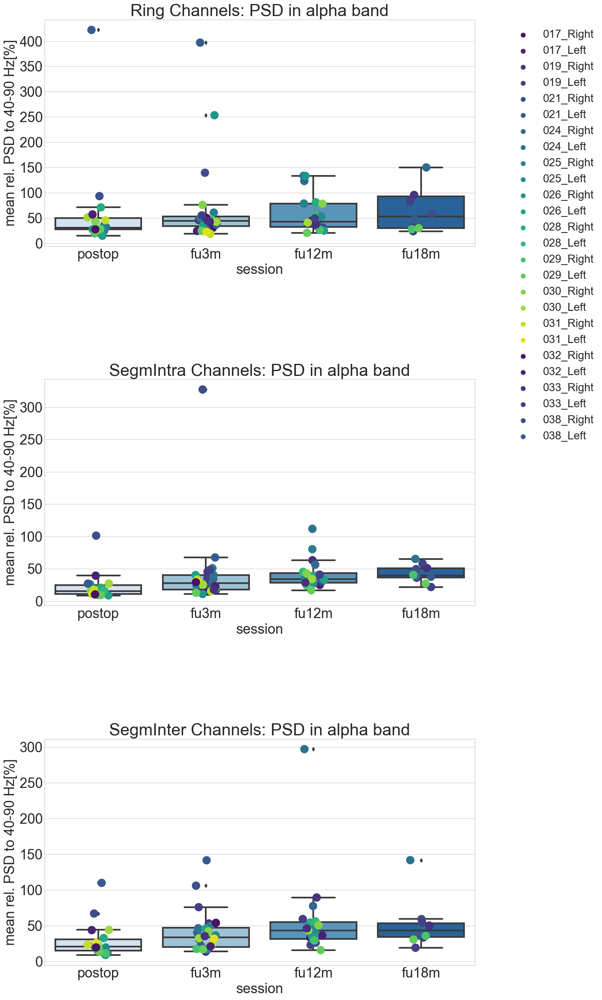

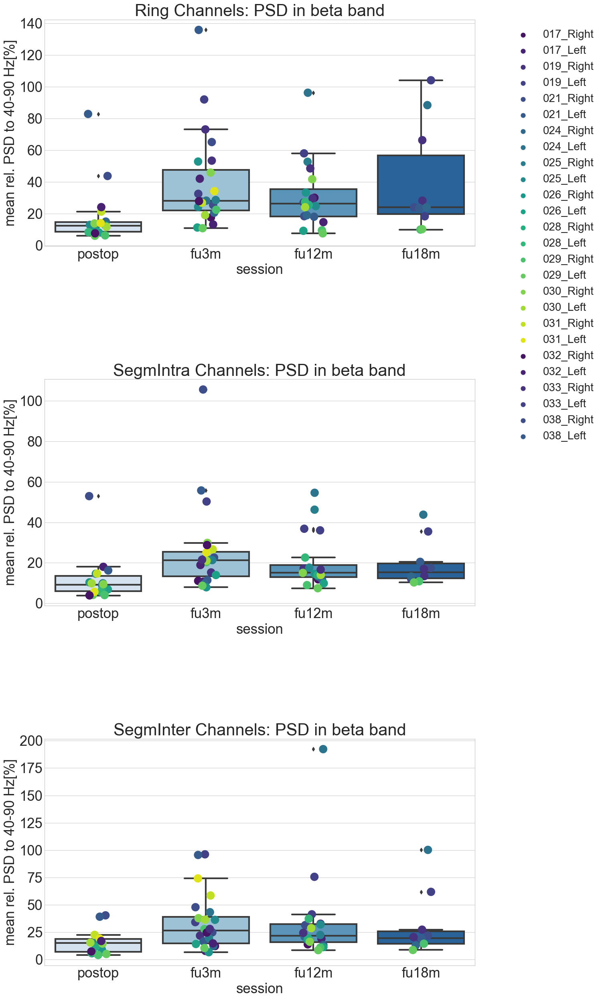

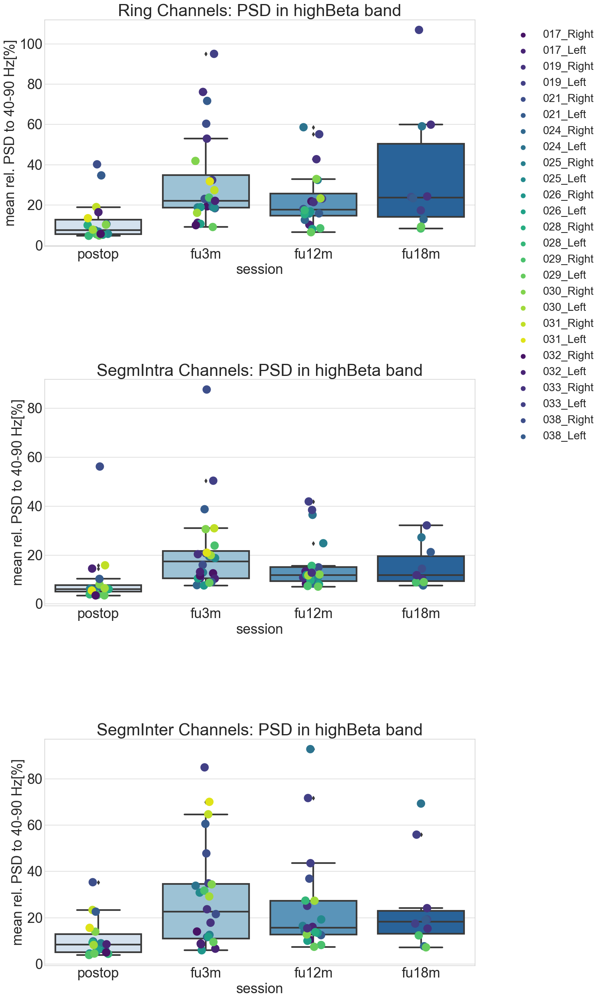

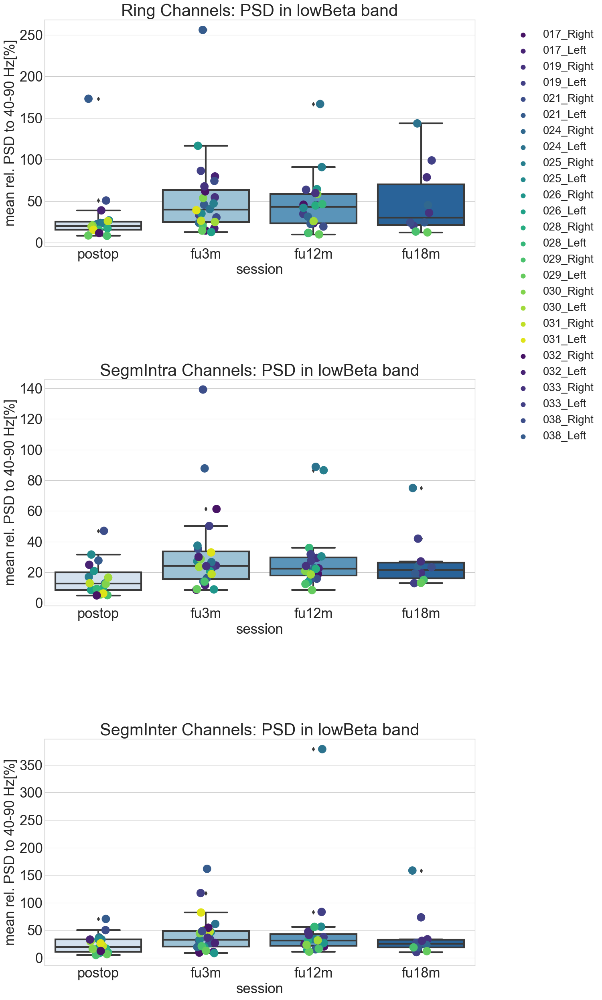

In [20]:
# use the functions
# PsdAverage_RingSegmGroups includes ALL RING CHANNELS
# PsdAverage_specificRingSegmGroups only includes SPECIFIC RING CHANNELS 01,12,13

BIP_function = BIP_channelGroups.PsdAverage_RingSegmGroups(
    incl_sub=["017", "019", "021","024", "025", "026", "028", "029", "030", "031", "032", "033", "038"] ,
    signalFilter="band-pass",
    normalization="normPsdToSum40_90Hz",
    freqBands=["alpha", "beta", "highBeta", "lowBeta"]
)

In [23]:
BIP_function["Ring_DF"]['017_Right_fu3m_alpha']

,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD
fu3m_LFP_R_03_STN_MT_psdAverage_normPsdToSum40_90Hz_alpha,fu3m,LFP_R_03_STN_MT,alpha,normPsdToSum40_90Hz,48.122303
fu3m_LFP_R_13_STN_MT_psdAverage_normPsdToSum40_90Hz_alpha,fu3m,LFP_R_13_STN_MT,alpha,normPsdToSum40_90Hz,22.988627
fu3m_LFP_R_02_STN_MT_psdAverage_normPsdToSum40_90Hz_alpha,fu3m,LFP_R_02_STN_MT,alpha,normPsdToSum40_90Hz,40.417949
fu3m_LFP_R_12_STN_MT_psdAverage_normPsdToSum40_90Hz_alpha,fu3m,LFP_R_12_STN_MT,alpha,normPsdToSum40_90Hz,14.418799
fu3m_LFP_R_01_STN_MT_psdAverage_normPsdToSum40_90Hz_alpha,fu3m,LFP_R_01_STN_MT,alpha,normPsdToSum40_90Hz,32.230965
fu3m_LFP_R_23_STN_MT_psdAverage_normPsdToSum40_90Hz_alpha,fu3m,LFP_R_23_STN_MT,alpha,normPsdToSum40_90Hz,24.376247


In [88]:
# load the data of one subject

data = mainAnalysis_class.MainClass(
    sub="017",
    hemisphere = "Right",
    filter = "band-pass",
    result = "PeakParameters",
    incl_session = ["postop", "fu3m", "fu12m", "fu18m"],
    pickChannels = ['03', '13', '02', '12', '01', '23', 
                    '1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C', 
                    '1A2A', '1B2B', '1C2C'],
    normalization = ["rawPsd"],
    freqBands = ["beta", "highBeta", "lowBeta"],
    feature= ["PEAK_frequency", "PEAK_amplitude", "PEAK_5HzAverage"]
)
    

In [89]:
# loop through the data of all subjects

subjects = ["017", "019", "024", "025", "026", "029", "030"]
hemispheres = ["Right", "Left"]
sessions = ["postop", "fu3m", "fu12m", "fu18m"]

data = {}
Ring_DF = {}
SegmIntra_DF = {}
SegmInter_DF = {}

for sub in subjects:
    for hem in hemispheres:

        # load the data from each subject hemisphere
        data[f"{sub}_{hem}"] = mainAnalysis_class.MainClass(
            sub=sub,
            hemisphere = hem,
            filter = "band-pass",
            result = "PeakParameters",
            incl_session = ["postop", "fu3m", "fu12m", "fu18m"],
            pickChannels = ['03', '13', '02', '12', '01', '23', 
                            '1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C', 
                            '1A2A', '1B2B', '1C2C'],
            normalization = ["rawPsd"],
            freqBands = ["beta", "highBeta", "lowBeta"],
            feature= ["PEAK_frequency", "PEAK_amplitude", "PEAK_5HzAverage"]
        )
        
        # for each timepoint seperately, get the Dataframes of the correct normalization and frequency band
        for ses in sessions:

            # get the Dataframe
            if ses == "postop":
                # Error check: check if session exists as an attribute of one subject_hemisphere object
                try: 
                    data[f"{sub}_{hem}"].postop
                
                except AttributeError:
                    continue
                    
                session_DF = data[f"{sub}_{hem}"].postop.Result_DF # select for session
                norm_session_DF = session_DF[session_DF.absoluteOrRelativePSD == "rawPsd"] # select for absolute PSD instead of relative
                freqBand_norm_session_DF = norm_session_DF[norm_session_DF.frequencyBand == "beta"] # select  for beta frequency band
            
            # get the Dataframe
            if ses == "fu3m":
                # Error check: check if session exists as an attribute of one subject_hemisphere object
                try: 
                    data[f"{sub}_{hem}"].fu3m
                
                except AttributeError:
                    continue
                    
                session_DF = data[f"{sub}_{hem}"].fu3m.Result_DF # select for session
                norm_session_DF = session_DF[session_DF.absoluteOrRelativePSD == "rawPsd"] # select for absolute PSD instead of relative
                freqBand_norm_session_DF = norm_session_DF[norm_session_DF.frequencyBand == "beta"] # select  for beta frequency band
            
            # get the Dataframe
            if ses == "fu12m":
                # Error check: check if session exists as an attribute of one subject_hemisphere object
                try: 
                    data[f"{sub}_{hem}"].fu12m
                
                except AttributeError:
                    continue
                    
                session_DF = data[f"{sub}_{hem}"].fu12m.Result_DF # select for session
                norm_session_DF = session_DF[session_DF.absoluteOrRelativePSD == "rawPsd"] # select for absolute PSD instead of relative
                freqBand_norm_session_DF = norm_session_DF[norm_session_DF.frequencyBand == "beta"] # select  for beta frequency band
            
            # get the Dataframe
            if ses == "fu18m":
                # Error check: check if session exists as an attribute of one subject_hemisphere object
                try: 
                    data[f"{sub}_{hem}"].fu18m
                
                except AttributeError:
                    continue
                    
                session_DF = data[f"{sub}_{hem}"].fu18m.Result_DF # select for session
                norm_session_DF = session_DF[session_DF.absoluteOrRelativePSD == "rawPsd"] # select for absolute PSD instead of relative
                freqBand_norm_session_DF = norm_session_DF[norm_session_DF.frequencyBand == "beta"] # select  for beta frequency band


            # divide the Dataframe in 3 groups: Ring, SegmIntra, SegmInter
            Ring = ['03', '13', '02', '12', '01', '23']
            SegmIntra = ['1A1B', '1B1C', '1A1C', '2A2B', '2B2C', '2A2C'] 
            SegmInter = ['1A2A', '1B2B', '1C2C']

            # Dataframe with all Ring Channels
            Ring_DF[f"{sub}_{hem}_{ses}"] = pd.DataFrame()
            for chan in Ring:
                channel_DF = freqBand_norm_session_DF[freqBand_norm_session_DF.bipolarChannel.str.contains(chan)]
                Ring_DF[f"{sub}_{hem}_{ses}"] = pd.concat([Ring_DF[f"{sub}_{hem}_{ses}"], channel_DF] )

            # Dataframe with all SegmIntra Channels
            SegmIntra_DF[f"{sub}_{hem}_{ses}"] = pd.DataFrame()
            for chan in SegmIntra:
                channel_DF = freqBand_norm_session_DF[freqBand_norm_session_DF.bipolarChannel.str.contains(chan)]
                SegmIntra_DF[f"{sub}_{hem}_{ses}"] = pd.concat([SegmIntra_DF[f"{sub}_{hem}_{ses}"], channel_DF])

            # Dataframe with all SegmInter Channels
            SegmInter_DF[f"{sub}_{hem}_{ses}"] = pd.DataFrame()
            for chan in SegmInter:
                channel_DF = freqBand_norm_session_DF[freqBand_norm_session_DF.bipolarChannel.str.contains(chan)]
                SegmInter_DF[f"{sub}_{hem}_{ses}"] = pd.concat([SegmInter_DF[f"{sub}_{hem}_{ses}"], channel_DF])
            

            



In [90]:
Ring_DF["024_Right_postop"]

,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,PEAK_frequency,PEAK_amplitude,PEAK_5HzAverage
postop_LFP_R_03_STN_MT_highestPEAK_rawPsd_beta,postop,LFP_R_03_STN_MT,beta,rawPsd,15.0,0.557416,0.489590
postop_LFP_R_02_STN_MT_highestPEAK_rawPsd_beta,postop,LFP_R_02_STN_MT,beta,rawPsd,15.0,0.710134,0.592502
postop_LFP_R_01_STN_MT_highestPEAK_rawPsd_beta,postop,LFP_R_01_STN_MT,beta,rawPsd,15.0,0.691845,0.582123


In [91]:
# get the average of all channels of one sub_hem_session_channel group 
# e.g. average of all Ring channels (n=6) of sub-24, Right, postop

meanPSD_RingChannels = {}
meanPSD_SegmIntraChannels = {}
meanPSD_SegmInterChannels = {}

# list of all existing combinations, e.g. ["024_Right_postop", "024_Right_fu3m"]
sub_hem_ses_combinations = list(Ring_DF.keys())

# get the mean from column averagedPSD of each combination for Ring, SegmIntra, SegmInter
# also get Standard deviation for each sub_hem_ses ???
for combination in sub_hem_ses_combinations:

    # split the sub_hem_ses combinations into sub_hem (will be label of plot) and ses (will be x axis)
    combination_split = combination.split("_")
    subject_hemisphere = "".join([combination_split[0], "_", combination_split[1]])
    sess = combination_split[2]
    
    # for each group, calculate the mean over the averagedPSD column, add to dictionary together with subject_hemisphere and session 
    meanPSD_RingChannels[combination] = [Ring_DF[combination].PEAK_frequency.mean(), subject_hemisphere, sess]
    meanPSD_SegmIntraChannels[combination] = [SegmIntra_DF[combination].PEAK_frequency.mean(), subject_hemisphere, sess]
    meanPSD_SegmInterChannels[combination] = [SegmInter_DF[combination].PEAK_frequency.mean(), subject_hemisphere, sess]



In [10]:
meanPSD_RingChannels["017_Left_fu12m"]

[0.18696875333333332, '017_Left', 'fu12m']

In [92]:
# new Dataframes per group Ring, SegmIntra, SegmInter
Ring_DF_meanChannels = pd.DataFrame.from_dict(meanPSD_RingChannels, orient="index", columns=["PEAKfrequency_beta_ChannelsPerHemisphere", "subject_hemisphere", "session"]) # keys of the dictionary will be indeces
Ring_DF_meanChannels.session.replace("postop", "fu0m", inplace=True)

SegmIntra_DF_meanChannels = pd.DataFrame.from_dict(meanPSD_SegmIntraChannels, orient="index", columns=["PEAKfrequency_beta_ChannelsPerHemisphere", "subject_hemisphere", "session"]) # keys of the dictionary will be indeces
SegmIntra_DF_meanChannels.session.replace("postop", "fu0m", inplace=True)

SegmInter_DF_meanChannels = pd.DataFrame.from_dict(meanPSD_SegmInterChannels, orient="index", columns=["PEAKfrequency_beta_ChannelsPerHemisphere", "subject_hemisphere", "session"]) # keys of the dictionary will be indeces
SegmInter_DF_meanChannels.session.replace("postop", "fu0m", inplace=True)


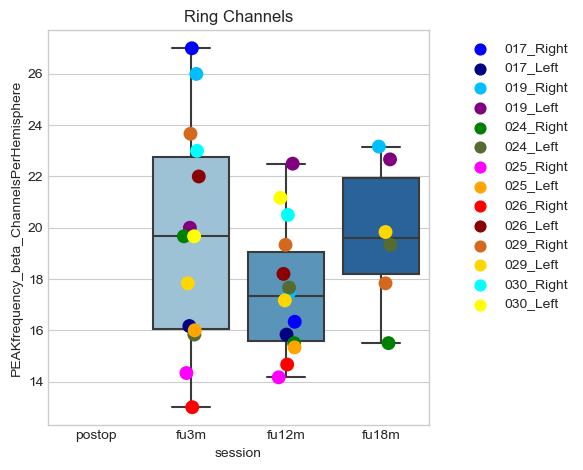

In [93]:
plt.figure()

ax = sns.boxplot(data=Ring_DF_meanChannels, x='session', y='PEAKfrequency_beta_ChannelsPerHemisphere', order=sessions, palette="Blues", width=0.8)
ax = sns.stripplot(x = "session",
    y = 'PEAKfrequency_beta_ChannelsPerHemisphere',
    hue = "subject_hemisphere",
    order=sessions,
    size=10,
    data = Ring_DF_meanChannels,
    )

pairs = list(combinations(sessions,2)) # list of pairs of combinations, e.g. "postop" vs "fu3m"

# to do a paired statistical test, number of values within each group must be equal!!! take out sub017, sub019, and session fu18m
# annotator = Annotator(ax, pairs, data=Ring_DF_meanChannels, x='session', y='PSDaverage_beta_ChannelsPerHemisphere')
# annotator.configure(test='t-test_paired', text_format='star')
# annotator.apply_and_annotate()

plt.title("Ring Channels")
plt.legend(loc= "upper right", bbox_to_anchor=(1.4, 1))
plt.tight_layout()

#plt.savefig(results_sub_folder + f"\\compareMonopolarPSDaverage_{freq_band}_{sub_hemisphere}_Wilcoxon.png")


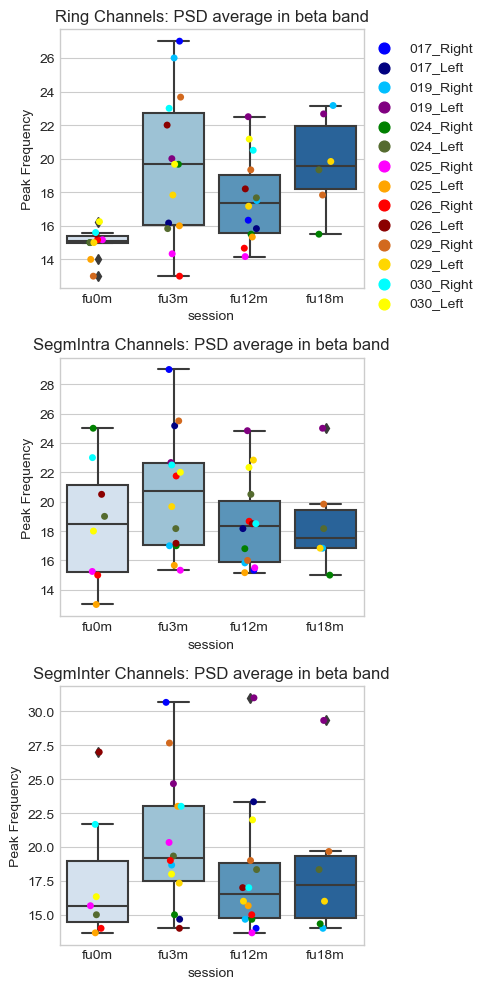

In [116]:

sessions = ["fu0m", "fu3m", "fu12m", "fu18m"]

# Create a list of 15 colors and add it to the cycle of matplotlib 
cycler_colors = cycler("color", ["blue", "navy", "deepskyblue", "purple", "green", "darkolivegreen", "magenta", "orange", "red", "darkred", "chocolate", "gold", "cyan",  "yellow", "lime"])
plt.rc('axes', prop_cycle=cycler_colors)
plt.figure(figsize=(5, 10), layout="tight")

channelGroup = ["Ring", "SegmIntra", "SegmInter"]
data_DF = {}

for g, group in enumerate(channelGroup):
    if group == "Ring":
        data_DF[group] = Ring_DF_meanChannels
        
    elif group == "SegmIntra":
        data_DF[group] = SegmIntra_DF_meanChannels
        

    elif group == "SegmInter":
        data_DF[group] = SegmInter_DF_meanChannels

    plt.subplot(3,1,g+1)
    #sns.lineplot(data=data_DF[group], x='session', y='PSDaverage_beta_ChannelsPerHemisphere', size_order=sessions)
    
    sns.boxplot(data=data_DF[group], 
                x='session', 
                y='PEAKfrequency_beta_ChannelsPerHemisphere', 
                order=sessions, 
                palette="Blues", 
                width=0.8,
                )
    # whis = whiskers are makers to define outliers
    sns.stripplot(x = "session",
        y = 'PEAKfrequency_beta_ChannelsPerHemisphere',
        hue = "subject_hemisphere",
        order=sessions,
        size=5,
        jitter=True,
        data = data_DF[group],
        )

    #pairs = list(combinations(sessions,2)) # list of pairs of combinations, e.g. "postop" vs "fu3m"

    # to do a paired statistical test, number of values within each group must be equal!!! take out sub017, sub019, and session fu18m
    # annotator = Annotator(ax, pairs, data=Ring_DF_meanChannels, x='session', y='PSDaverage_beta_ChannelsPerHemisphere')
    # annotator.configure(test='t-test_paired', text_format='star')
    # annotator.apply_and_annotate()

    plt.title(f"{group} Channels: PSD average in beta band")
    plt.ylabel("Peak Frequency")

    plt.legend(loc= "upper right", bbox_to_anchor=(1.4, 1))
    
    if group == "SegmIntra":
        plt.legend().remove()
    
    elif group == "SegmInter":
        plt.legend().remove()
        
        
    plt.tight_layout()






<function matplotlib.pyplot.show(close=None, block=None)>

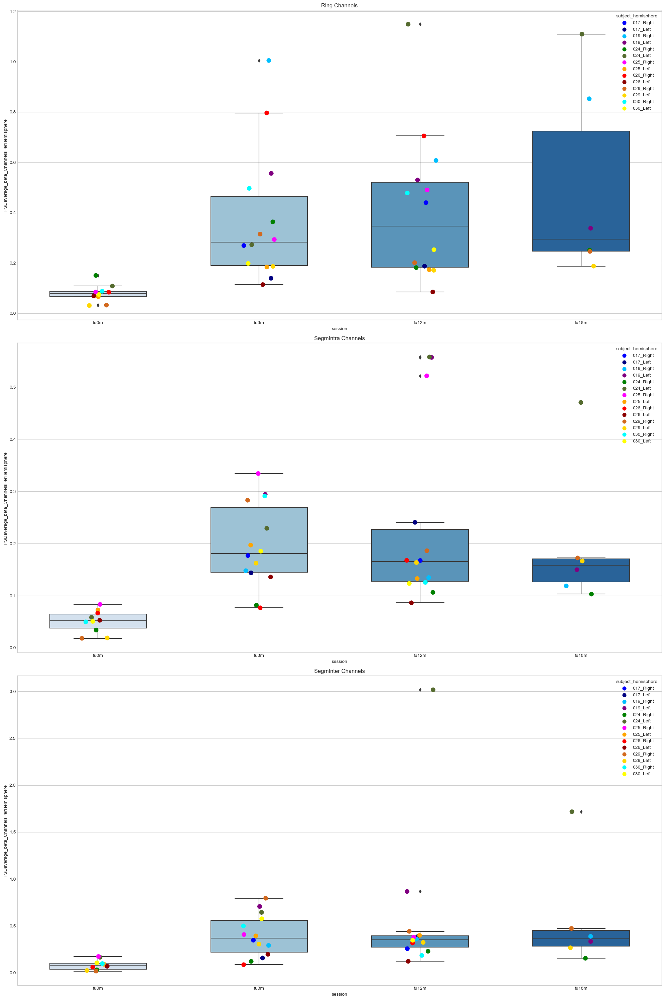

In [33]:
# make 3 subplots with titles Ring, SegmIntra, SegmInter

# per subplot, get mean +- SD of meanPSD of all sub_hem_ses combinations
# plot e.g. Ring channels, PSD average of beta band averaged per hemisphere and session
# x axis = sessions (postop, fu3m, fu12m, fu18m)
# y axis = PSD average in beta band
# label = sub_hem combination

sessions = ["fu0m", "fu3m", "fu12m", "fu18m"]

# fig, (ax1, ax2, ax3) = plt.subplots(nrows=3, ncols=1, sharex=True, figsize= (10, 15))
fig = plt.figure(figsize=(20, 30), layout="tight")

# Create a list of 15 colors and add it to the cycle of matplotlib 
cycler_colors = cycler("color", ["blue", "navy", "deepskyblue", "purple", "green", "darkolivegreen", "magenta", "orange", "red", "darkred", "chocolate", "gold", "cyan",  "yellow", "lime"])
plt.rc('axes', prop_cycle=cycler_colors)

channelGroup = ["Ring", "SegmIntra", "SegmInter"]
data_DF = {}

for g, group in enumerate(channelGroup):
    
    if group == "Ring":
        plt.subplot(3,1,1)
        data_DF[group] = Ring_DF_meanChannels
        

    elif group == "SegmIntra":
        plt.subplot(3,1,2)
        data_DF[group] = SegmIntra_DF_meanChannels
        

    elif group == "SegmInter":
        plt.subplot(3,1,3)
        data_DF[group] = SegmInter_DF_meanChannels
    
    else:
        print("something went wrong")
        
    # plot mean +- SD??
    ax = sns.boxplot(data=data_DF[group], 
                x='session', 
                y='PSDaverage_beta_ChannelsPerHemisphere', 
                order=sessions, 
                palette="Blues", 
                width=0.6)
    
    # plot each dot per subject_hemisphere
    ax = sns.stripplot(x = "session",
        y = 'PSDaverage_beta_ChannelsPerHemisphere',
        hue = "subject_hemisphere",
        order=sessions,
        size=10,
        data = data_DF[group],
        )

    #pairs = list(combinations(sessions,2)) # list of pairs of combinations, e.g. "postop" vs "fu3m"

    # to do a paired statistical test, number of values within each group must be equal!!! take out sub017, sub019, and session fu18m
    # annotator = Annotator(ax, pairs, data=Ring_DF_meanChannels, x='session', y='PSDaverage_beta_ChannelsPerHemisphere')
    # annotator.configure(test='t-test_paired', text_format='star')
    # annotator.apply_and_annotate()

    plt.title(f"{group} Channels")
    
    # ###### LEGEND ######
    # legend = ax1.legend(loc= 'upper right', edgecolor="black", bbox_to_anchor=(1.5, -0.1)) # only show the first subplot´s legend 
    # # frame the legend with black edges amd white background color 
    # legend.get_frame().set_alpha(None)
    # legend.get_frame().set_facecolor("white")


fig.tight_layout()
plt.show







## 5. Plot the Peak parameters of beta/highBeta/lowBeta averaged within channel groups
- plot seperately in 3 groups: Ring (3 channels), SegmIntra (6 channels), SegmInter (3 channels)
- get the average of all subject hemisphere per timepoint
- plot mean of all subject_hemispheres +- standard deviation (distribution)

COLUMNNAME PeakFrequency_ChannelsPerHemisphere


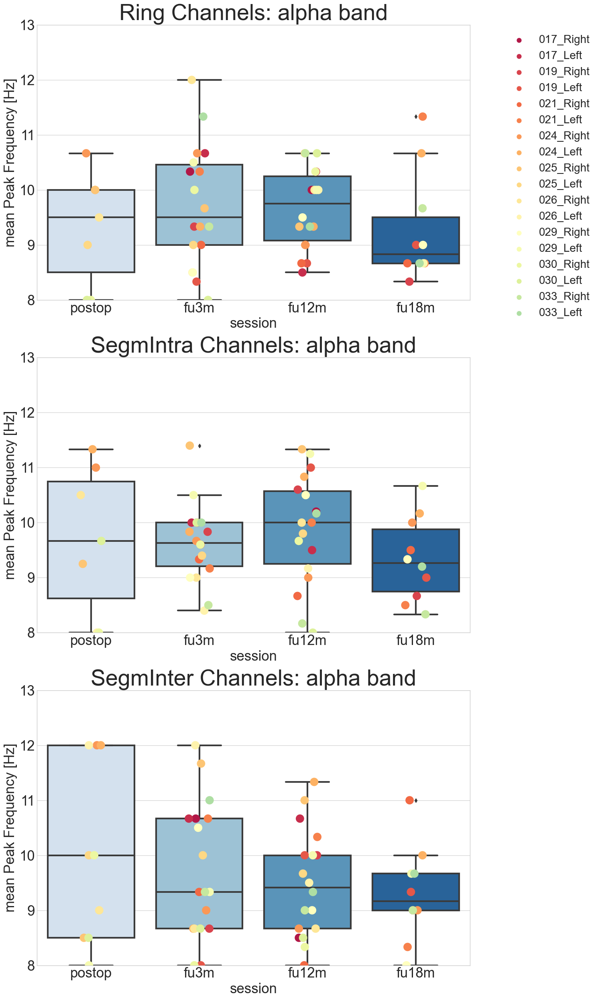

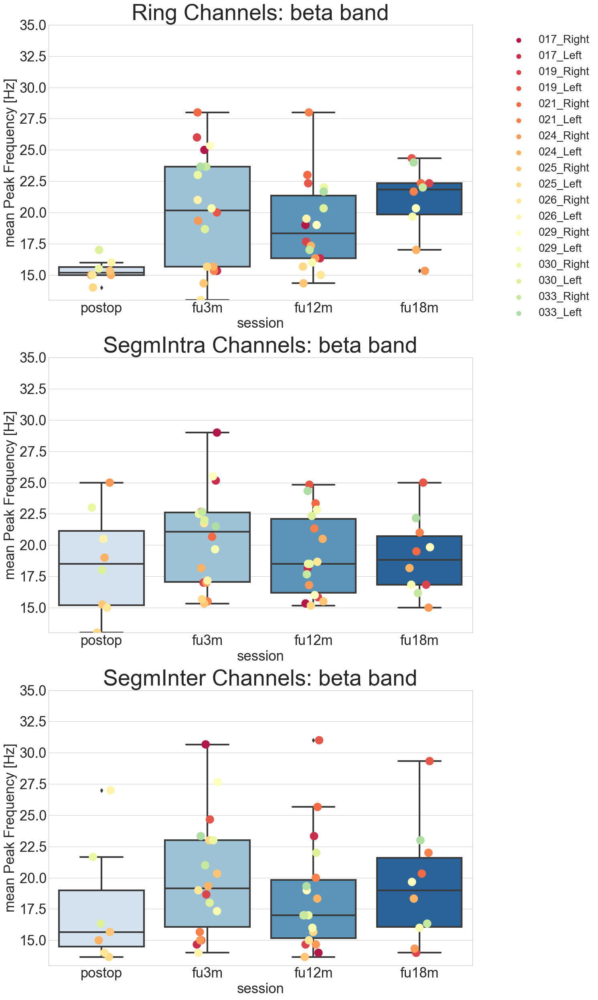

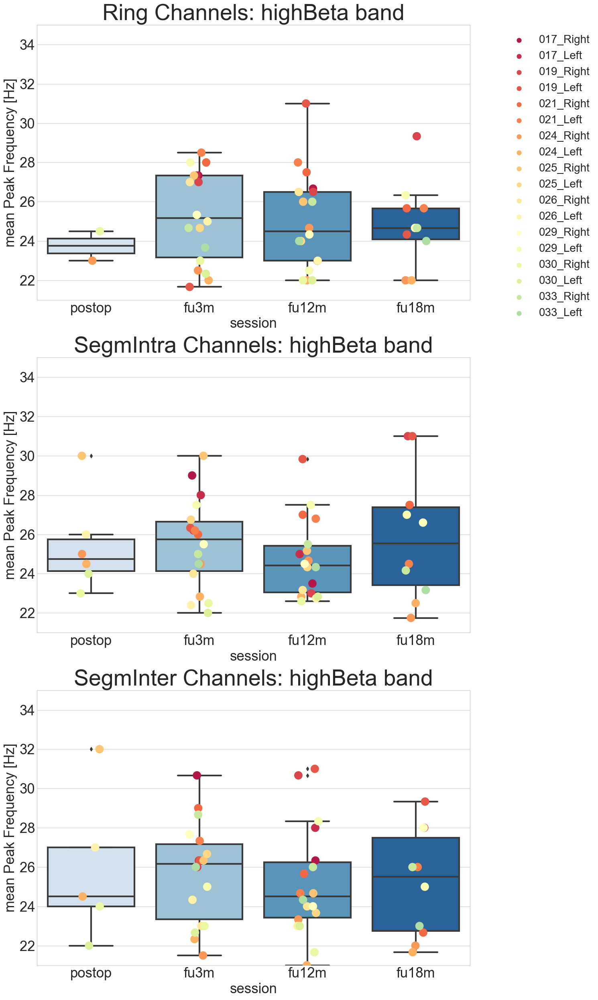

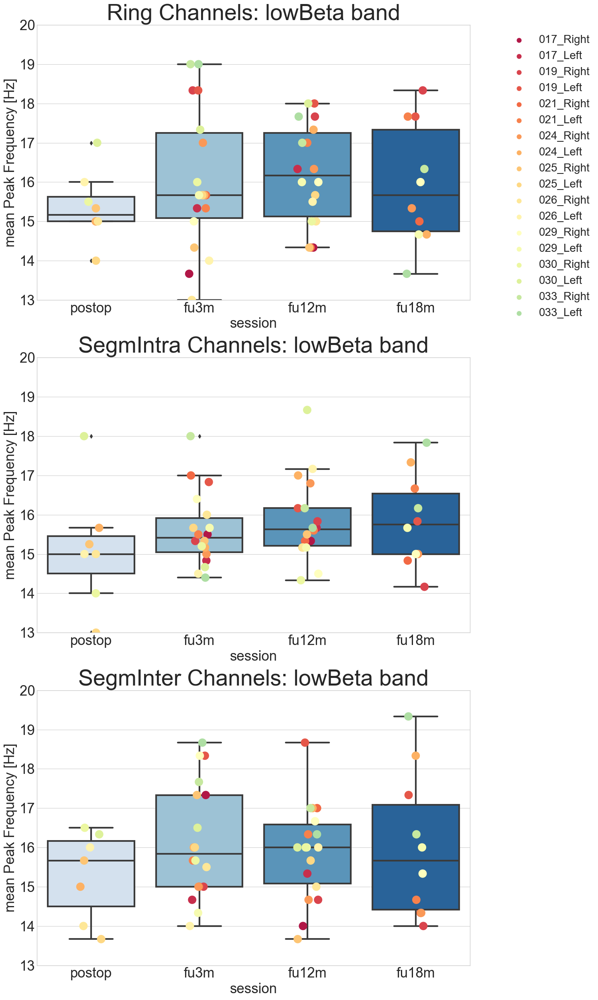

In [26]:
BIP_function = BIP_channelGroups.PeakPowerOrFrequency_specificRingSegmGroups(
    incl_sub=["017", "019", "021","024", "025", "026", "029", "030", "033"] ,
    signalFilter="band-pass",
    normalization="rawPsd",
    freqBands=["alpha", "beta", "highBeta", "lowBeta"],
    feature="PEAK_frequency"
)

## 5. Plot Peak values normalized to MEAN Postop to start with y=1

pickle file:  BIPpeak_Ring_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file:  BIPpeak_SegmIntra_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file:  BIPpeak_SegmInter_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
COLUMNNAME PeakFrequency_ChannelsPerHemisphere


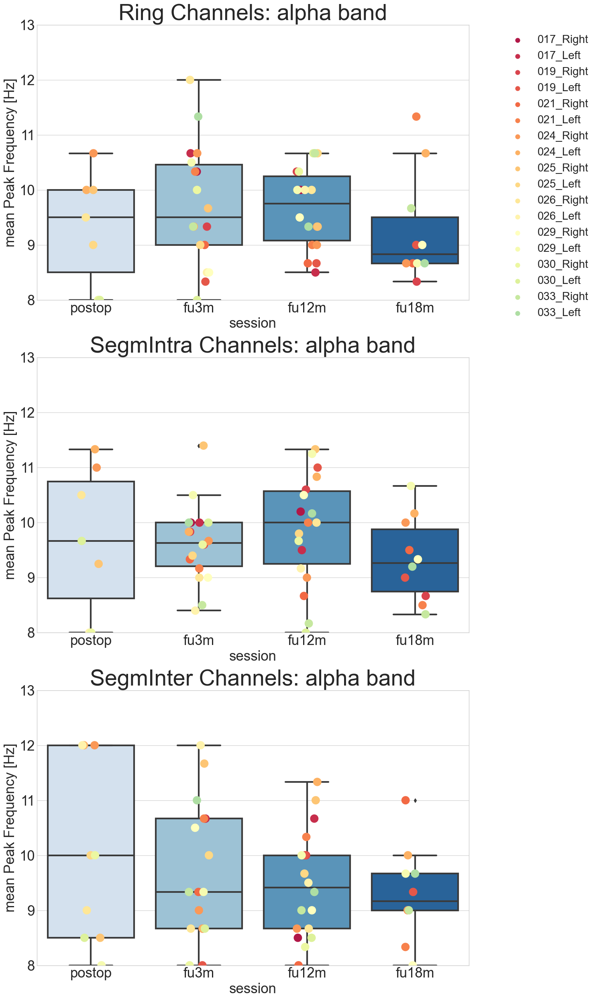

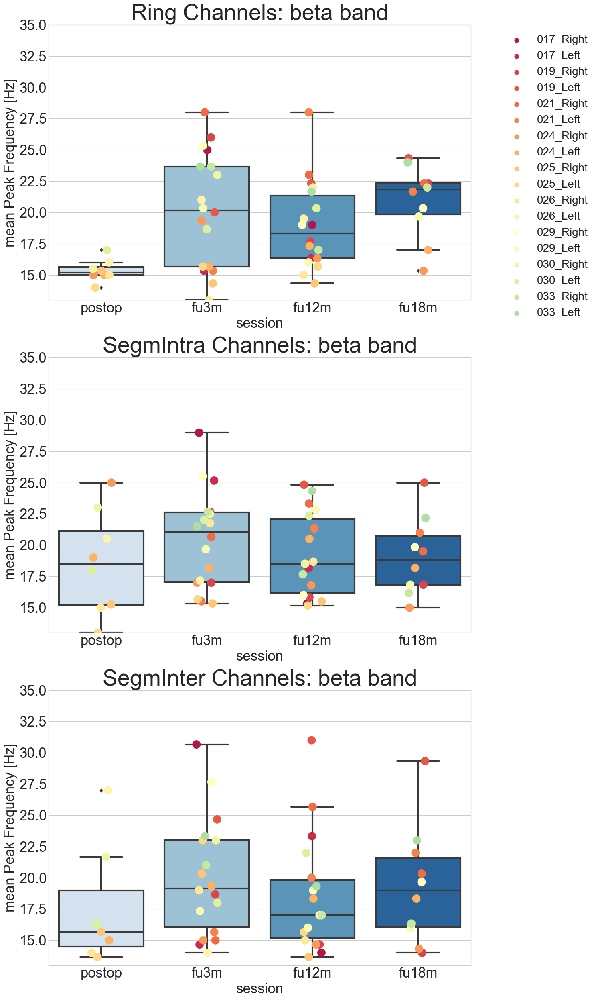

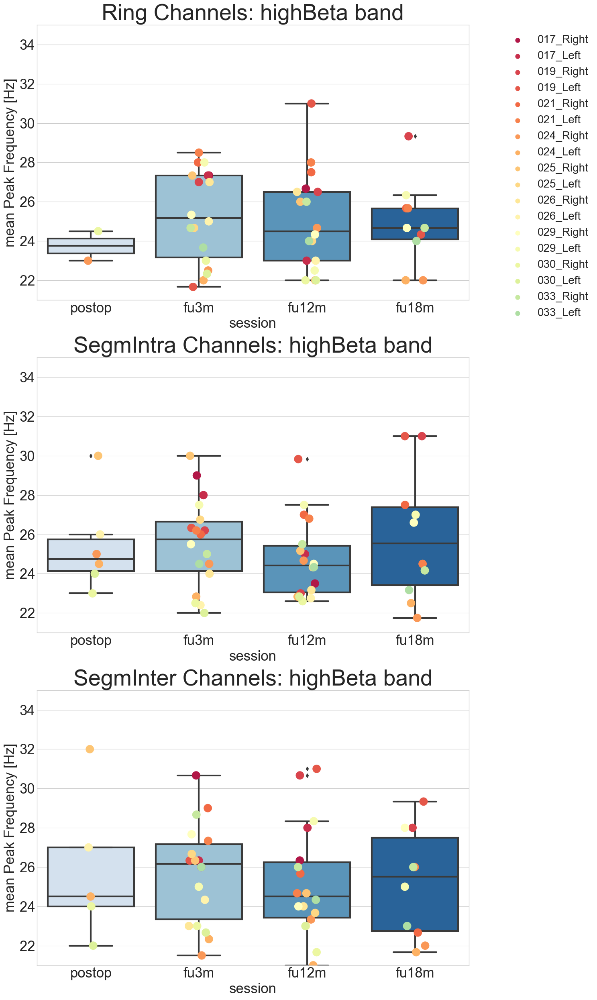

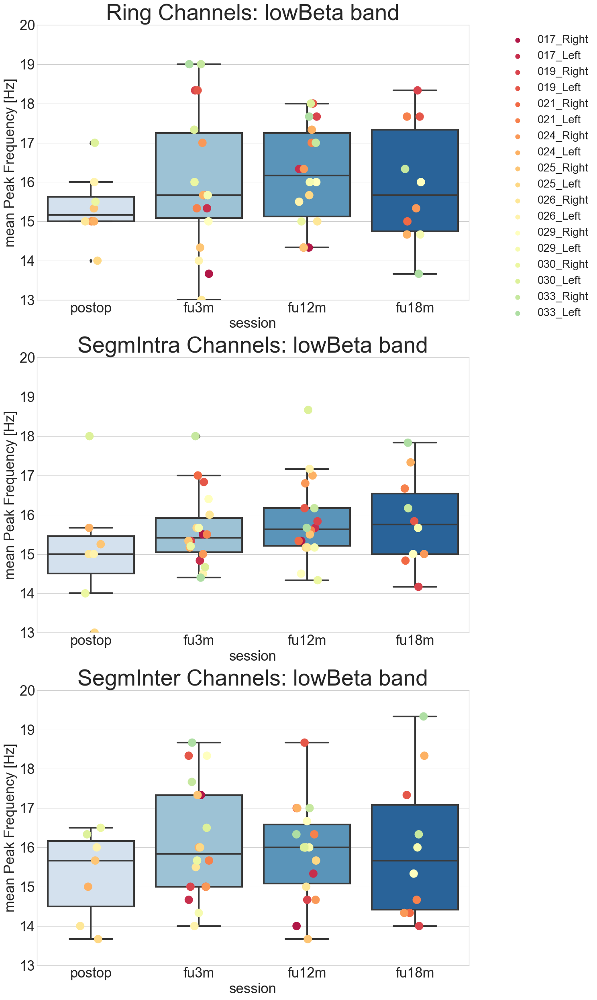

In [42]:
PlotPeakValues = BIP_channelGroups.PeakPowerOrFrequencyNormalizedLinePlot_specificRingSegmGroups(
    incl_sub=["017", "019", "021","024", "025", "026", "029", "030", "033"] ,
    signalFilter="band-pass",
    normalization="rawPsd",
    freqBands=["alpha", "beta", "highBeta", "lowBeta"],
    feature="PEAK_frequency"
)

In [52]:
PlotPeakValues["channelGroup_DF"]["SegmInter"]

,PeakFrequency_ChannelsPerHemisphere,subject_hemisphere,session,freqBand
017_Right_fu3m_lowBeta,17.333333,017_Right,fu3m,lowBeta
017_Right_fu12m_lowBeta,14.000000,017_Right,fu12m,lowBeta
017_Left_fu3m_lowBeta,14.666667,017_Left,fu3m,lowBeta
017_Left_fu12m_lowBeta,15.333333,017_Left,fu12m,lowBeta
019_Right_fu3m_lowBeta,15.000000,019_Right,fu3m,lowBeta
019_Right_fu12m_lowBeta,14.666667,019_Right,fu12m,lowBeta
019_Right_fu18m_lowBeta,14.000000,019_Right,fu18m,lowBeta
019_Left_fu3m_lowBeta,18.333333,019_Left,fu3m,lowBeta
019_Left_fu12m_lowBeta,18.666667,019_Left,fu12m,lowBeta
019_Left_fu18m_lowBeta,17.333333,019_Left,fu18m,lowBeta


In [55]:
PlotPeakValues["meanChannelRing_freqBand"]["alpha"]

,PeakFrequency_ChannelsPerHemisphere,subject_hemisphere,session,freqBand
017_Right_fu3m_alpha,10.333333,017_Right,fu3m,alpha
017_Right_fu12m_alpha,10.000000,017_Right,fu12m,alpha
017_Left_fu3m_alpha,10.666667,017_Left,fu3m,alpha
017_Left_fu12m_alpha,8.500000,017_Left,fu12m,alpha
019_Right_fu3m_alpha,9.333333,019_Right,fu3m,alpha
019_Right_fu12m_alpha,10.333333,019_Right,fu12m,alpha
019_Right_fu18m_alpha,8.333333,019_Right,fu18m,alpha
019_Left_fu3m_alpha,8.333333,019_Left,fu3m,alpha
019_Left_fu12m_alpha,8.666667,019_Left,fu12m,alpha
019_Left_fu18m_alpha,9.000000,019_Left,fu18m,alpha


## 6. Rank the BIP Channels within each Channel Group, transform into DF as preparation for Permutation

In [31]:
# automatized Function to rank Psd averages 
### watch out!! for result="peak" -> not every BIP channel has a value... don´t understand why
### especially postop channels!!!

rankDF = BIP_ranks.Rank_BIPRingSegmGroups(
    result = "psdAverage",
    filterSignal = "band-pass",
    normalization = "rawPsd",
    freqBand = "highBeta"
)


pickle file:  BIPpsdAverage_Ring_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file:  BIPpsdAverage_SegmInter_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file:  BIPpsdAverage_SegmIntra_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
new file:  BIPranksChannelGroup_session_dict_psdAverage_highBeta_rawPsd_band-pass.pickle 
in:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [32]:
rankDF["ranks_channelGroup_session_dictionary"].keys()

dict_keys(['Ring_postop', 'Ring_fu3m', 'Ring_fu12m', 'Ring_fu18m', 'SegmInter_postop', 'SegmInter_fu3m', 'SegmInter_fu12m', 'SegmInter_fu18m', 'SegmIntra_postop', 'SegmIntra_fu3m', 'SegmIntra_fu12m', 'SegmIntra_fu18m'])

In [33]:
rankDF["ranks_channelGroup_session_dictionary"]["Ring_fu3m"]

,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD,rank,subject_hemisphere
0,fu3m,LFP_R_12_STN_MT,highBeta,rawPsd,0.372421,1.0,017_Right
1,fu3m,LFP_R_01_STN_MT,highBeta,rawPsd,0.122228,3.0,017_Right
2,fu3m,LFP_R_23_STN_MT,highBeta,rawPsd,0.321456,2.0,017_Right
3,fu3m,LFP_L_12_STN_MT,highBeta,rawPsd,0.085488,3.0,017_Left
4,fu3m,LFP_L_01_STN_MT,highBeta,rawPsd,0.101783,2.0,017_Left
5,fu3m,LFP_L_23_STN_MT,highBeta,rawPsd,0.147837,1.0,017_Left
6,fu3m,LFP_R_12_STN_MT,highBeta,rawPsd,0.171663,2.0,019_Right
7,fu3m,LFP_R_01_STN_MT,highBeta,rawPsd,1.452456,1.0,019_Right
8,fu3m,LFP_R_23_STN_MT,highBeta,rawPsd,0.086297,3.0,019_Right
9,fu3m,LFP_L_12_STN_MT,highBeta,rawPsd,0.610315,1.0,019_Left


In [56]:
# structure and write the files necessary for Permutation -> e.g. "\nBIPpermutationDF_Postop_Fu3m_{result}_{freqBand}_{normalization}_{filterSignal}.pickle
Write_sessionComparison_Dataframes = BIP_ranks.Permutation_BIPranksRingSegmGroups(
    result="psdAverage",
    difference="rank",
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="lowBeta",
)

pickle file loaded:  BIPranksChannelGroup_session_dict_psdAverage_lowBeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
files:  BIP_relativePsdToRank1_psdAverage_lowBeta_rawPsd_band-pass.pickle 
BIPpermutationDF_Postop_Fu3m_psdAverage_lowBeta_rawPsd_band-pass.pickle 
BIPpermutationDF_Postop_Fu12m_psdAverage_lowBeta_rawPsd_band-pass.pickle 
BIPpermutationDF_Postop_Fu18m_psdAverage_lowBeta_rawPsd_band-pass.pickle 
BIPpermutationDF_Fu3m_Fu12m_psdAverage_lowBeta_rawPsd_band-pass.pickle 
BIPpermutationDF_Fu3m_Fu18m_psdAverage_lowBeta_rawPsd_band-pass.pickle 
BIPpermutationDF_Fu12m_Fu18m_psdAverage_lowBeta_rawPsd_band-pass.pickle 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [37]:
df_to_edit = Write_sessionComparison_Dataframes["DF_all_in_one"]
df_to_edit.head()

,recording_type,session,averagedPSD,rank,sub_hem_BIPchannel,relative_to_rank1
0,Ring,postop,0.022730,2.0,024_Right_BIP_12,0.126931
1,Ring,postop,0.179073,1.0,024_Right_BIP_01,1.000000
2,Ring,postop,0.017073,3.0,024_Right_BIP_23,0.095344
3,Ring,postop,0.055626,1.0,024_Left_BIP_12,1.000000
4,Ring,postop,0.037696,2.0,024_Left_BIP_01,0.677662


In [11]:
Ring_to_edit = df_to_edit[df_to_edit.recording_type == "Ring"]
ses_to_edit = Ring_to_edit[Ring_to_edit.session == "fu3m"]
ses_to_edit

,recording_type,session,averagedPSD,rank,sub_hem_BIPchannel,relative_to_rank1
30,Ring,fu3m,0.298595,2.0,017_Right_BIP_12,0.998455
31,Ring,fu3m,0.131716,3.0,017_Right_BIP_01,0.440439
32,Ring,fu3m,0.299057,1.0,017_Right_BIP_23,1.000000
33,Ring,fu3m,0.095521,3.0,017_Left_BIP_12,0.514301
34,Ring,fu3m,0.114322,2.0,017_Left_BIP_01,0.615527
35,Ring,fu3m,0.185730,1.0,017_Left_BIP_23,1.000000
36,Ring,fu3m,0.204038,2.0,019_Right_BIP_12,0.156017
37,Ring,fu3m,1.307793,1.0,019_Right_BIP_01,1.000000
38,Ring,fu3m,0.129959,3.0,019_Right_BIP_23,0.099373
39,Ring,fu3m,0.589013,1.0,019_Left_BIP_12,1.000000


In [73]:
# only get unique sub_hem combinations
sub_hem_chan = []

for idx, row in ses_to_edit.iterrows():
    sub_hem_chan.append(row["sub_hem_BIPchannel"])


In [77]:
# split each string into 4 parts, only extract 0,1 = sub_hem
sub_hem_all = []
for c, comb in enumerate(sub_hem_chan):

    four_parts_split = comb.split("_")

    sub_hem = "_".join([four_parts_split[0], four_parts_split[1]]) # e.g. 017_Right
    sub_hem_all.append(sub_hem)

sub_hem_all


['024_Right',
 '024_Right',
 '024_Right',
 '024_Left',
 '024_Left',
 '024_Left',
 '025_Right',
 '025_Right',
 '025_Right',
 '025_Left',
 '025_Left',
 '025_Left',
 '026_Right',
 '026_Right',
 '026_Right',
 '026_Left',
 '026_Left',
 '026_Left',
 '029_Right',
 '029_Right',
 '029_Right',
 '029_Left',
 '029_Left',
 '029_Left',
 '030_Right',
 '030_Right',
 '030_Right',
 '030_Left',
 '030_Left',
 '030_Left']

In [78]:
# only get unique sub_hem combinations
sub_hem_unique = []

for sub_hem in sub_hem_all:
    if sub_hem not in sub_hem_unique:
        sub_hem_unique.append(sub_hem)


sub_hem_unique

['024_Right',
 '024_Left',
 '025_Right',
 '025_Left',
 '026_Right',
 '026_Left',
 '029_Right',
 '029_Left',
 '030_Right',
 '030_Left']

In [121]:
for sub_hem_c in sub_hem_unique:

    df_to_edit = ses_to_edit[ses_to_edit.sub_hem_BIPchannel.str.contains(sub_hem_c)]

    # if rank = 1.0 define averagedPSD value of the same row as beta_rank_1
    beta_rank_1 = df_to_edit[df_to_edit["rank"] == 1.0] # taking the row containing 1.0 in rank
    beta_rank_1 = beta_rank_1["averagedPSD"].values[0] # just taking psdAverage of rank 1.0
    
    # create a new column and fill the rows by calculating averagedPSD / beta_rank_1
    df_to_edit_copy = df_to_edit.copy() # somehow copying is needed, otherwise warning
    df_to_edit_copy["relative_to_rank1"] = df_to_edit_copy.apply(lambda row: row.averagedPSD / beta_rank_1, axis=1) # in each row add to new column psd/beta_rank1

df_to_edit_copy

,recording_type,session,averagedPSD,rank,sub_hem_BIPchannel,relative_to_rank1
27,Ring,postop,0.073042,1.0,030_Left_BIP_12,1.000000
28,Ring,postop,0.034536,2.0,030_Left_BIP_01,0.472817
29,Ring,postop,0.027838,3.0,030_Left_BIP_23,0.381119


In [52]:
Write_sessionComparison_Dataframes["comparePostop_Fu12m"]["SegmInter"]

,recording_type_x,session_x,averagedPSD_x,rank_x,sub_hem_BIPchannel,recording_type_y,session_y,averagedPSD_y,rank_y,Difference_rank_x_y,Difference_psdAverage_x_y
0,SegmInter,postop,0.051545,1.0,024_Right_BIP_1A2A,SegmInter,fu12m,0.257436,1.0,0.0,0.205891
1,SegmInter,postop,0.019102,3.0,024_Right_BIP_1B2B,SegmInter,fu12m,0.178846,3.0,0.0,0.159744
2,SegmInter,postop,0.024917,2.0,024_Right_BIP_1C2C,SegmInter,fu12m,0.253115,2.0,0.0,0.228198
3,SegmInter,postop,0.297094,1.0,024_Left_BIP_1A2A,SegmInter,fu12m,5.523427,1.0,0.0,5.226333
4,SegmInter,postop,0.169617,2.0,024_Left_BIP_1B2B,SegmInter,fu12m,3.027812,2.0,0.0,2.858195
5,SegmInter,postop,0.030420,3.0,024_Left_BIP_1C2C,SegmInter,fu12m,0.498898,3.0,0.0,0.468477
6,SegmInter,postop,0.348885,1.0,025_Right_BIP_1A2A,SegmInter,fu12m,0.764012,1.0,0.0,0.415127
7,SegmInter,postop,0.131771,2.0,025_Right_BIP_1B2B,SegmInter,fu12m,0.133997,3.0,1.0,0.002226
8,SegmInter,postop,0.041455,3.0,025_Right_BIP_1C2C,SegmInter,fu12m,0.242052,2.0,1.0,0.200597
9,SegmInter,postop,0.194746,1.0,025_Left_BIP_1A2A,SegmInter,fu12m,0.672458,1.0,0.0,0.477713


In [42]:
load_BIPchannelGroup_sessionPickle = loadResults.load_BIPchannelGroup_sessionPickle(
    result="psdAverage",
    freqBand="beta",
    normalization="rawPsd",
    filterSignal="band-pass"
)

pickle file loaded:  BIPranksChannelGroup_session_dict_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [45]:
load_BIPchannelGroup_sessionPickle["Ring_fu3m"]

,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD,rank,subject_hemisphere
0,fu3m,LFP_R_12_STN_MT,beta,rawPsd,0.298595,2.0,017_Right
1,fu3m,LFP_R_01_STN_MT,beta,rawPsd,0.131716,3.0,017_Right
2,fu3m,LFP_R_23_STN_MT,beta,rawPsd,0.299057,1.0,017_Right
3,fu3m,LFP_L_12_STN_MT,beta,rawPsd,0.095521,3.0,017_Left
4,fu3m,LFP_L_01_STN_MT,beta,rawPsd,0.114322,2.0,017_Left
5,fu3m,LFP_L_23_STN_MT,beta,rawPsd,0.185730,1.0,017_Left
6,fu3m,LFP_R_12_STN_MT,beta,rawPsd,0.204038,2.0,019_Right
7,fu3m,LFP_R_01_STN_MT,beta,rawPsd,1.307793,1.0,019_Right
8,fu3m,LFP_R_23_STN_MT,beta,rawPsd,0.129959,3.0,019_Right
9,fu3m,LFP_L_12_STN_MT,beta,rawPsd,0.589013,1.0,019_Left


In [48]:
data = loadResults.load_BIPchannelGroupsPickle(
    result="psdAverage",
    channelGroup=["Ring", "SegmInter", "SegmIntra"],
    normalization="rawPsd",
    filterSignal="band-pass"

)

pickle file:  BIPpsdAverage_Ring_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file:  BIPpsdAverage_SegmInter_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file:  BIPpsdAverage_SegmIntra_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [53]:
data["Ring"]["017_Right_fu3m_alpha"]

,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD
fu3m_LFP_R_03_STN_MT_psdAverage_rawPsd_alpha,fu3m,LFP_R_03_STN_MT,alpha,rawPsd,0.645340
fu3m_LFP_R_13_STN_MT_psdAverage_rawPsd_alpha,fu3m,LFP_R_13_STN_MT,alpha,rawPsd,0.437049
fu3m_LFP_R_02_STN_MT_psdAverage_rawPsd_alpha,fu3m,LFP_R_02_STN_MT,alpha,rawPsd,0.661888
fu3m_LFP_R_12_STN_MT_psdAverage_rawPsd_alpha,fu3m,LFP_R_12_STN_MT,alpha,rawPsd,0.268085
fu3m_LFP_R_01_STN_MT_psdAverage_rawPsd_alpha,fu3m,LFP_R_01_STN_MT,alpha,rawPsd,0.441523
fu3m_LFP_R_23_STN_MT_psdAverage_rawPsd_alpha,fu3m,LFP_R_23_STN_MT,alpha,rawPsd,0.283438


In [ ]:
channelGroup = ["Ring", "SegmInter", "SegmIntra"]

keys = data["Ring"]

## 7. Plot the differences between ranks of beta psd in different channel Groups

pickle file loaded:  BIPpermutationDF_Postop_Fu3m_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Postop_Fu12m_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Postop_Fu18m_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Fu3m_Fu12m_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Fu3m_Fu18m_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Fu12m_Fu18m_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


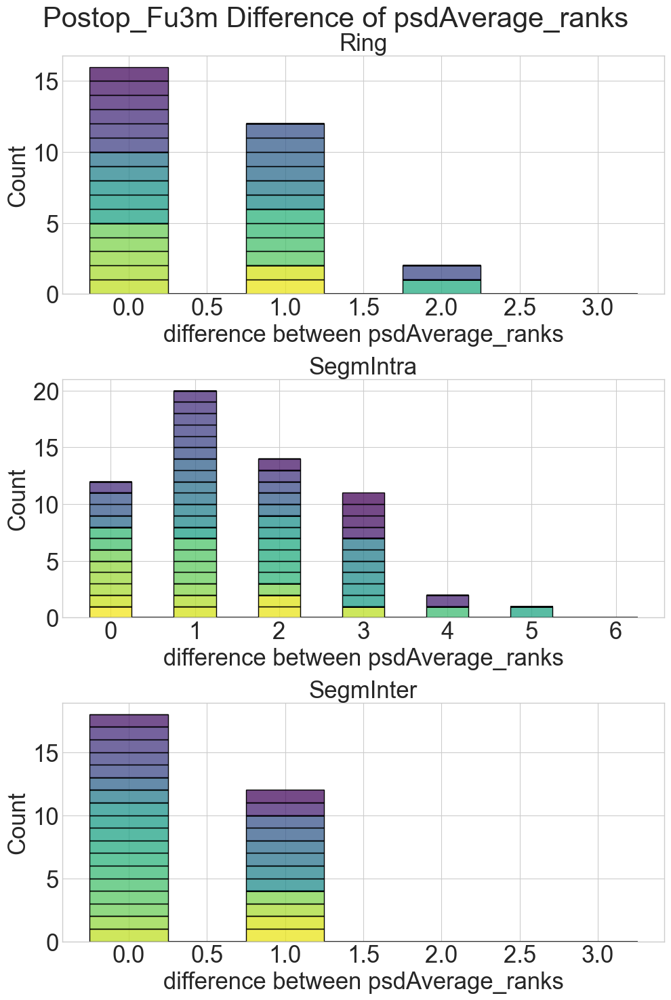

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


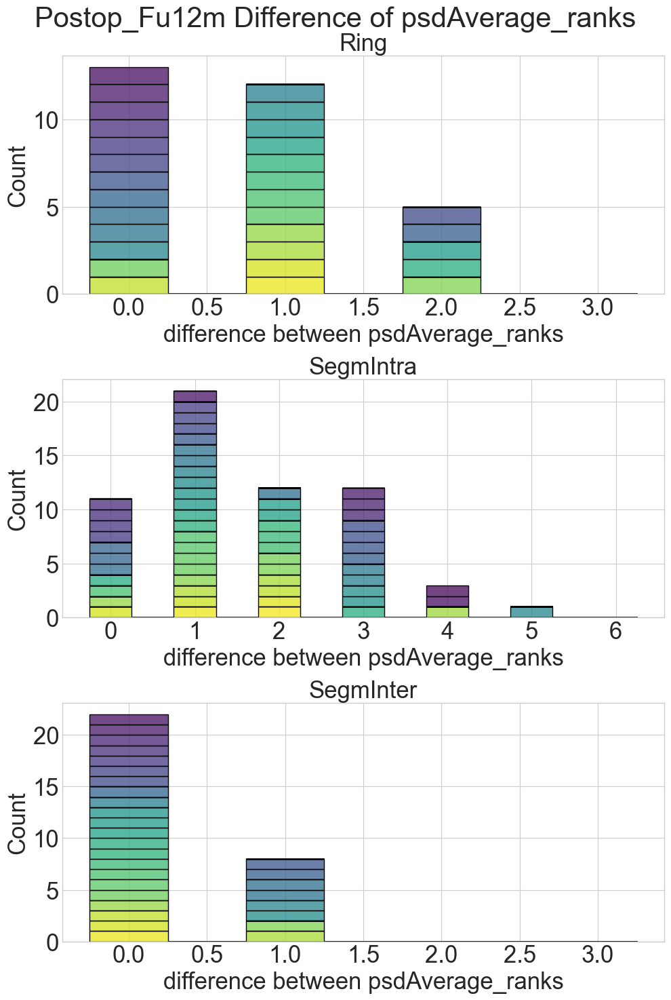

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


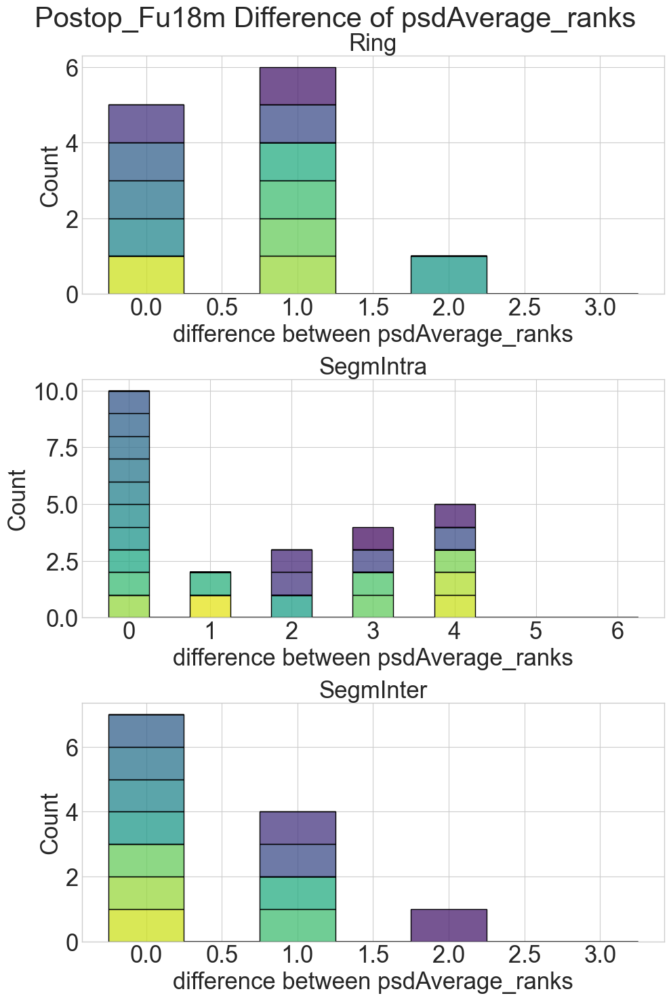

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


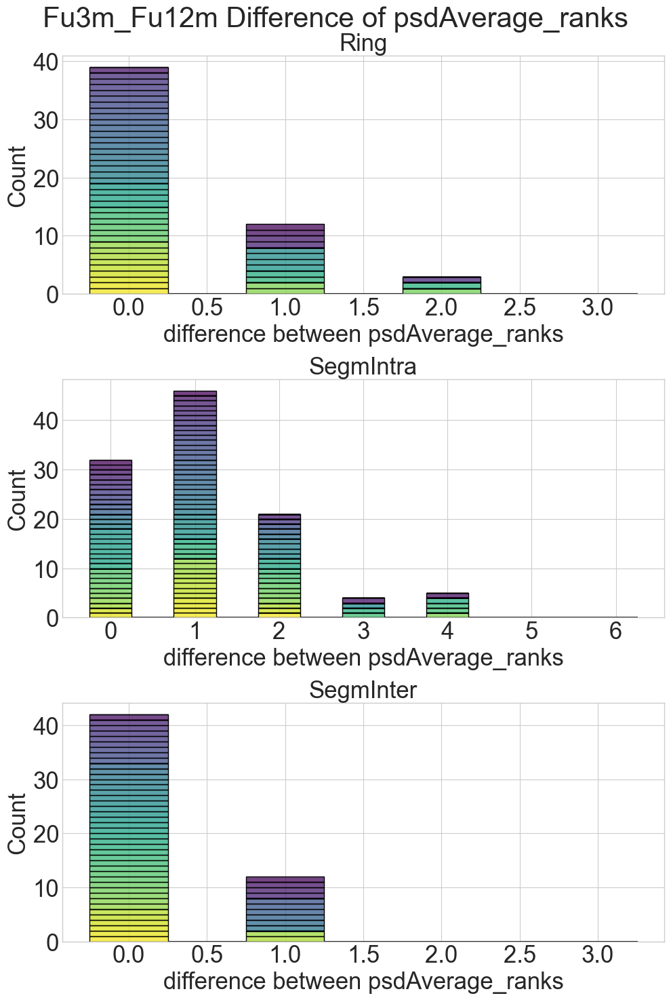

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


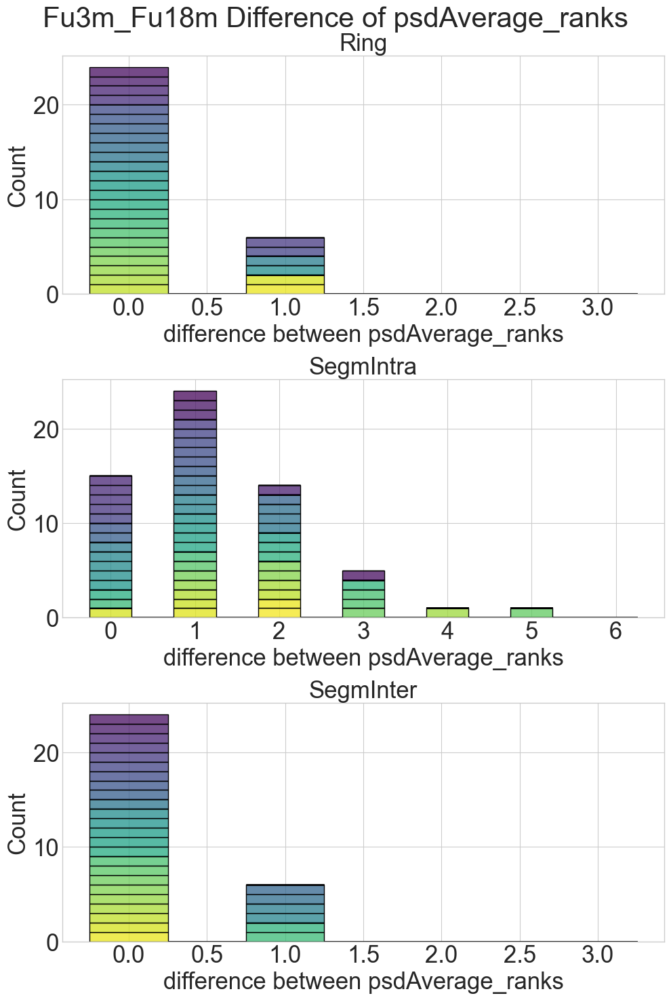

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


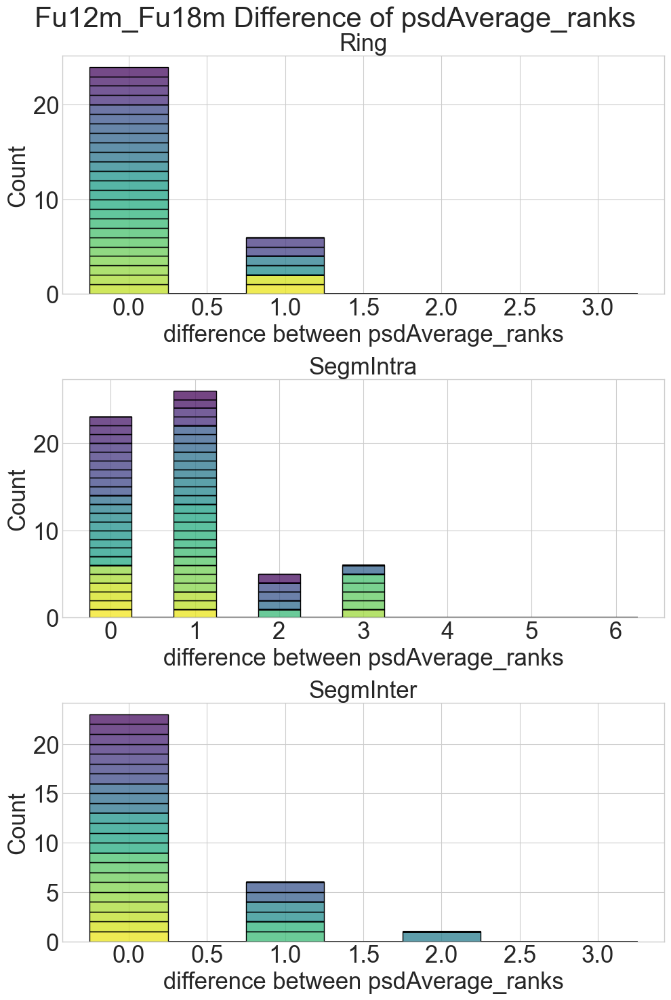

In [17]:
data = BIP_ranks.BIPranks_plotDifferenceBetweenSessions(
     data2plot="psdAverage_ranks",
     filterSignal="band-pass",
     normalization="rawPsd",
     freqBand="beta",
)

## 8. Permutation analysis of BIP beta PSD rank differences

Automatized method for permutation analysis: PermutationTest_BIPchannelGroups()

pickle file loaded:  BIPpermutationDF_Postop_Postop_psdAverage_highBeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Postop_Fu3m_psdAverage_highBeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Postop_Fu12m_psdAverage_highBeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Postop_Fu18m_psdAverage_highBeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Fu3m_Postop_psdAverage_highBeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Fu3m_Fu3m_psdAverage_highBeta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file lo

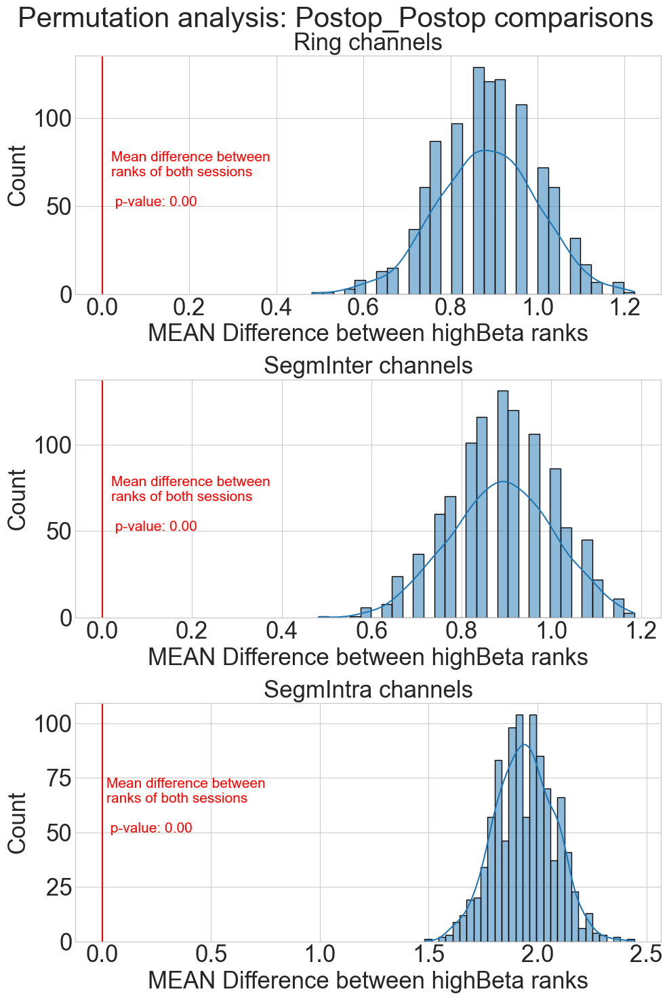

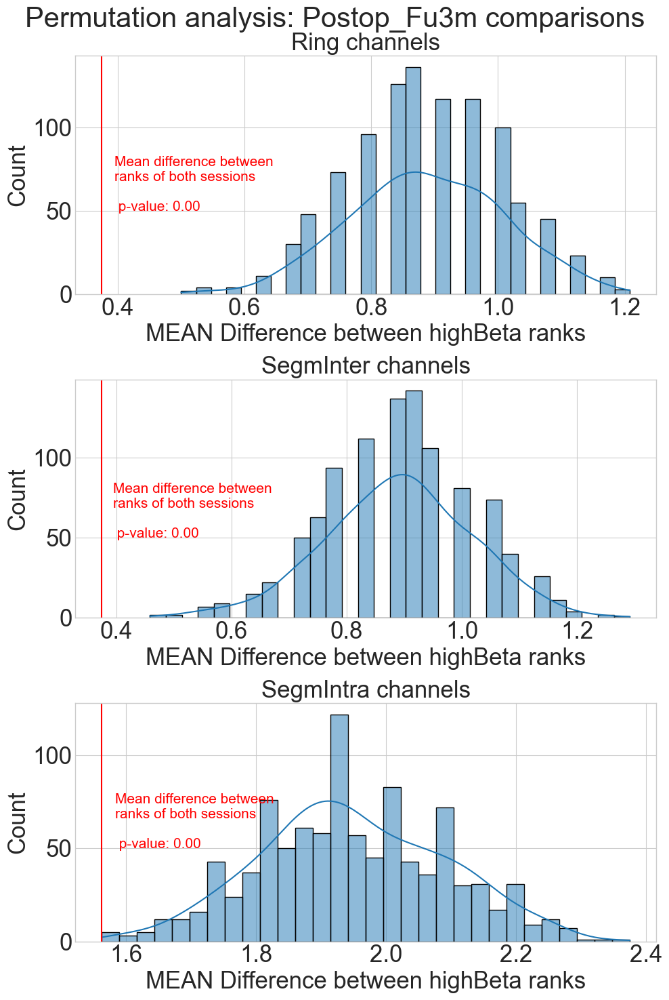

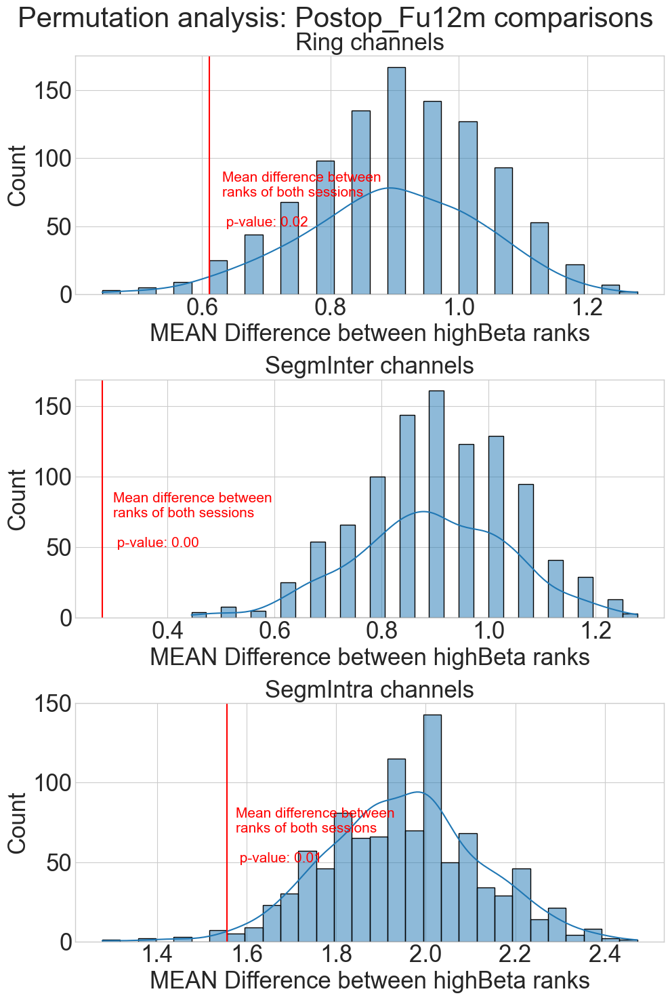

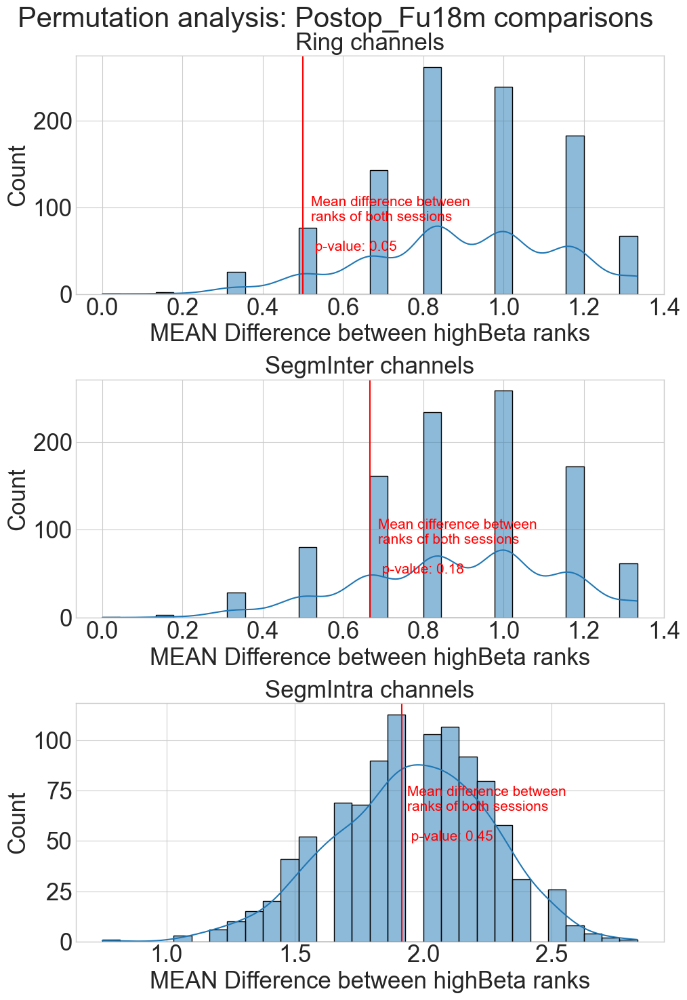

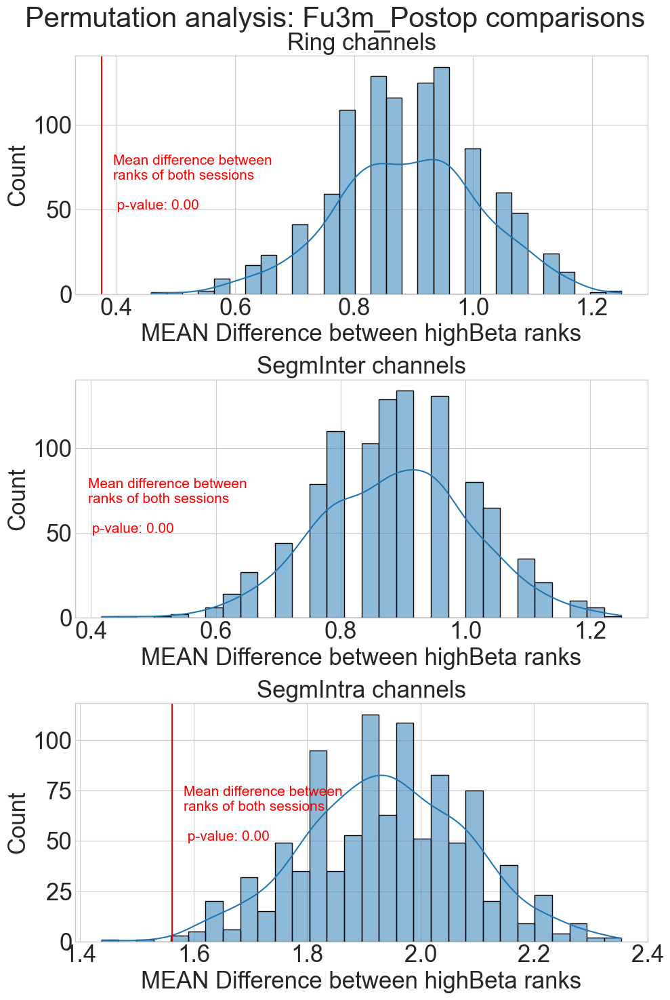

...

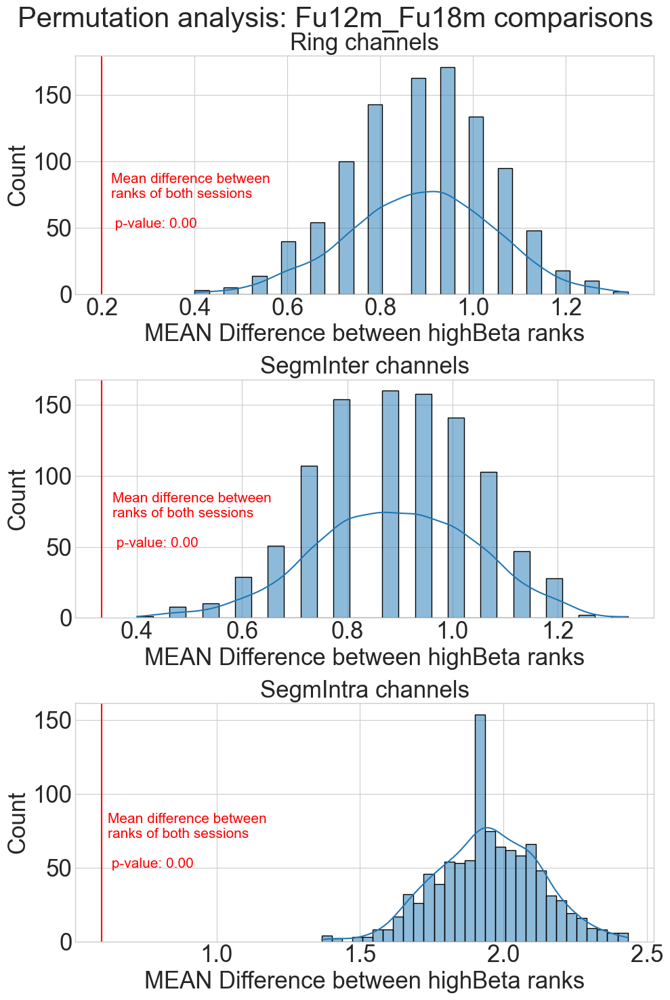

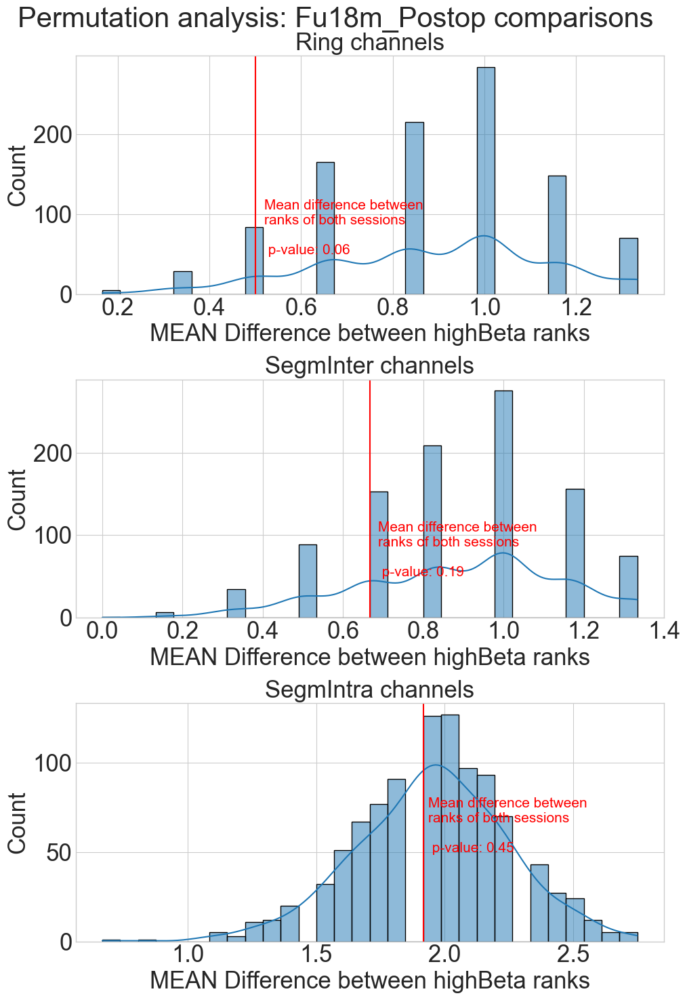

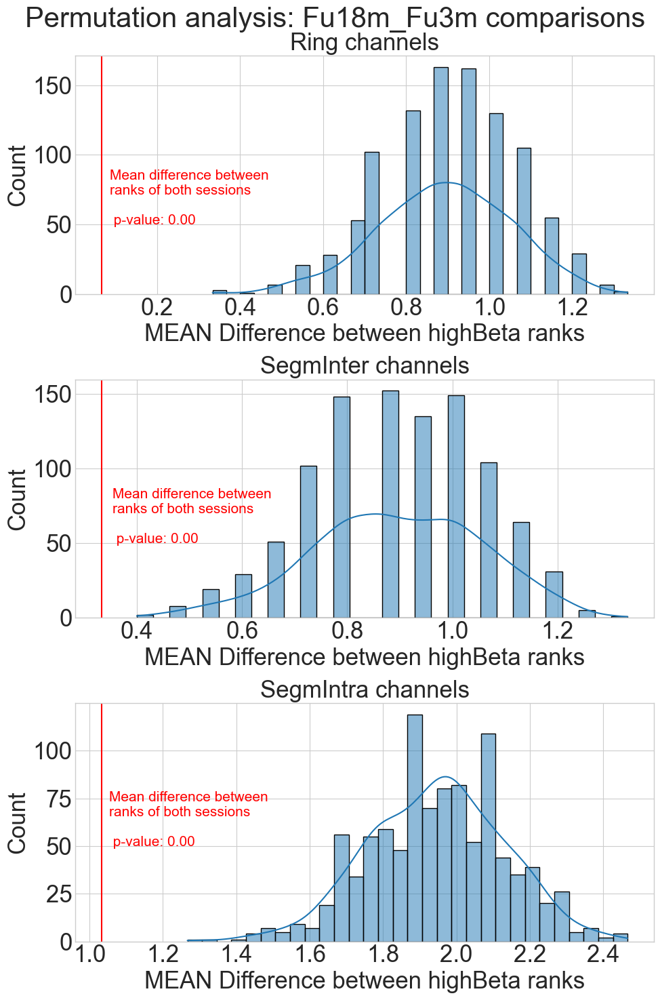

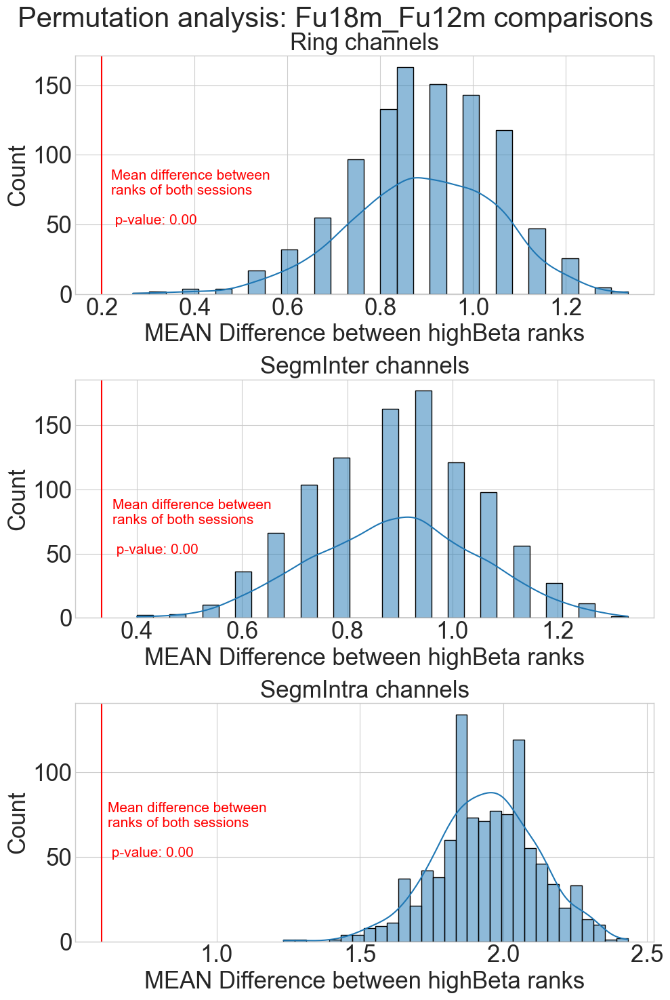

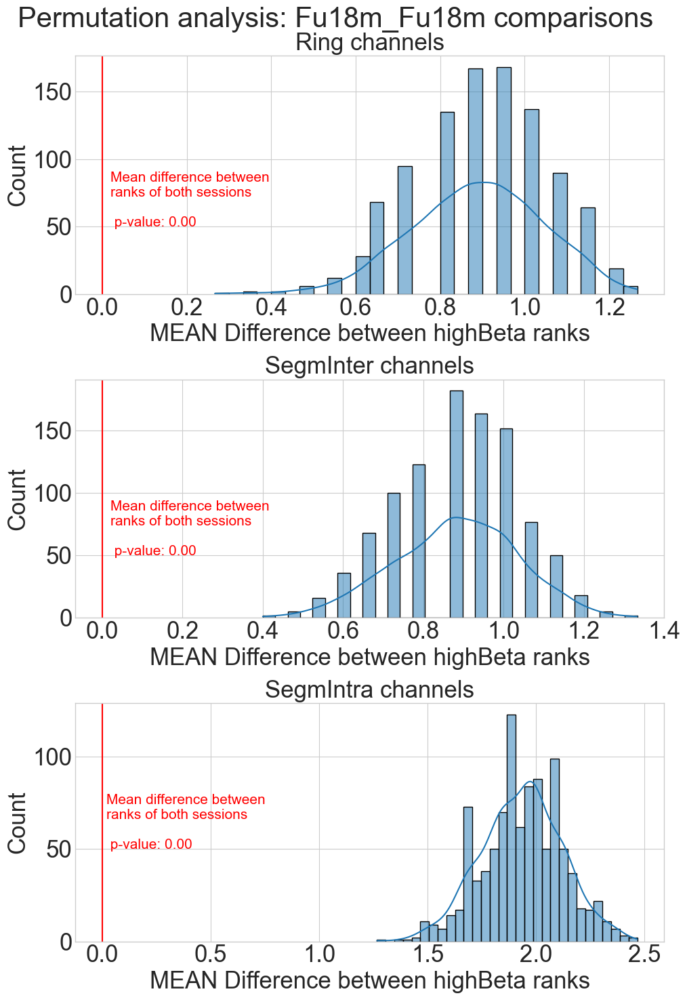

file:  Permutation_BIP_psdAverage_highBeta_rawPsd_band-pass.pickle 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [12]:
permute_BIP_ranks = Permute_ranks.PermutationTest_BIPchannelGroups(
    data2permute="psdAverage",
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="highBeta"
)

In [50]:
permute_BIP_ranks

,comparison,channelGroup,MEAN_differenceOfRanks,distanceMEANreal_MEANrandom,p-value
Postop_Fu3m_Ring,Postop_Fu3m,Ring,0.533333,-2.361115,0.009110047894956
Postop_Fu3m_SegmInter,Postop_Fu3m,SegmInter,0.4,-3.230518,0.000617830865347
Postop_Fu3m_SegmIntra,Postop_Fu3m,SegmIntra,1.566667,-2.110815,0.017394119495082
Fu3m_Fu12m_Ring,Fu3m_Fu12m,Ring,0.333333,-4.667152,0.000001527017144
Fu3m_Fu12m_SegmInter,Fu3m_Fu12m,SegmInter,0.222222,-5.837348,0.000000002651905
Fu3m_Fu12m_SegmIntra,Fu3m_Fu12m,SegmIntra,1.111111,-6.111487,0.000000000493536
Fu12m_Fu18m_Ring,Fu12m_Fu18m,Ring,0.2,-4.597307,0.000002139937712
Fu12m_Fu18m_SegmInter,Fu12m_Fu18m,SegmInter,0.266667,-4.010227,0.000030330189660
Fu12m_Fu18m_SegmIntra,Fu12m_Fu18m,SegmIntra,0.9,-5.663738,0.000000007405542
Postop_Fu12m_Ring,Postop_Fu12m,Ring,0.733333,-0.926466,0.177101880839787


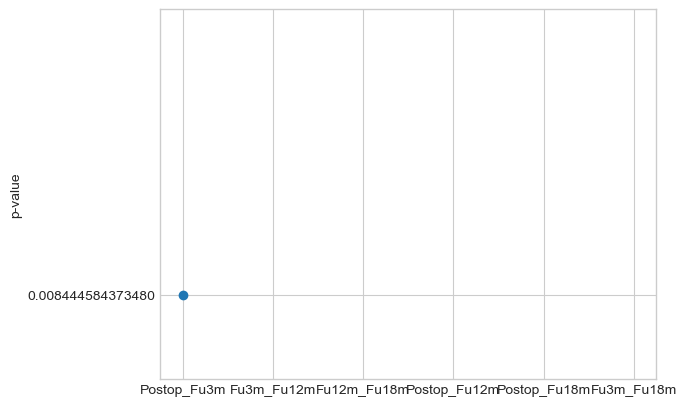

In [35]:
# plot p values of permutation test

Ring_comparisons = permute_BIP_ranks.loc[(permute_BIP_ranks.channelGroup=="Ring")]
SegmInter_comparisons = permute_BIP_ranks.loc[(permute_BIP_ranks.channelGroup=="SegmInter")]
SegmIntra_comparisons = permute_BIP_ranks.loc[(permute_BIP_ranks.channelGroup=="SegmIntra")]

fig=plt.figure()
plt.scatter(Ring_comparisons["comparison"], Ring_comparisons["p-value"])
plt.ylabel("p-value")
plt.ylim(-0.05, 0.17)

plt.show()




In [13]:
data = loadResults.load_BIPpermutationComparisonsPickle(
    result="psdAverage",
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta"
)

pickle file loaded:  BIPpermutationDF_Postop_Fu3m_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Fu3m_Fu12m_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Fu12m_Fu18m_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [12]:
postopFu3mRingData = data["Fu3m_Fu12m"]["Ring"]
postopFu3mRingData

,session_x,averagedPSD_x,rank_x,sub_hem_BIPchannel,session_y,averagedPSD_y,rank_y,Difference_rank_x_y,Difference_psdAverage_x_y
0,fu3m,0.298595,2.0,017_Right_BIP_12,fu12m,0.189567,3.0,1.0,0.109028
1,fu3m,0.131716,3.0,017_Right_BIP_01,fu12m,0.242426,2.0,1.0,0.110709
2,fu3m,0.299057,1.0,017_Right_BIP_23,fu12m,0.788483,1.0,0.0,0.489426
3,fu3m,0.095521,3.0,017_Left_BIP_12,fu12m,0.221342,2.0,1.0,0.125821
4,fu3m,0.114322,2.0,017_Left_BIP_01,fu12m,0.227817,1.0,1.0,0.113495
5,fu3m,0.185730,1.0,017_Left_BIP_23,fu12m,0.107519,3.0,2.0,0.078211
6,fu3m,0.204038,2.0,019_Right_BIP_12,fu12m,0.164022,2.0,0.0,0.040016
7,fu3m,1.307793,1.0,019_Right_BIP_01,fu12m,0.732712,1.0,0.0,0.575081
8,fu3m,0.129959,3.0,019_Right_BIP_23,fu12m,0.101797,3.0,0.0,0.028162
9,fu3m,0.589013,1.0,019_Left_BIP_12,fu12m,0.488644,1.0,0.0,0.100370


In [16]:
# use function Permutation_BIPranksRingSegmGroups to restructure the Dataframes with the rankings and create comparison Dataframes 

Permutation_dict = BIP_ranks.Permutation_BIPranksRingSegmGroups(
    result="psdAverage",
    difference="rank",
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta"
)

pickle file loaded:  BIPranksChannelGroup_session_dict_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
files:  
BIPpermutationDF_Postop_Fu3m_psdAverage_beta_rawPsd_band-pass.pickle 
BIPpermutationDF_Fu3m_Fu12m_psdAverage_beta_rawPsd_band-pass.pickle 
BIPpermutationDF_Fu12m_Fu18m_psdAverage_beta_rawPsd_band-pass.pickle 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [12]:
Permutation_file = loadResults.load_BIPpermutationComparisonsPickle(
    result="psdAverage",
    freqBand="beta",
    normalization="rawPsd",
    filterSignal="band-pass"

)

pickle file loaded:  BIPpermutationDF_Postop_Fu3m_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Fu3m_Fu12m_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
pickle file loaded:  BIPpermutationDF_Fu12m_Fu18m_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [13]:
Permutation_file["Fu3m_Fu12m"]["SegmInter"]

,session_x,averagedPSD_x,rank_x,sub_hem_BIPchannel,session_y,averagedPSD_y,rank_y,Difference_rank_x_y,Difference_psdAverage_x_y
0,fu3m,0.466398,1.0,017_Right_BIP_1A2A,fu12m,0.277751,2.0,1.0,0.188647
1,fu3m,0.273434,3.0,017_Right_BIP_1B2B,fu12m,0.199223,3.0,0.0,0.074211
2,fu3m,0.302411,2.0,017_Right_BIP_1C2C,fu12m,0.294572,1.0,1.0,0.007839
3,fu3m,0.246779,1.0,017_Left_BIP_1A2A,fu12m,0.447300,2.0,1.0,0.200520
4,fu3m,0.118271,2.0,017_Left_BIP_1B2B,fu12m,0.524689,1.0,1.0,0.406417
5,fu3m,0.108646,3.0,017_Left_BIP_1C2C,fu12m,0.192783,3.0,0.0,0.084137
6,fu3m,0.320621,1.0,019_Right_BIP_1A2A,fu12m,0.492338,1.0,0.0,0.171717
7,fu3m,0.254946,3.0,019_Right_BIP_1B2B,fu12m,0.241863,3.0,0.0,0.013083
8,fu3m,0.300203,2.0,019_Right_BIP_1C2C,fu12m,0.345371,2.0,0.0,0.045168
9,fu3m,1.214453,1.0,019_Left_BIP_1A2A,fu12m,1.735954,1.0,0.0,0.521501


In [17]:
Permutation_keys = Permutation_dict["mean_differenceOfComparison"].keys()

meanDiff_rank_keys = [i for i in Permutation_keys if "rank" in i]
meanDiff_rank_keys

['meanDiff_rank_Ring_comparePostop_Fu3m',
 'meanDiff_rank_Ring_compareFu3m_Fu12m',
 'meanDiff_rank_Ring_compareFu12m_Fu18m',
 'meanDiff_rank_SegmInter_comparePostop_Fu3m',
 'meanDiff_rank_SegmInter_compareFu3m_Fu12m',
 'meanDiff_rank_SegmInter_compareFu12m_Fu18m',
 'meanDiff_rank_SegmIntra_comparePostop_Fu3m',
 'meanDiff_rank_SegmIntra_compareFu3m_Fu12m',
 'meanDiff_rank_SegmIntra_compareFu12m_Fu18m']

In [18]:
meanpostop_fu3m = Permutation_dict["mean_differenceOfComparison"]["meanDiff_rank_SegmIntra_compareFu12m_Fu18m"]
meanpostop_fu3m

0.9

In [19]:
comparePostop_3Ring = Permutation_dict["compareFu12m_Fu18m"]["SegmIntra"]
comparePostop_3Ring

,session_x,averagedPSD_x,rank_x,sub_hem_BIPchannel,session_y,averagedPSD_y,rank_y,Difference_rank_x_y,Difference_psdAverage_x_y
0,fu12m,0.174445,1.0,019_Right_BIP_1A1B,fu18m,0.175480,2.0,1.0,0.001036
1,fu12m,0.140080,3.0,019_Right_BIP_1B1C,fu18m,0.186217,1.0,2.0,0.046136
2,fu12m,0.152700,2.0,019_Right_BIP_1A1C,fu18m,0.132350,3.0,1.0,0.020350
3,fu12m,0.122197,4.0,019_Right_BIP_2A2B,fu18m,0.082339,4.0,0.0,0.039857
4,fu12m,0.117997,5.0,019_Right_BIP_2B2C,fu18m,0.072668,5.0,0.0,0.045329
5,fu12m,0.100595,6.0,019_Right_BIP_2A2C,fu18m,0.063194,6.0,0.0,0.037401
6,fu12m,0.776845,2.0,019_Left_BIP_1A1B,fu18m,0.132196,3.0,1.0,0.644649
7,fu12m,0.452674,3.0,019_Left_BIP_1B1C,fu18m,0.194447,2.0,1.0,0.258228
8,fu12m,1.567461,1.0,019_Left_BIP_1A1C,fu18m,0.286516,1.0,0.0,1.280945
9,fu12m,0.171794,5.0,019_Left_BIP_2A2B,fu18m,0.098432,5.0,0.0,0.073362


In [20]:
rank_x = list(comparePostop_3Ring.rank_x.values)

np.random.shuffle(rank_x)

rank_x


[2.0,
 4.0,
 4.0,
 3.0,
 3.0,
 2.0,
 3.0,
 1.0,
 6.0,
 3.0,
 5.0,
 6.0,
 4.0,
 4.0,
 5.0,
 6.0,
 5.0,
 1.0,
 5.0,
 4.0,
 1.0,
 3.0,
 3.0,
 2.0,
 5.0,
 3.0,
 1.0,
 4.0,
 2.0,
 6.0,
 2.0,
 2.0,
 6.0,
 3.0,
 5.0,
 6.0,
 6.0,
 1.0,
 6.0,
 2.0,
 1.0,
 1.0,
 2.0,
 4.0,
 3.0,
 1.0,
 6.0,
 1.0,
 6.0,
 5.0,
 5.0,
 4.0,
 3.0,
 4.0,
 2.0,
 5.0,
 5.0,
 1.0,
 4.0,
 2.0]

DISTANCE MEAN to MEAN:  -6.151017927340094


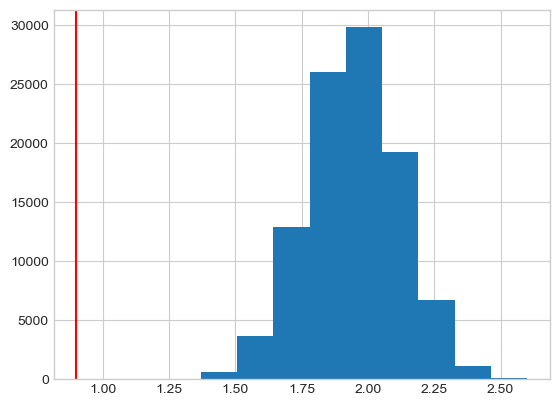

In [21]:
numberOfShuffle = np.arange(1, 100001, 1)

rank_x = list(comparePostop_3Ring.rank_x.values)
rank_y = list(comparePostop_3Ring.rank_y.values)

difference_random_ranks = []

for s, shuffle in enumerate(numberOfShuffle):

    np.random.shuffle(rank_x)
    np.random.shuffle(rank_y)

    difference_random_ranks.append(np.mean(abs(np.array(rank_x) - np.array(rank_y))))





plt.hist(difference_random_ranks)
plt.axvline(meanpostop_fu3m, c="r")


print("DISTANCE MEAN to MEAN: ", (meanpostop_fu3m - np.mean(difference_random_ranks)) / np.std(difference_random_ranks))


# result = distance of meanpostop_fu3m from mean of random results from standard deviation

#np.array(random_rank_x[0]) - np.array(random_rank_y[0])

In [134]:
np.mean(difference_random_ranks) / np.std(difference_random_ranks)

0.9

In [99]:
from scipy.stats import norm

# pval = 2-2*norm.cdf(abs(-5.956138775641999))
pval = 1-norm.cdf(abs(-2.779036995753313))
pval

0.0027260157662702955

In [84]:
permute_BIP_ranks

,comparison,channelGroup,MEAN_differenceOfRanks,distanceMEANreal_MEANrandom,p-value
Postop_Fu3m_Ring,Postop_Fu3m,Ring,0.533333,-6.20953,0.0
Postop_Fu3m_SegmInter,Postop_Fu3m,SegmInter,0.4,-6.439676,0.0
Postop_Fu3m_SegmIntra,Postop_Fu3m,SegmIntra,1.566667,-9.930203,0.0
Fu3m_Fu12m_Ring,Fu3m_Fu12m,Ring,0.333333,-8.900137,0.0
Fu3m_Fu12m_SegmInter,Fu3m_Fu12m,SegmInter,0.222222,-8.81888,0.0
Fu3m_Fu12m_SegmIntra,Fu3m_Fu12m,SegmIntra,1.111111,-14.228252,0.0
Fu12m_Fu18m_Ring,Fu12m_Fu18m,Ring,0.2,-6.609579,0.0
Fu12m_Fu18m_SegmInter,Fu12m_Fu18m,SegmInter,0.266667,-6.513051,0.0
Fu12m_Fu18m_SegmIntra,Fu12m_Fu18m,SegmIntra,0.9,-10.555045,0.0


In [62]:
Permutation_dictionary = loadResults.load_BIPchannelGroup_sessionPickle(
    result="psdAverage",
    freqBand="beta",
    normalization="rawPsd",
    filterSignal="band-pass"
)

pickle file loaded:  BIPranksChannelGroup_session_dict_psdAverage_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [63]:
Permutation_keys = Permutation_dictionary.keys()

In [64]:
Ring_keys = [i for i in Permutation_keys if "Ring" in i]
Ring_keys

['Ring_postop', 'Ring_fu3m', 'Ring_fu12m', 'Ring_fu18m']

In [422]:
Ringdf_postop = Permutation_dictionary[Ring_keys[0]]
Ringdf_fu3m = Permutation_dictionary[Ring_keys[1]]
Ringdf_fu12m = Permutation_dictionary[Ring_keys[2]]
Ringdf_fu18m = Permutation_dictionary[Ring_keys[3]]


In [423]:
Ringdf_postop.head()

,session,bipolarChannel,frequencyBand,absoluteOrRelativePSD,averagedPSD,rank,subject_hemisphere
0,postop,LFP_R_12_STN_MT,beta,rawPsd,0.027022,2.0,024_Right
1,postop,LFP_R_01_STN_MT,beta,rawPsd,0.275318,1.0,024_Right
2,postop,LFP_R_23_STN_MT,beta,rawPsd,0.020856,3.0,024_Right
3,postop,LFP_L_12_STN_MT,beta,rawPsd,0.104155,1.0,024_Left
4,postop,LFP_L_01_STN_MT,beta,rawPsd,0.050440,2.0,024_Left


In [409]:
#problem!! not all channel names are the same: therefor exchange each by structure "BIP_03"

Ring = ["12", "01", "23"]

for chan in Ring:
    Ringdf_postop.loc[Ringdf_postop.bipolarChannel.str.contains(chan), "bipolarChannel"] = f"BIP_{chan}"
    Ringdf_fu3m.loc[Ringdf_fu3m.bipolarChannel.str.contains(chan), "bipolarChannel"] = f"BIP_{chan}"
    Ringdf_fu12m.loc[Ringdf_fu12m.bipolarChannel.str.contains(chan), "bipolarChannel"] = f"BIP_{chan}"
    Ringdf_fu18m.loc[Ringdf_fu18m.bipolarChannel.str.contains(chan), "bipolarChannel"] = f"BIP_{chan}"



AttributeError: 'NoneType' object has no attribute 'loc'

In [407]:
Ringdf_postop["sub_hem_BIPchannel"] = Ringdf_postop[['subject_hemisphere', 'bipolarChannel']].agg('_'.join, axis=1)

Ringdf_postop = Ringdf_postop.drop(columns=["frequencyBand", "absoluteOrRelativePSD", "averagedPSD", "subject_hemisphere", "bipolarChannel"], inplace=True)
Ringdf_postop.head()

AttributeError: 'NoneType' object has no attribute 'head'

In [408]:
Ringdf_fu3m["sub_hem_BIPchannel"] = Ringdf_fu3m[['subject_hemisphere', 'bipolarChannel']].agg('_'.join, axis=1)

permute_Ring_fu3m = Ringdf_fu3m.drop(columns=["frequencyBand", "absoluteOrRelativePSD", "averagedPSD", "subject_hemisphere", "bipolarChannel"])
permute_Ring_fu3m.head()

,session,rank,sub_hem_BIPchannel
0,fu3m,2.0,017_Right_BIP_12
1,fu3m,3.0,017_Right_BIP_01
2,fu3m,1.0,017_Right_BIP_23
3,fu3m,3.0,017_Left_BIP_12
4,fu3m,2.0,017_Left_BIP_01


In [369]:
Ringdf_fu12m["sub_hem_BIPchannel"] = Ringdf_fu12m[['subject_hemisphere', 'bipolarChannel']].agg('_'.join, axis=1)

permute_Ring_fu12m = Ringdf_fu12m.drop(columns=["frequencyBand", "absoluteOrRelativePSD", "averagedPSD", "subject_hemisphere", "bipolarChannel"])
permute_Ring_fu12m.head()

,session,rank,sub_hem_BIPchannel
0,fu12m,3.0,017_Right_BIP_12
1,fu12m,2.0,017_Right_BIP_01
2,fu12m,1.0,017_Right_BIP_23
3,fu12m,2.0,017_Left_BIP_12
4,fu12m,1.0,017_Left_BIP_01


In [383]:
Ringdf_fu18m["sub_hem_BIPchannel"] = Ringdf_fu18m[['subject_hemisphere', 'bipolarChannel']].agg('_'.join, axis=1)

permute_Ring_fu18m = Ringdf_fu18m.drop(columns=["frequencyBand", "absoluteOrRelativePSD", "averagedPSD", "subject_hemisphere", "bipolarChannel"])
permute_Ring_fu18m.head()

,session,rank,sub_hem_BIPchannel
0,fu18m,2.0,019_Right_BIP_12
1,fu18m,1.0,019_Right_BIP_01
2,fu18m,3.0,019_Right_BIP_23
3,fu18m,1.0,019_Left_BIP_12
4,fu18m,3.0,019_Left_BIP_01


In [374]:
mergepostop_3 = permute_Ring_postop.merge(permute_Ring_fu3m, left_on='sub_hem_BIPchannel', right_on='sub_hem_BIPchannel')
mergepostop_3

,session_x,rank_x,sub_hem_BIPchannel,session_y,rank_y
0,postop,2.0,024_Right_BIP_12,fu3m,2.0
1,postop,1.0,024_Right_BIP_01,fu3m,1.0
2,postop,3.0,024_Right_BIP_23,fu3m,3.0
3,postop,1.0,024_Left_BIP_12,fu3m,1.0
4,postop,2.0,024_Left_BIP_01,fu3m,2.0
5,postop,3.0,024_Left_BIP_23,fu3m,3.0
6,postop,1.0,025_Right_BIP_12,fu3m,3.0
7,postop,2.0,025_Right_BIP_01,fu3m,1.0
8,postop,3.0,025_Right_BIP_23,fu3m,2.0
9,postop,1.0,025_Left_BIP_12,fu3m,2.0


In [258]:
concat_DF = pd.concat([df_postop, df_fu3m, df_fu12m, df_fu18m], ignore_index=True)
concat_DF.drop(columns=["frequencyBand", "absoluteOrRelativePSD", "averagedPSD"])

,session,bipolarChannel,rank,subject_hemisphere
0,postop,LFP_R_12_STN_MT,2.0,024_Right
1,postop,LFP_R_01_STN_MT,1.0,024_Right
2,postop,LFP_R_23_STN_MT,3.0,024_Right
3,postop,LFP_L_12_STN_MT,1.0,024_Left
4,postop,LFP_L_01_STN_MT,2.0,024_Left
...,...,...,...,...
163,fu18m,LFP_R_01_STN_MT,3.0,033_Right
164,fu18m,LFP_R_23_STN_MT,1.0,033_Right
165,fu18m,LFP_L_12_STN_MT,1.0,033_Left
166,fu18m,LFP_L_01_STN_MT,2.0,033_Left


In [244]:
merged_dffu3m12m = pd.merge(df_fu3m, df_fu12m, on="subject_hemisphere", how="outer", indicator=True)

merged_dffu3m12m

,session_x,bipolarChannel_x,frequencyBand_x,absoluteOrRelativePSD_x,averagedPSD_x,rank_x,subject_hemisphere,session_y,bipolarChannel_y,frequencyBand_y,absoluteOrRelativePSD_y,averagedPSD_y,rank_y,_merge
0,fu3m,LFP_R_12_STN_MT,beta,rawPsd,0.298595,2.0,017_Right,fu12m,LFP_R_12_STN,beta,rawPsd,0.189567,3.0,both
1,fu3m,LFP_R_12_STN_MT,beta,rawPsd,0.298595,2.0,017_Right,fu12m,LFP_R_01_STN,beta,rawPsd,0.242426,2.0,both
2,fu3m,LFP_R_12_STN_MT,beta,rawPsd,0.298595,2.0,017_Right,fu12m,LFP_R_23_STN,beta,rawPsd,0.788483,1.0,both
3,fu3m,LFP_R_01_STN_MT,beta,rawPsd,0.131716,3.0,017_Right,fu12m,LFP_R_12_STN,beta,rawPsd,0.189567,3.0,both
4,fu3m,LFP_R_01_STN_MT,beta,rawPsd,0.131716,3.0,017_Right,fu12m,LFP_R_01_STN,beta,rawPsd,0.242426,2.0,both
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
157,fu3m,LFP_L_01_STN_MT,beta,rawPsd,0.825278,3.0,033_Left,fu12m,LFP_L_01_STN_MT,beta,rawPsd,0.387630,3.0,both
158,fu3m,LFP_L_01_STN_MT,beta,rawPsd,0.825278,3.0,033_Left,fu12m,LFP_L_23_STN_MT,beta,rawPsd,0.419091,2.0,both
159,fu3m,LFP_L_23_STN_MT,beta,rawPsd,0.917281,2.0,033_Left,fu12m,LFP_L_12_STN_MT,beta,rawPsd,1.031138,1.0,both
160,fu3m,LFP_L_23_STN_MT,beta,rawPsd,0.917281,2.0,033_Left,fu12m,LFP_L_01_STN_MT,beta,rawPsd,0.387630,3.0,both


## 8. Heatmap of distances from real Mean of difference to random Mean of difference of all session comparisons

In [18]:
heatmap_permutation_distances = Permute_ranks.heatmap_distances_to_permutated_mean(
    data2permute="psdAverage",
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="lowBeta"
)

In [64]:
permutation_results = loadResults.load_BIPpermutation_ranks_result(
    data2permute="psdAverage",
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta"
)

In [65]:
permutation_results

,comparison,channelGroup,MEAN_differenceOfRanks,distanceMEANreal_MEANrandom,p-value
Postop_Postop_Ring,Postop_Postop,Ring,0.0,-5.560814,0.000000013425985
Postop_Postop_SegmInter,Postop_Postop,SegmInter,0.0,-5.698809,0.000000006032364
Postop_Postop_SegmIntra,Postop_Postop,SegmIntra,0.0,-9.935757,0.000000000000000
Postop_Fu3m_Ring,Postop_Fu3m,Ring,0.533333,-2.151105,0.015733955976777
Postop_Fu3m_SegmInter,Postop_Fu3m,SegmInter,0.4,-3.280348,0.000518396075470
Postop_Fu3m_SegmIntra,Postop_Fu3m,SegmIntra,1.566667,-2.082225,0.018660957367470
Postop_Fu12m_Ring,Postop_Fu12m,Ring,0.733333,-0.962442,0.167913805683052
Postop_Fu12m_SegmInter,Postop_Fu12m,SegmInter,0.266667,-4.103181,0.000020375403819
Postop_Fu12m_SegmIntra,Postop_Fu12m,SegmIntra,1.633333,-1.717616,0.042933320921330
Postop_Fu18m_Ring,Postop_Fu18m,Ring,0.666667,-0.885872,0.187843123108600


In [66]:
sessions = ["postop", "fu3m", "fu12m", "fu18m"]
pairs = list(itertools.product(sessions, sessions))
pairs

[('postop', 'postop'),
 ('postop', 'fu3m'),
 ('postop', 'fu12m'),
 ('postop', 'fu18m'),
 ('fu3m', 'postop'),
 ('fu3m', 'fu3m'),
 ('fu3m', 'fu12m'),
 ('fu3m', 'fu18m'),
 ('fu12m', 'postop'),
 ('fu12m', 'fu3m'),
 ('fu12m', 'fu12m'),
 ('fu12m', 'fu18m'),
 ('fu18m', 'postop'),
 ('fu18m', 'fu3m'),
 ('fu18m', 'fu12m'),
 ('fu18m', 'fu18m')]

In [69]:
# restructure the dataframe for a heatmap
# filter for each channel group

figures_path = find_folders.get_local_path(folder="GroupFigures")

channel_group = ["Ring", "SegmInter", "SegmIntra"]

for group in channel_group:

    group_df = permutation_results.loc[permutation_results.channelGroup==group]

    distance_to_plot = group_df.distanceMEANreal_MEANrandom.values.astype(float)
    distance_to_plot = distance_to_plot.reshape(4,4)

    fig = px.imshow(distance_to_plot,
                    labels=dict(x="session 1", y="session 2", color=f"distance between real and permutated mean differences"),
                    x=['postop', 'fu3m', 'fu12m', 'fu18m'],
                    y=['postop', 'fu3m', 'fu12m', 'fu18m'],
                    title=f"{group} channel group",
                    text_auto=True)
    fig.update_xaxes(side="top")
    fig.update_layout(title={
        'y':0.98,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
    plt.tight_layout()
    fig.show()

 



In [47]:
distance_to_plot

array([-2.38911165, -4.87182526, -4.40476519, -1.02574568, -0.96257217,
       -4.30838344])

In [ ]:
# Plot a Heatmap for all session comparisons, 
# colorcode for distances from Mean of difference between beta ranks and the permutated Mean of differences



## 8.a Beta distribution over contacts: which distribution is stronger correlated with distribution of 12MFU and longterm follow ups? POSTOP OR 3MFU?

First correlate in bipolar recording groups (Ring, SegmInter and SegmIntra)_ try Pearson, Spearman and distance correlation

In [ ]:
# load the beta psd 

Second correlate the estimated monopolar PSD values normalized to the higheest Beta within an electrode: correlate all session combinations (postop vs fu3m, ...)

In [32]:
# automatized method to plot heatmap of spearman correlation between sessions
monopol_spearman_correl = groupMonopol.monopol_psd_correlations_sessions(
    freqBand="beta",
    ranks_or_relPsd="relPsd",
    mean_or_median="median"
)


pickle file loaded:  GroupMonopolar_weightedPsdCoordinateDistance_relToRank1_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [15]:
monopol_spearman_correl["spearman_m_df"]

,session_1,session_2,mean_spearmanr,mean_pval
postop_postop_spearman_m,postop,postop,1.0,0.0
postop_fu3m_spearman_m,postop,fu3m,0.575893,0.252464
postop_fu12m_spearman_m,postop,fu12m,0.640873,0.125557
postop_fu18m_spearman_m,postop,fu18m,0.797619,0.020716
fu3m_postop_spearman_m,fu3m,postop,0.575893,0.252464
fu3m_fu3m_spearman_m,fu3m,fu3m,1.0,0.0
fu3m_fu12m_spearman_m,fu3m,fu12m,0.771164,0.093812
fu3m_fu18m_spearman_m,fu3m,fu18m,0.797619,0.095895
fu12m_postop_spearman_m,fu12m,postop,0.640873,0.125557
fu12m_fu3m_spearman_m,fu12m,fu3m,0.771164,0.093812


In [11]:
# load the monolopar beta psd for for each electrode at different timepoints
data_weightedByCoordinates = loadResults.load_GroupMonoRef_weightedPsdCoordinateDistance_pickle(
    freqBand="beta",
    normalization="rawPsd",
    filterSignal="band-pass"

)

pickle file loaded:  GroupMonopolar_weightedPsdCoordinateDistance_relToRank1_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [12]:
data_weightedByCoordinates.head()

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank,relativePSD_to_beta_Rank1
0,0,0.0+0.0j,0.00+0.00j,017_Right,fu3m,0.206574,10.0,0.783786
1,1,2.0+0.0j,0.00+0.00j,017_Right,fu3m,0.242470,7.0,0.919984
2,2,4.0+0.0j,0.00+0.00j,017_Right,fu3m,0.254409,4.0,0.965286
3,3,6.0+0.0j,0.00+0.00j,017_Right,fu3m,0.263559,1.0,1.000000
4,1A,2.0+0.0j,0.65+0.00j,017_Right,fu3m,0.242557,6.0,0.920316


In [13]:
freqBand="beta"
normalization="rawPsd"
filterSignal="band-pass"

sessions = ["postop", "fu3m", "fu12m", "fu18m"]
contacts = ["0", "1A", "1B", "1C", "2A", "2B", "2C", "3"]

weightedByCoordinate_Dataframe = pd.DataFrame() # concat all Dataframes from all sub, hem, sessions


# first check, which STNs and sessions exist in data 
sub_hem_keys = list(data_weightedByCoordinates.subject_hemisphere.unique())

################## CHOOSE ONLY 8 CONTACTS AND RANK AGAIN ##################
for STN in sub_hem_keys:

    # select only one STN
    STN_data = data_weightedByCoordinates[data_weightedByCoordinates.subject_hemisphere == STN]


    for ses in sessions:

        # first check, if session exists in STN data
        if ses not in STN_data.session.values:
            continue

        
        # get the dataframe per session
        STN_session_data = STN_data[STN_data.session == ses]

        # choose only directional contacts and Ring contacts 0, 3 and rank again only the chosen contacts
        STN_session_data = STN_session_data[STN_session_data["contact"].isin(contacts)]
        STN_session_data["Rank8contacts"] = STN_session_data["averaged_monopolar_PSD_beta"].rank(ascending=False) # ranks 1-8
        STN_session_data_copy = STN_session_data.copy()
        STN_session_data_copy.drop(["rank"], axis=1, inplace=True)

        # calculate the relative PSD to the highest PSD of the 8 remaining contacts
        beta_rank_1 = STN_session_data_copy[STN_session_data_copy["Rank8contacts"] == 1.0] # taking the row containing 1.0 in rank
        beta_rank_1 = beta_rank_1[f"averaged_monopolar_PSD_{freqBand}"].values[0] # just taking psdAverage of rank 1.0

        STN_session_data_copy[f"relativePSD_to_{freqBand}_Rank1from8"] = STN_session_data_copy.apply(lambda row: row[f"averaged_monopolar_PSD_{freqBand}"] / beta_rank_1, axis=1) # in each row add to new value psd/beta_rank1
        STN_session_data_copy.drop([f"relativePSD_to_{freqBand}_Rank1"], axis=1, inplace=True)
        # session_weightedByCoordinates_copy["subject_hemisphere_monoChannel"] = session_weightedByCoordinates_copy[["subject_hemisphere", "monopolarChannels"]].agg("_".join, axis=1)
        

        weightedByCoordinate_Dataframe = pd.concat([weightedByCoordinate_Dataframe, STN_session_data_copy], ignore_index=True)



In [14]:
weightedByCoordinate_Dataframe.head()

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,relativePSD_to_beta_Rank1from8
0,0,0.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.206574,8.0,0.783786
1,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.263559,1.0,1.000000
2,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,5.0,0.920316
3,1B,2.0+0.0j,-0.325000+0.562917j,017_Right,fu3m,0.235433,7.0,0.893283
4,1C,2.0+0.0j,-0.325000-0.562917j,017_Right,fu3m,0.238925,6.0,0.906535


In [15]:
# get all possible pairs of sessions 
sessions = ["postop", "fu3m", "fu12m", "fu18m"]
# pairs = list(combinations(sessions, 2))
pairs = list(itertools.product(sessions, sessions))


# pairs[0][1]

sub_hem_keys = list(weightedByCoordinate_Dataframe.subject_hemisphere.unique()) # n=13 subjects

# divide Dataframe into 4 session dataframes
# postop_df = weightedByCoordinate_Dataframe.loc[(weightedByCoordinate_Dataframe.session == "postop")]
# fu3m_df = weightedByCoordinate_Dataframe.loc[(weightedByCoordinate_Dataframe.session == "fu3m")]
# fu12m_df = weightedByCoordinate_Dataframe.loc[(weightedByCoordinate_Dataframe.session == "fu12m")]
# fu18m_df = weightedByCoordinate_Dataframe.loc[(weightedByCoordinate_Dataframe.session == "fu18m")]

# from the list of all existing sub_hem STNs, get only the STNs with existing sessions 1 + 2 
session_pair_STNs = {}

# find session pairs to correlate: check for each pair if subject exists
for p, pair in enumerate(pairs):

    # define session 1 and session 2 to correlate
    session_1 = pair[0]
    session_2 = pair[1]

    session_1_df = weightedByCoordinate_Dataframe.loc[(weightedByCoordinate_Dataframe.session == session_1)]
    session_2_df = weightedByCoordinate_Dataframe.loc[(weightedByCoordinate_Dataframe.session == session_2)]

    for STN in sub_hem_keys:

        # only run, if sub_hem STN exists in both session Dataframes
        if STN not in session_1_df.subject_hemisphere.values:
            continue

        elif STN not in session_2_df.subject_hemisphere.values:
            continue
        
        # get the rows with the current STN of both sessions: 1 and 2
        STN_session_1 = session_1_df.loc[(session_1_df.subject_hemisphere == STN)]
        STN_session_2 = session_2_df.loc[(session_2_df.subject_hemisphere == STN)]

        # correlate the ranks of session 1 and session 2 of each STN 
        spearman_correlation = stats.spearmanr(STN_session_1.relativePSD_to_beta_Rank1from8.values, STN_session_2.relativePSD_to_beta_Rank1from8.values)


        session_pair_STNs[f"{session_1}_{session_2}_{STN}"] = [session_1, session_2, STN, spearman_correlation.statistic, spearman_correlation.pvalue]


In [16]:
results_DF = pd.DataFrame(session_pair_STNs)
results_DF.rename(index={0: "session_1", 1: "session_2", 2: "subject_hemisphere", 3: "spearman_r", 4: "pval"}, inplace=True)
results_DF = results_DF.transpose()

In [17]:
results_DF.head()

,session_1,session_2,subject_hemisphere,spearman_r,pval
postop_postop_024_Right,postop,postop,024_Right,1.0,0.0
postop_postop_024_Left,postop,postop,024_Left,1.0,0.0
postop_postop_025_Right,postop,postop,025_Right,1.0,0.0
postop_postop_025_Left,postop,postop,025_Left,1.0,0.0
postop_postop_026_Right,postop,postop,026_Right,1.0,0.0


In [18]:
# plot a heat map: x values = session 1 and y values = session 2; color map = r spearman values

spearman_mean = {}

# calculate the MEAN of each session pair
for p, pair in enumerate(pairs):

    # define session 1 and session 2 to correlate
    session_1 = pair[0]
    session_2 = pair[1]

    pairs_df = results_DF.loc[(results_DF.session_1 == session_1)]
    pairs_df = pairs_df.loc[(pairs_df.session_2 == session_2)]

    mean_spearmanr = pairs_df.spearman_r.mean() # take the absolute values
    mean_pval = pairs_df.pval.mean()

    spearman_mean[f"{session_1}_{session_2}_spearman_mean"] = [session_1, session_2, mean_spearmanr, mean_pval]

spearman_df = pd.DataFrame(spearman_mean)
spearman_df.rename(index={0: "session_1", 1: "session_2", 2: "mean_spearmanr", 3: "mean_pval"}, inplace=True)
spearman_df = spearman_df.transpose()

mean_spearmanr = spearman_df.mean_spearmanr.values.astype(float)



In [19]:
spearman_df

,session_1,session_2,mean_spearmanr,mean_pval
postop_postop_spearman_mean,postop,postop,1.0,0.0
postop_fu3m_spearman_mean,postop,fu3m,0.575893,0.252464
postop_fu12m_spearman_mean,postop,fu12m,0.640873,0.125557
postop_fu18m_spearman_mean,postop,fu18m,0.797619,0.020716
fu3m_postop_spearman_mean,fu3m,postop,0.575893,0.252464
fu3m_fu3m_spearman_mean,fu3m,fu3m,1.0,0.0
fu3m_fu12m_spearman_mean,fu3m,fu12m,0.771164,0.093812
fu3m_fu18m_spearman_mean,fu3m,fu18m,0.797619,0.095895
fu12m_postop_spearman_mean,fu12m,postop,0.640873,0.125557
fu12m_fu3m_spearman_mean,fu12m,fu3m,0.771164,0.093812


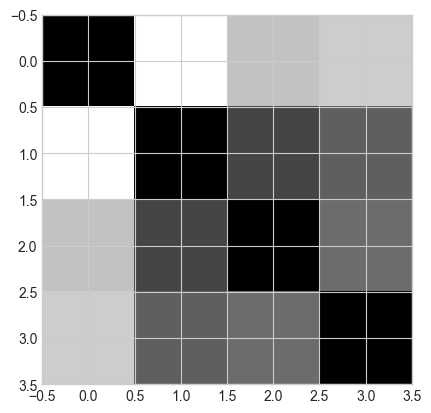

In [66]:
mean_spearmanr = spearman_df.mean_spearmanr.values.astype(float)

plt.imshow(mean_spearmanr.reshape(4,4))

In [67]:
mean_spearmanr.reshape(4,4)

array([[1.        , 0.72619048, 0.82142857, 0.80952381],
       [0.72619048, 1.        , 0.94047619, 0.91666667],
       [0.82142857, 0.94047619, 1.        , 0.9047619 ],
       [0.80952381, 0.91666667, 0.9047619 , 1.        ]])

In [34]:
# spearman_df = spearman_df.drop(columns="mean_pval", inplace=True)
# spearman_df

In [23]:
spearman_heatmap = spearman_df.loc[:, ["session_1", "session_2", "mean_spearmanr"]]
spearman_heatmap

,session_1,session_2,mean_spearmanr_abs
postop_fu3m_spearman_mean,postop,fu3m,0.590774
postop_fu12m_spearman_mean,postop,fu12m,0.740079
postop_fu18m_spearman_mean,postop,fu18m,0.797619
fu3m_fu12m_spearman_mean,fu3m,fu12m,0.810847
fu3m_fu18m_spearman_mean,fu3m,fu18m,0.797619
fu12m_fu18m_spearman_mean,fu12m,fu18m,0.85


In [24]:
column_mean = spearman_heatmap.pop("mean_spearmanr_abs")
spearman_heatmap.insert(0, "mean_spearmanr_abs", column_mean)


In [25]:
spearman_heatmap

,mean_spearmanr_abs,session_1,session_2
postop_fu3m_spearman_mean,0.590774,postop,fu3m
postop_fu12m_spearman_mean,0.740079,postop,fu12m
postop_fu18m_spearman_mean,0.797619,postop,fu18m
fu3m_fu12m_spearman_mean,0.810847,fu3m,fu12m
fu3m_fu18m_spearman_mean,0.797619,fu3m,fu18m
fu12m_fu18m_spearman_mean,0.85,fu12m,fu18m


In [20]:
import plotly.express as px

# data=[[0.575893, 0.640873, 0.797619], [None, 0.771164, 0.797619], [None, None, 0.797619]] # no absolute 
# data = [[0.590774, 0.740079, 0.797619], [1, 0.810847, 0.797619], [0.810847, 1, 0.85]] # Mean of absolute values, 1 manually added for correlation fu3m-fu3m and fu12m-fu12m
data = mean_spearmanr.reshape(4,4)

fig = px.imshow(data,
                labels=dict(x="session 1", y="session 2", color="Mean of spearman correlation"),
                x=['postop', 'fu3m', 'fu12m', 'fu18m'],
                y=['postop', 'fu3m', 'fu12m', 'fu18m'],
               )
fig.update_xaxes(side="top")
fig.show()

In [23]:
figures_path = find_folders.get_local_path(folder="GroupFigures")

filename = os.path.join(figures_path, "Monopol_session_correlations_heatmap_beta_relPsd_mean")

fig.write_image(filename, format="png")

In [46]:
import plotly.graph_objects as go

fig = go.Figure(data=go.Heatmap(
                   z=[[0.575893, 0.640873, 0.797619], [None, 0.771164, 0.797619], [None, None, 0.797619]],
                   x=['postop', 'fu3m', 'fu12m'],
                   y=['fu3m', 'fu12m', 'fu18m'],
                   hoverongaps = False))
fig.show()

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

In [45]:
sns.heatmap(spearman_df)

ValueError: could not convert string to float: 'postop'

## 9. Clinical stimulation contacts 

Excel file loaded:  BestClinicalStimulation.xlsx 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\data
new file:  ActiveClinicalStimContact_Levels_fu3m_fu12m.pickle 
written in in:  c:\Users\jebe12\Research\Longterm_beta_project\results 
new figure: ActiveClinicalStimContact_Levels_fu3m_fu12m_and_fu12m_longterm.png 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\figures


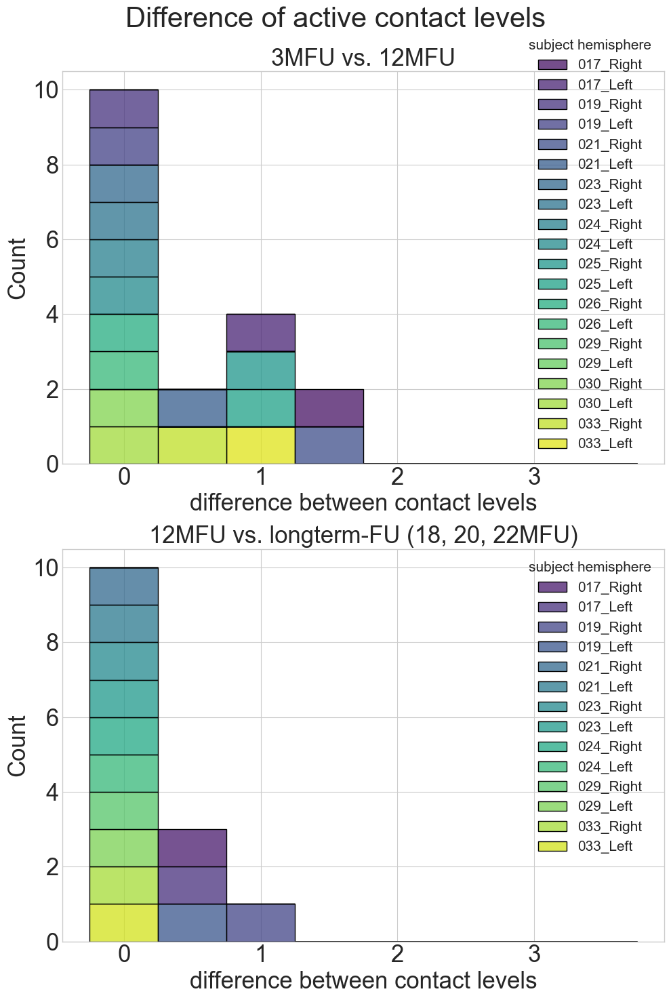

In [120]:
activeLevels = activeStimContacts.bestClinicalStimContacts_LevelsComparison()

In [28]:
file = loadResults.load_BestClinicalStimulation_excel()

Excel file loaded:  BestClinicalStimulation.xlsx 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\data


In [36]:
contactLevels_all = file["compareLevels"]

# select only fu3m rows and fu12m rows and merge
fu3m_level = contactLevels_all[contactLevels_all.session == "fu3m"]
fu12m_level = contactLevels_all[contactLevels_all.session == "fu12m"]
comparefu3m_fu12m = fu3m_level.merge(fu12m_level, left_on="subject_hemisphere", right_on="subject_hemisphere")
comparefu3m_fu12m.dropna(axis=0) # delete rows with NaNs

# calculate the difference between levels, add to a new column
comparefu3m_fu12m["difference_levels"] = (comparefu3m_fu12m["ContactLevel_x"] - comparefu3m_fu12m["ContactLevel_y"]).apply(abs)
comparefu3m_fu12m.dropna(axis=0)

,subject_hemisphere,session_x,CathodalContact_x,ContactLevel_x,session_y,CathodalContact_y,ContactLevel_y,difference_levels
0,017_Right,fu3m,1A,1.0,fu12m,2A_2B_2C_3,2.5,1.5
1,017_Left,fu3m,1C_2A,1.5,fu12m,2A_2B_2C_3,2.5,1.0
2,019_Right,fu3m,0,0.0,fu12m,0,0.0,0.0
3,019_Left,fu3m,1,1.0,fu12m,1,1.0,0.0
4,021_Right,fu3m,2,2.0,fu12m,0_1B,0.5,1.5
5,021_Left,fu3m,1,1.0,fu12m,0_1B,0.5,0.5
6,023_Right,fu3m,2A_2B_2C,2.0,fu12m,2A_2B_2C,2.0,0.0
7,023_Left,fu3m,2A_2B_2C,2.0,fu12m,2A_2B_2C,2.0,0.0
8,024_Right,fu3m,1,1.0,fu12m,1,1.0,0.0
9,024_Left,fu3m,1,1.0,fu12m,1,1.0,0.0


In [34]:
# select only fu12m rows and longterm rows and merge

fu12m_level = contactLevels_all[contactLevels_all.session == "fu12m"]
longterm_level = contactLevels_all[(contactLevels_all.session == "fu18m") | (contactLevels_all.session == "fu20m") | (contactLevels_all.session == "fu22m")] # use | instead of or here 
comparefu12m_longterm= fu12m_level.merge(longterm_level, left_on="subject_hemisphere", right_on="subject_hemisphere")
comparefu12m_longterm.dropna(axis=0) 

# calculate the difference between levels, add to a new column
comparefu12m_longterm["difference_levels"] = (comparefu12m_longterm["ContactLevel_x"] - comparefu12m_longterm["ContactLevel_y"]).apply(abs)
comparefu12m_longterm.dropna(axis=0)


,subject_hemisphere,session_x,CathodalContact_x,ContactLevel_x,session_y,CathodalContact_y,ContactLevel_y,difference_levels
0,017_Right,fu12m,2A_2B_2C_3,2.5,fu22m,3,3.0,0.5
1,017_Left,fu12m,2A_2B_2C_3,2.5,fu22m,3,3.0,0.5
2,019_Right,fu12m,0,0.0,fu18m,1,1.0,1.0
3,019_Left,fu12m,1,1.0,fu18m,1_2,1.5,0.5
4,021_Right,fu12m,0_1B,0.5,fu18m,0_1B,0.5,0.0
5,021_Left,fu12m,0_1B,0.5,fu18m,0_1B,0.5,0.0
6,023_Right,fu12m,2A_2B_2C,2.0,fu20m,2,2.0,0.0
7,023_Left,fu12m,2A_2B_2C,2.0,fu20m,2,2.0,0.0
8,024_Right,fu12m,1,1.0,fu18m,1,1.0,0.0
9,024_Left,fu12m,1,1.0,fu18m,1,1.0,0.0


In [53]:
np.arange(-0.25,4,0.5)

array([-0.25,  0.25,  0.75,  1.25,  1.75,  2.25,  2.75,  3.25,  3.75])

In [95]:
list(comparefu3m_fu12m.subject_hemisphere.values)

['017_Right',
 '017_Left',
 '019_Right',
 '019_Left',
 '021_Right',
 '021_Left',
 '023_Right',
 '023_Left',
 '024_Right',
 '024_Left',
 '025_Right',
 '025_Left',
 '026_Right',
 '026_Left',
 '029_Right',
 '029_Left',
 '030_Right',
 '030_Left',
 '033_Right',
 '033_Left']

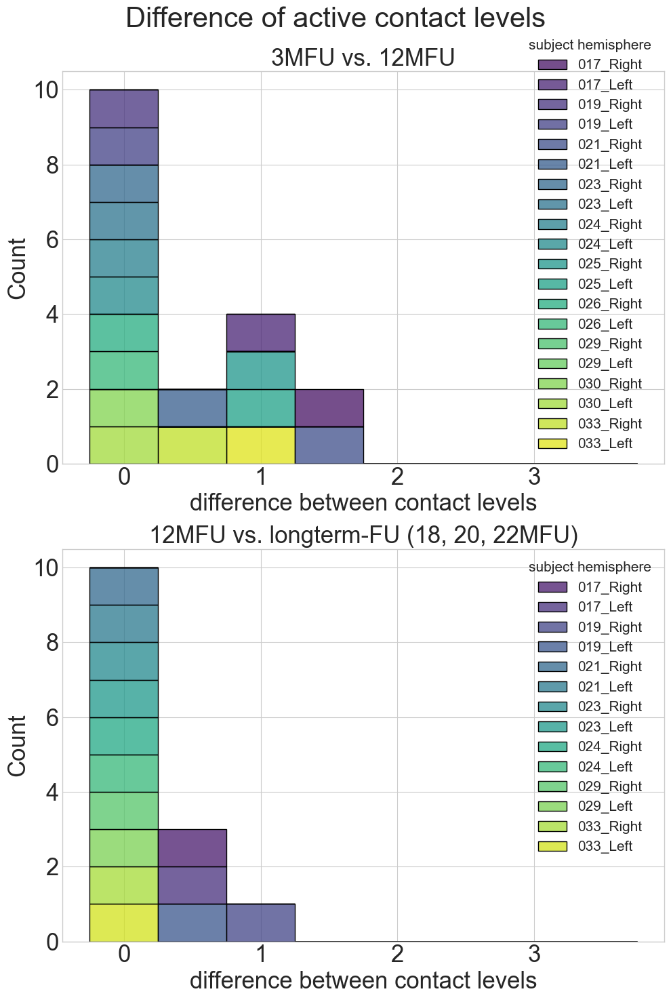

In [102]:
colors0 = sns.color_palette("viridis", n_colors=len(comparefu3m_fu12m.index))
colors1 = sns.color_palette("viridis", n_colors=len(comparefu12m_longterm.index))

fontdict = {"size": 25}

fig, axes  = plt.subplots(2, 1, figsize=(10,15))

sns.histplot(data=comparefu3m_fu12m, x="difference_levels", stat="count", hue="subject_hemisphere", 
             multiple="stack", bins=np.arange(-0.25,4,0.5),
             palette=colors0, ax=axes[0])

axes[0].set_title("3MFU vs. 12MFU", fontdict=fontdict)

legend1 = axes[0].get_legend()
handles = legend1.legendHandles

legend_list1 = list(comparefu3m_fu12m.subject_hemisphere.values)
axes[0].legend(handles, legend_list1, title='subject hemisphere',  title_fontsize=15, fontsize=15)


sns.histplot(data=comparefu12m_longterm, x="difference_levels", stat="count", hue="subject_hemisphere", 
             multiple="stack", bins=np.arange(-0.25,4,0.5),
             palette=colors1, ax= axes[1])

axes[1].set_title("12MFU vs. longterm-FU (18, 20, 22MFU)", fontdict=fontdict)
legend2 = axes[1].get_legend()
handles = legend2.legendHandles

legend_list2 = list(comparefu12m_longterm.subject_hemisphere.values)
axes[1].legend(handles, legend_list2, title='subject hemisphere', title_fontsize=15, fontsize=15)


for ax in axes:

    ax.set_xlabel("difference between contact levels",  fontsize=25)
    ax.set_ylabel("Count", fontsize=25)
    # ax.set_xticks(fontsize=25)
    # ax.set_yticks(fontsize=25)
    ax.tick_params(axis="x", labelsize=25)
    ax.tick_params(axis="y", labelsize=25)



fig.suptitle("Difference of active contact levels", fontsize=30)
fig.subplots_adjust(wspace=0, hspace=0)
fig.tight_layout()
plt.show()

In [89]:
fu3m_fu12m_levels = pd.concat([fu3m_level, fu12m_level])

fu3m_fu12m_levels.dropna(axis=0)

,subject_hemisphere,session,CathodalContact,ContactLevel
0,017_Right,fu3m,1A,1.0
1,017_Left,fu3m,1C_2A,1.5
6,019_Right,fu3m,0,0.0
7,019_Left,fu3m,1,1.0
12,021_Right,fu3m,2,2.0
13,021_Left,fu3m,1,1.0
18,023_Right,fu3m,2A_2B_2C,2.0
19,023_Left,fu3m,2A_2B_2C,2.0
24,024_Right,fu3m,1,1.0
25,024_Left,fu3m,1,1.0


<AxesSubplot:xlabel='session', ylabel='ContactLevel'>

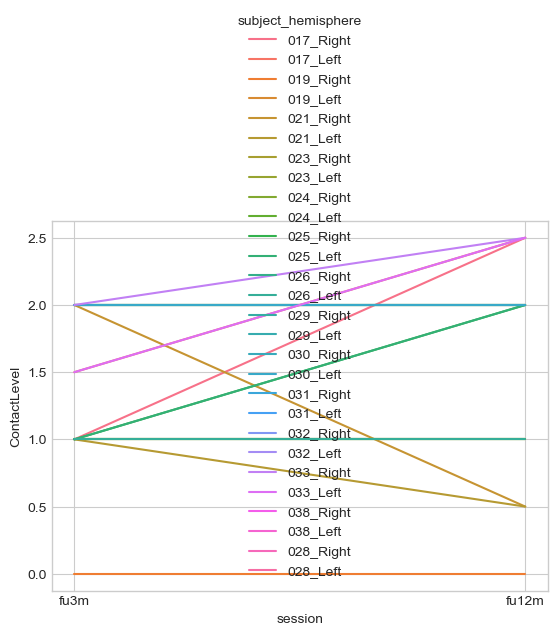

In [41]:
# plot the difference in lineplot

sns.lineplot(data=fu3m_fu12m_levels, x='session', y='ContactLevel', hue="subject_hemisphere")

    

In [34]:
comparefum12_longterm = file["comparefu12m_longterm"]

# timepoint 1 = fu12m
timepoint1 = comparefum12_longterm[comparefum12_longterm.session == "fu12m"]

# timepoint 2 = longterm
timepoint2 = comparefum12_longterm[comparefum12_longterm.session == "longterm"]
timepoint2

,subject_hemisphere,session_original,session,CathodalContact,CathodalContact_direction,CathodalContact_level
4,017_Right,fu22m,longterm,3,A_B_C,3
5,017_Left,fu22m,longterm,3,A_B_C,3
8,019_Right,fu18m,longterm,1,A_B_C,1
9,019_Left,fu18m,longterm,1_2,A_B_C,1
10,019_Left,fu18m,longterm,1_2,A_B_C,2
15,021_Right,fu18m,longterm,0_1B,A_B_C,0
16,021_Right,fu18m,longterm,0_1B,B,1
17,021_Left,fu18m,longterm,0_1B,A_B_C,0
18,021_Left,fu18m,longterm,0_1B,B,1
21,023_Right,fu20m,longterm,2,A_B_C,2


In [ ]:
# 2 comparison plots: fu3m - fu12m and fu12m - fu18m
# x axis: direction A, B, C
# y axis: level 0,1,2,3

# within one plot: 
# only include sub_hem with both sessions True
# 2 dots per patient


In [29]:
# one subject_hem: same color
subject_hemisphere = comparefum12_longterm.subject_hemisphere.unique()
subject_hemisphere

array(['017_Right', '017_Left', '019_Right', '019_Left', '021_Right',
       '021_Left', '023_Right', '023_Left', '024_Right', '024_Left',
       '029_Right', '029_Left', '033_Right', '033_Left'], dtype=object)

In [38]:
#if comparefum12_longterm.CathodalContact_direction == "A_B_C": copy row 2x and replace A_B_C by A , in next row B, in next row C
for val in comparefum12_longterm.CathodalContact_direction: 
    if val == "A_B_C":
        comparefum12_longterm.loc[np.repeat(comparefum12_longterm.index.values, 2)]
    
    else: continue
        

comparefum12_longterm

,subject_hemisphere,session_original,session,CathodalContact,CathodalContact_direction,CathodalContact_level
0,017_Right,fu12m,fu12m,2A_2B_2C_3,A_B_C,2
1,017_Right,fu12m,fu12m,2A_2B_2C_3,A_B_C,3
2,017_Left,fu12m,fu12m,2A_2B_2C_3,A_B_C,2
3,017_Left,fu12m,fu12m,2A_2B_2C_3,A_B_C,3
4,017_Right,fu22m,longterm,3,A_B_C,3
5,017_Left,fu22m,longterm,3,A_B_C,3
6,019_Right,fu12m,fu12m,0,A_B_C,0
7,019_Left,fu12m,fu12m,1,A_B_C,1
8,019_Right,fu18m,longterm,1,A_B_C,1
9,019_Left,fu18m,longterm,1_2,A_B_C,1


In [37]:
comparefum12_longterm

,subject_hemisphere,session_original,session,CathodalContact,CathodalContact_direction,CathodalContact_level
0,017_Right,fu12m,fu12m,2A_2B_2C_3,A_B_C,2
1,017_Right,fu12m,fu12m,2A_2B_2C_3,A_B_C,3
2,017_Left,fu12m,fu12m,2A_2B_2C_3,A_B_C,2
3,017_Left,fu12m,fu12m,2A_2B_2C_3,A_B_C,3
4,017_Right,fu22m,longterm,3,A_B_C,3
5,017_Left,fu22m,longterm,3,A_B_C,3
6,019_Right,fu12m,fu12m,0,A_B_C,0
7,019_Left,fu12m,fu12m,1,A_B_C,1
8,019_Right,fu18m,longterm,1,A_B_C,1
9,019_Left,fu18m,longterm,1_2,A_B_C,1


ValueError: 'c' argument must be a color, a sequence of colors, or a sequence of numbers, not 0     017_Right
1     017_Right
2      017_Left
3      017_Left
4     017_Right
5      017_Left
6     019_Right
7      019_Left
8     019_Right
9      019_Left
10     019_Left
11    021_Right
12    021_Right
13     021_Left
14     021_Left
15    021_Right
16    021_Right
17     021_Left
18     021_Left
19    023_Right
20     023_Left
21    023_Right
22     023_Left
23    024_Right
24     024_Left
25    024_Right
26     024_Left
27    029_Right
28    029_Right
29     029_Left
30    029_Right
31    029_Right
32     029_Left
33    033_Right
34    033_Right
35    033_Right
36     033_Left
37     033_Left
38     033_Left
39    033_Right
40    033_Right
41    033_Right
42     033_Left
43     033_Left
44     033_Left
Name: subject_hemisphere, dtype: object

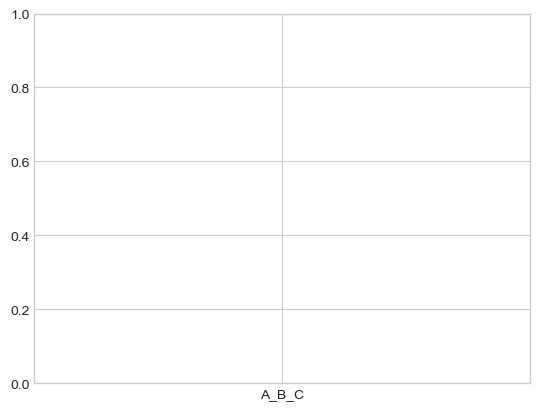

In [30]:
marker_size=15
plt.scatter(comparefum12_longterm["CathodalContact_direction"], comparefum12_longterm["CathodalContact_level"], marker_size, c=comparefum12_longterm["subject_hemisphere"])
plt.title("Electrode 2D")
plt.xlabel("direction")
plt.ylabel("level")
cbar= plt.colorbar()
cbar.set_label("subject hemisphere", labelpad=+1)
plt.show()

## 10.a Correlation of clinical stimulation contacts and beta ranks

Use automatized function: correlateActiveClinicalContacts_monopolarPSDRanks() from activeStimulationContacts.py

pickle file loaded:  sub017_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
017_Right_fu3m
017_Right_fu12m
pickle file loaded:  sub017_Left_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
017_Left_fu3m
017_Left_fu12m
pickle file loaded:  sub019_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-019
019_Right_fu3m
019_Right_fu12m
019_Right_fu18m
pickle file loaded:  sub019_Left_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-019
019_Left_fu3m
019_Left_fu12m
019_Left_fu18m
pickle file loaded:  sub021_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\

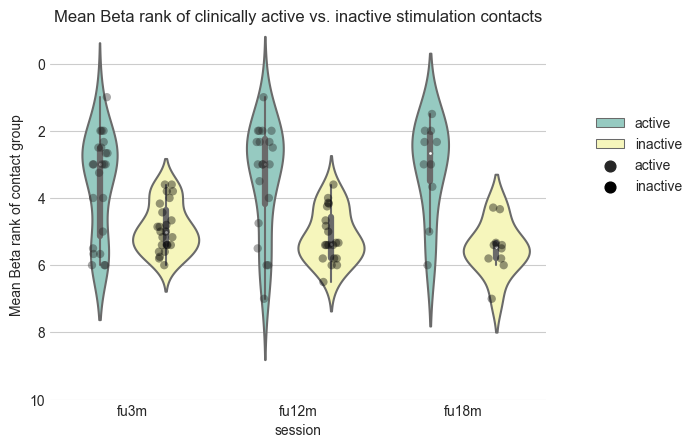

In [90]:
resultCorrelation = activeStimContacts.correlateActiveClinicalContacts_monopolarPSDRanks(
    incl_sub=["017", "019", "021", "024", "025", "026", "028", "029", "030", "031", "032", "033", "038"],
    freqBand="beta",
    rank_or_psd="rank", 
    singleContacts_or_average="averageContacts"
)

# TODO: do the same analysis but instead use relative beta psd values ranging from 0 to 1 (stretched, so the electrodes are comparable)

In [9]:
resultCorrelation["description_results"]

,number_observations,min_and_max,mean,variance,skewness,kurtosis
fu3m_active_rank_averageContacts,24,"(1.0, 6.0)",3.572917,2.340165,0.445678,-1.097573
fu3m_inactive_rank_averageContacts,24,"(nan, nan)",NaN,NaN,NaN,NaN
fu12m_active_rank_averageContacts,20,"(1.0, 7.0)",3.3625,2.711458,0.848018,-0.396267
fu12m_inactive_rank_averageContacts,20,"(3.6, 6.5)",5.14131,0.61702,-0.356657,-0.815965
fu18m_active_rank_averageContacts,10,"(1.5, 6.0)",3.083333,2.057099,0.980286,-0.209401
fu18m_inactive_rank_averageContacts,10,"(4.285714285714286, 7.0)",5.485238,0.617911,0.100133,-0.029721


In [10]:
resultCorrelation["significance_results"]

,W-val,alternative,p-val,RBC,CLES,comparison_rank_averageContacts
Wilcoxon,28.5,two-sided,0.000694,-0.774704,0.235537,fu3m_active_fu3m_inactive
Wilcoxon,26.5,two-sided,0.001986,-0.747619,0.193750,fu12m_active_fu12m_inactive
Wilcoxon,3.0,two-sided,0.009766,-0.890909,0.105000,fu18m_active_fu18m_inactive


In [12]:
# describe arrays
resultCorrelation["data_MonoBeta8Ranks"]


,subject_hemisphere,session,MEAN_beta_rank,MEAN_beta_psd,clinicalUse,session_clinicalUse
017_Right_fu3m_active,017_Right,fu3m,5.000000,0.242557,active,fu3m_active
017_Right_fu3m_inactive,017_Right,fu3m,4.428571,0.244629,inactive,fu3m_inactive
017_Right_fu12m_active,017_Right,fu12m,2.500000,0.336278,active,fu12m_active
017_Right_fu12m_inactive,017_Right,fu12m,6.500000,0.257318,inactive,fu12m_inactive
017_Left_fu3m_active,017_Left,fu3m,4.000000,0.146137,active,fu3m_active
...,...,...,...,...,...,...
033_Left_fu18m_inactive,033_Left,fu18m,5.800000,0.868155,inactive,fu18m_inactive
038_Right_fu3m_active,038_Right,fu3m,2.333333,2.320921,active,fu3m_active
038_Right_fu3m_inactive,038_Right,fu3m,5.800000,1.863019,inactive,fu3m_inactive
038_Left_fu3m_active,038_Left,fu3m,6.000000,1.337232,active,fu3m_active


In [12]:
dataframe = resultCorrelation["data_MonoBeta8Ranks"]
dataframe

,subject_hemisphere,session,MEAN_beta_rank,MEAN_beta_psd,clinicalUse,session_clinicalUse
017_Right_fu3m_active,017_Right,fu3m,5.000000,0.242557,active,fu3m_active
017_Right_fu3m_inactive,017_Right,fu3m,4.428571,0.244629,inactive,fu3m_inactive
017_Right_fu12m_active,017_Right,fu12m,2.500000,0.336278,active,fu12m_active
017_Right_fu12m_inactive,017_Right,fu12m,6.500000,0.257318,inactive,fu12m_inactive
017_Left_fu3m_active,017_Left,fu3m,4.000000,0.146137,active,fu3m_active
017_Left_fu3m_inactive,017_Left,fu3m,4.666667,0.144398,inactive,fu3m_inactive
017_Left_fu12m_active,017_Left,fu12m,4.750000,0.240337,active,fu12m_active
017_Left_fu12m_inactive,017_Left,fu12m,4.250000,0.248365,inactive,fu12m_inactive
019_Right_fu3m_active,019_Right,fu3m,1.000000,0.796842,active,fu3m_active
019_Right_fu3m_inactive,019_Right,fu3m,5.000000,0.483020,inactive,fu3m_inactive


In [86]:
ses_clinicalUse= ["fu3m_active", "fu3m_inactive", "fu12m_active", "fu12m_inactive", "fu18m_active", "fu18m_inactive"]
pairs = list(combinations(ses_clinicalUse, 2))
all_results_mwu = []
describe_arrays = {}


# pair = tuple e.g. postop, fu3m
for pair in pairs:

    firstInPair = dataframe.loc[(dataframe.session_clinicalUse == pair[0])]
    firstInPair = np.array(firstInPair.MEAN_beta_rank.values)

    secondInPair = dataframe.loc[(dataframe.session_clinicalUse == pair[1])]
    secondInPair = np.array(secondInPair.MEAN_beta_rank.values)    

    # Perform Mann-Whitney Test
    results_mwu = pg.mwu(firstInPair, secondInPair) # pair is always a tuple, comparing first and second component of this tuple
    results_mwu['comparison'] = '_'.join(pair) # new column "comparison" with the pair being compared e.g. fu3m_active and fu3m_inactive

    all_results_mwu.append(results_mwu)


# describe all 6 groups
for s_c in ses_clinicalUse:

    # get array of each group
    group = dataframe.loc[(dataframe.session_clinicalUse == s_c)]
    group = np.array(group.MEAN_beta_rank.values)

    description = scipy.stats.describe(group)

    describe_arrays[s_c] = description

description_results = pd.DataFrame(describe_arrays)
description_results.rename(index={0: "number_observations", 1: "min_and_max", 2: "mean", 3: "variance", 4: "skewness", 5: "kurtosis"}, inplace=True)
description_results = description_results.transpose()


significance_results = pd.concat(all_results_mwu)
significance_results

,U-val,alternative,p-val,RBC,CLES,comparison
MWU,41.5,two-sided,0.082728,0.423611,0.288194,fu3m_active_fu3m_inactive
MWU,80.5,two-sided,0.876594,0.041667,0.479167,fu3m_active_fu12m_active
MWU,39.5,two-sided,0.023343,0.529762,0.235119,fu3m_active_fu12m_inactive
MWU,37.0,two-sided,0.962357,-0.027778,0.513889,fu3m_active_fu18m_active
MWU,13.0,two-sided,0.034432,0.638889,0.180556,fu3m_active_fu18m_inactive
MWU,128.0,two-sided,0.024986,-0.523810,0.761905,fu3m_inactive_fu12m_active
MWU,66.0,two-sided,0.366834,0.214286,0.392857,fu3m_inactive_fu12m_inactive
MWU,60.5,two-sided,0.024367,-0.680556,0.840278,fu3m_inactive_fu18m_active
MWU,16.5,two-sided,0.074254,0.541667,0.229167,fu3m_inactive_fu18m_inactive
MWU,43.0,two-sided,0.012097,0.561224,0.219388,fu12m_active_fu12m_inactive


c:\Users\jebe12\anaconda3\envs\pyPerceive_dev\lib\site-packages\statannotations\_Plotter.py:337: UserWarning: Invalid x-position found. Are the same parameters passed to seaborn and statannotations calls? or are there few data points?
  warnings.warn(
c:\Users\jebe12\anaconda3\envs\pyPerceive_dev\lib\site-packages\statannotations\_Plotter.py:337: UserWarning: Invalid x-position found. Are the same parameters passed to seaborn and statannotations calls? or are there few data points?
  warnings.warn(
c:\Users\jebe12\anaconda3\envs\pyPerceive_dev\lib\site-packages\statannotations\_Plotter.py:337: UserWarning: Invalid x-position found. Are the same parameters passed to seaborn and statannotations calls? or are there few data points?
  warnings.warn(
c:\Users\jebe12\anaconda3\envs\pyPerceive_dev\lib\site-packages\statannotations\_Plotter.py:337: UserWarning: Invalid x-position found. Are the same parameters passed to seaborn and statannotations calls? or are there few data points?
  warning

fu3m_active vs. fu3m_inactive: Mann-Whitney-Wilcoxon test two-sided, P_val:8.273e-02 U_stat=4.150e+01
fu12m_active vs. fu12m_inactive: Mann-Whitney-Wilcoxon test two-sided, P_val:1.210e-02 U_stat=4.300e+01
fu18m_active vs. fu18m_inactive: Mann-Whitney-Wilcoxon test two-sided, P_val:3.638e-02 U_stat=4.500e+00


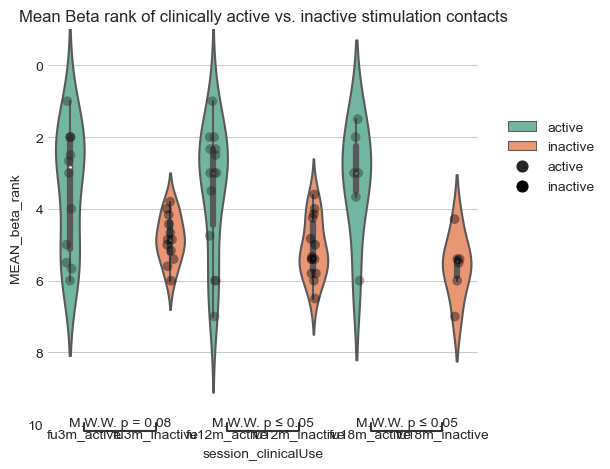

In [26]:
fig=plt.figure()
ax = fig.add_subplot()



sns.violinplot(data=dataframe, x="session_clinicalUse", y="MEAN_beta_rank", hue="clinicalUse", palette="Set2", inner="box", ax=ax) #split=True)

ses_clinicalUse= [("fu3m_active", "fu3m_inactive"), ("fu12m_active", "fu12m_inactive"), ("fu18m_active", "fu18m_inactive")]
pairs = list(combinations(ses_clinicalUse, 2))

annotator = Annotator(ax, ses_clinicalUse, data=dataframe, x='session_clinicalUse', y="MEAN_beta_rank")
annotator.configure(test='Mann-Whitney', text_format='simple', loc="outside")
annotator.apply_and_annotate()

sns.stripplot(
    data=dataframe,
    x="session_clinicalUse",
    y="MEAN_beta_rank",
    hue="clinicalUse",
    ax=ax,
    size=7,
    color="black",
    alpha=0.4, # Transparency of dots
    dodge=True, # datapoints of groups active, inactive are plotted next to each other
)

sns.despine(left=True, bottom=True) # get rid of figure frame

# adjust x ticks to only show sessions
# labels = [item.get_text() for item in ax.get_xticklabels()]
# labels[0] = "3MFU"
# labels[1] = "12MFU"
# labels[2] = "18MFU"

# ax.set_xticks([0.5,2.5,4.5])
# ax.set_xticklabels(["3MFU", "12MFU", "18MFU"])
# ax.tick_params(axis="x", pad=15)

plt.title("Mean Beta rank of clinically active vs. inactive stimulation contacts")
plt.ylabel("MEAN_beta_rank")
plt.ylim(10, -1)
plt.legend(loc="upper right", bbox_to_anchor=(1.3, 0.8))
plt.tight_layout()



c:\Users\jebe12\anaconda3\envs\pyPerceive_dev\lib\site-packages\statannotations\_Plotter.py:337: UserWarning: Invalid x-position found. Are the same parameters passed to seaborn and statannotations calls? or are there few data points?
  warnings.warn(
c:\Users\jebe12\anaconda3\envs\pyPerceive_dev\lib\site-packages\statannotations\_Plotter.py:337: UserWarning: Invalid x-position found. Are the same parameters passed to seaborn and statannotations calls? or are there few data points?
  warnings.warn(
c:\Users\jebe12\anaconda3\envs\pyPerceive_dev\lib\site-packages\statannotations\_Plotter.py:337: UserWarning: Invalid x-position found. Are the same parameters passed to seaborn and statannotations calls? or are there few data points?
  warnings.warn(
c:\Users\jebe12\anaconda3\envs\pyPerceive_dev\lib\site-packages\statannotations\_Plotter.py:337: UserWarning: Invalid x-position found. Are the same parameters passed to seaborn and statannotations calls? or are there few data points?
  warning

fu3m_active vs. fu3m_inactive: Mann-Whitney-Wilcoxon test two-sided, P_val:8.273e-02 U_stat=4.150e+01
fu12m_active vs. fu12m_inactive: Mann-Whitney-Wilcoxon test two-sided, P_val:1.210e-02 U_stat=4.300e+01
fu18m_active vs. fu18m_inactive: Mann-Whitney-Wilcoxon test two-sided, P_val:3.638e-02 U_stat=4.500e+00


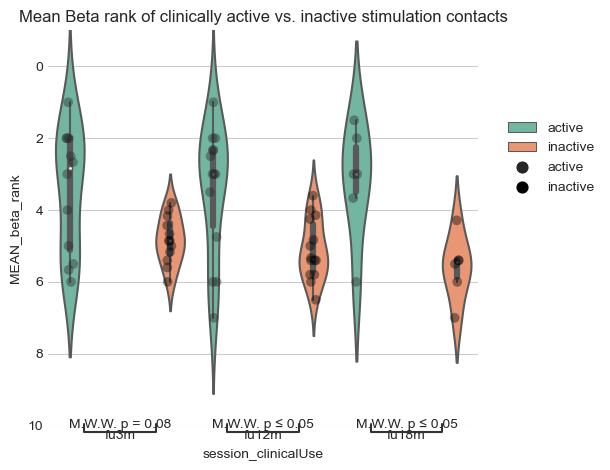

In [45]:
fig=plt.figure()
ax = fig.add_subplot()



sns.violinplot(data=dataframe, x="session_clinicalUse", y="MEAN_beta_rank", hue="clinicalUse", palette="Set2", inner="box", ax=ax)

ses_clinicalUse= [("fu3m_active", "fu3m_inactive"), ("fu12m_active", "fu12m_inactive"), ("fu18m_active", "fu18m_inactive")]
# pairs = list(combinations(ses_clinicalUse, 2))

annotator = Annotator(ax, ses_clinicalUse, data=dataframe, x='session_clinicalUse', y="MEAN_beta_rank")
annotator.configure(test='Mann-Whitney', text_format='simple', loc="outside")
annotator.apply_and_annotate()

sns.stripplot(
    data=dataframe,
    x="session_clinicalUse",
    y="MEAN_beta_rank",
    hue="clinicalUse",
    ax=ax,
    size=7,
    color="black",
    alpha=0.4, # Transparency of dots
    dodge=True, # datapoints of groups active, inactive are plotted next to each other
)

sns.despine(left=True, bottom=True) # get rid of figure frame

# adjust x ticks to only show sessions
ax.set_xticks([0.5,2.5,4.5])
ax.set_xticklabels(["fu3m", "fu12m", "fu18m"])

plt.title("Mean Beta rank of clinically active vs. inactive stimulation contacts")
plt.ylabel("MEAN_beta_rank")
plt.ylim(10, -1)
plt.legend(loc="upper right", bbox_to_anchor=(1.3, 0.8))
plt.tight_layout()




In [11]:
# average of each STN active contacts and average of each STN inactive contacts

STN_keys = dataframe["subject_hemisphere"].unique()
STN_keys

array(['017_Right', '017_Left', '019_Right', '019_Left', '024_Right',
       '024_Left', '025_Right', '025_Left', '026_Right', '026_Left',
       '029_Right', '029_Left', '030_Right', '030_Left'], dtype=object)

In [16]:
# get rows of one STN

STN_dataframe = dataframe.loc[(dataframe.subject_hemisphere == "017_Right")]

STN_session_unique = STN_dataframe.session.unique()


STN_session_dataframe = STN_dataframe.loc[(STN_dataframe.session == "fu3m")]
STN_session_dataframe

,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,monopolarChannels,clinicalUse
0,017_Right,fu3m,0.206574,8.0,0,inactive
1,017_Right,fu3m,0.235433,7.0,1B,inactive
2,017_Right,fu3m,0.238925,6.0,1C,inactive
3,017_Right,fu3m,0.262323,2.0,2A,inactive
4,017_Right,fu3m,0.250728,4.0,2B,inactive
5,017_Right,fu3m,0.254862,3.0,2C,inactive
6,017_Right,fu3m,0.263559,1.0,3,inactive
177,017_Right,fu3m,0.242557,5.0,1A,active


Extract the clinically active monopolar contacts of each hemisphere and create a new column with the monopolar beta ranks 

In [8]:
incl_sub =  ["017", "019", "024", "025", "026", "029", "030"]
hemispheres = ["Right", "Left"]
freqBand = "beta"
data_weightedByCoordinates = {}
keys_weightedByCoordinates ={}


In [17]:
incl_sub =  ["017", "019", "024", "025", "026", "029", "030"]
hemispheres = ["Right", "Left"]
freqBand = "beta"
sessions = ["postop", "fu3m", "fu12m", "fu18m"]
data_weightedByCoordinates = {}
keys_weightedByCoordinates ={}
session_weightedByCoordinate_Dataframe = {}



for sub in incl_sub:

    for hem in hemispheres:

        data_weightedByCoordinates[f"{sub}_{hem}"] = loadResults.load_monoRef_weightedPsdCoordinateDistance_pickle(
            sub=sub,
            hemisphere=hem,
            freqBand=freqBand,
            normalization="rawPsd",
            filterSignal="band-pass"
            )
        
        # to check, which sessions exist
        keys_weightedByCoordinates[f"{sub}_{hem}"] = data_weightedByCoordinates[f"{sub}_{hem}"].keys()


        for ses in sessions:

            # first check, if session exists in keys
            if f"{ses}_monopolar_Dataframe" in keys_weightedByCoordinates[f"{sub}_{hem}"]:
                print(f"{sub}_{hem}_{ses}")
            
            else:
                continue
            
            # get the dataframe per session
            session_weightedByCoordinates = data_weightedByCoordinates[f"{sub}_{hem}"][f"{ses}_monopolar_Dataframe"]

            # choose only directional contacts and Ring contacts 0, 3 and rank again only the directional contacts
            session_weightedByCoordinates = session_weightedByCoordinates.loc[["0", "1A", "1B", "1C", "2A", "2B", "2C", "3"]]
            session_weightedByCoordinates["Rank8contacts"] = session_weightedByCoordinates["averaged_monopolar_PSD_beta"].rank(ascending=False)
            session_weightedByCoordinates_copy = session_weightedByCoordinates.copy()

            # add column subject_hemisphere_monoChannel
            session_weightedByCoordinates_copy["monopolarChannels"] = np.array(["0", "1A", "1B", "1C", "2A", "2B", "2C", "3"])
            # session_weightedByCoordinates_copy["subject_hemisphere_monoChannel"] = session_weightedByCoordinates_copy[["subject_hemisphere", "monopolarChannels"]].agg("_".join, axis=1)
            session_weightedByCoordinates_copy.drop(["rank", "coord_z", "coord_xy"], axis=1, inplace=True)

            session_weightedByCoordinate_Dataframe[f"{sub}_{hem}_{ses}"] = session_weightedByCoordinates_copy


pickle file loaded:  sub017_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
017_Right_fu3m
017_Right_fu12m
pickle file loaded:  sub017_Left_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-017
017_Left_fu3m
017_Left_fu12m
pickle file loaded:  sub019_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-019
019_Right_fu3m
019_Right_fu12m
019_Right_fu18m
pickle file loaded:  sub019_Left_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results\sub-019
019_Left_fu3m
019_Left_fu12m
019_Left_fu18m
pickle file loaded:  sub024_Right_monoRef_weightedPsdByCoordinateDistance_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\

In [19]:
sub_hem_ses_keys = list(session_weightedByCoordinate_Dataframe.keys())

MonoBeta8Ranks_DF = pd.DataFrame()

for sub_hem_ses in sub_hem_ses_keys:
    single_Dataframe = session_weightedByCoordinate_Dataframe[sub_hem_ses]

    # concatenate all DF together
    MonoBeta8Ranks_DF = pd.concat([MonoBeta8Ranks_DF, single_Dataframe], ignore_index=True)

MonoBeta8Ranks_DF.head()

,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,monopolarChannels
0,017_Right,fu3m,0.206574,8.0,0
1,017_Right,fu3m,0.242557,5.0,1A
2,017_Right,fu3m,0.235433,7.0,1B
3,017_Right,fu3m,0.238925,6.0,1C
4,017_Right,fu3m,0.262323,2.0,2A


In [20]:
MonoBeta8Ranks_DF.loc[(MonoBeta8Ranks_DF["subject_hemisphere"]=="030_Left") & (MonoBeta8Ranks_DF["session"]=="fu12m")]


,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,monopolarChannels
344,030_Left,fu12m,0.172012,8.0,0
345,030_Left,fu12m,0.213265,6.0,1A
346,030_Left,fu12m,0.221504,5.0,1B
347,030_Left,fu12m,0.225642,3.0,1C
348,030_Left,fu12m,0.223307,4.0,2A
349,030_Left,fu12m,0.235274,2.0,2B
350,030_Left,fu12m,0.235958,1.0,2C
351,030_Left,fu12m,0.183991,7.0,3


Only choose rows of clinically active contacts

In [21]:
bestClinicalStim_file = loadResults.load_BestClinicalStimulation_excel()

Excel file loaded:  BestClinicalStimulation.xlsx 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\data


In [23]:
activeClinicalContacts = bestClinicalStim_file["BestClinicalContacts"]
activeClinicalContacts.head()

,subject_hemisphere,session,CathodalContact,InactiveContacts,contact1,contact2,contact3,contact4,contact5,contact6
0,017_Right,fu3m,1A,0_1B_1C_2A_2B_2C_3,1A,NaN,NaN,NaN,NaN,NaN
1,017_Left,fu3m,1C_2A,0_1A_1B_2B_2C_3,1C,2A,NaN,NaN,NaN,NaN
2,017_Right,fu12m,2A_2B_2C_3,0_1A_1B_1C,2A,2B,2C,3,NaN,NaN
3,017_Left,fu12m,2A_2B_2C_3,0_1A_1B_1C,2A,2B,2C,3,NaN,NaN
4,017_Right,fu22m,3,0_1A_1B_1C_2A_2B_2C,3,NaN,NaN,NaN,NaN,NaN


In [30]:
activeClinicalContacts.CathodalContact.values

array(['1A', '1C_2A', '2A_2B_2C_3', '2A_2B_2C_3', 3, 3, 0, 1, 0, 1, 1,
       '1_2', 2, 1, '0_1B', '0_1B', '0_1B', '0_1B', '2A_2B_2C',
       '2A_2B_2C', '2A_2B_2C', '2A_2B_2C', 2, 2, 1, 1, 1, 1, 1, 1, 1,
       '1A_1B', 2, 2, '2A_2B', '1A_1B', '2A_2B', '1A_1B', 1, '1C_2C', nan,
       nan, '1C_2C', '2C ', '1A_2A', '2C ', '2C ', '2C ', '2A_2B_2C',
       '2A_2B_2C', '1A_1B_1C', '1A_1B_1C', '2A_2B_2C', '2B_2C', '2A_2B',
       '2A_2B_1A_1B', '2A_2B_3', '2A_2B_3', '2A_2B_3', '2A_2B_3',
       '2A_2B_2C', '2A_2B_2C'], dtype=object)

Filter the MonoBeta8Ranks_DF by sub_hem, session, CathodalContact

In [24]:
# loop through every row from bestClinicalContact

monopolarContacts = ["0", "1A", "1B", "1C", "2A", "2B", "2C", "3"]

filteredMonoBeta8Ranks = pd.DataFrame()

for idx, row in activeClinicalContacts.iterrows():
    
    activeContacts = str(activeClinicalContacts.CathodalContact.values[idx]) # e.g. "2A_2B_2C_3"
    # split active Contacts into list with single contact strings
    activeContacts_list = activeContacts.split("_") # e.g. ["2A", "2B", "2C", "3"]

    sub_hem = activeClinicalContacts.subject_hemisphere.values[idx]
    session = activeClinicalContacts.session.values[idx]

    # get rows with equal sub_hem and session and with monopolarChannel in the list of activeContacts
    sub_hem_ses_rows = MonoBeta8Ranks_DF.loc[(MonoBeta8Ranks_DF["subject_hemisphere"]==sub_hem) & (MonoBeta8Ranks_DF["session"]==session) & (MonoBeta8Ranks_DF["monopolarChannels"].isin(activeContacts_list))]
    

    # concatenate single rows to new Dataframe
    filteredMonoBeta8Ranks = pd.concat([filteredMonoBeta8Ranks, sub_hem_ses_rows], ignore_index=True)
    

In [8]:
pd.set_option("display.max_rows", None)

In [15]:
# get important values:  
# MEAN of Ranks per session

fu3mAverage = filteredMonoBeta8Ranks.loc[(filteredMonoBeta8Ranks.session=="fu3m")]
mean_fu3m = fu3mAverage.Rank8contacts.values.mean()

# sample size
n_fu3m = len(fu3mAverage.subject_hemisphere.values)
n_fu3m

22

Text(0, 0.5, 'Beta PSD of active contacts')

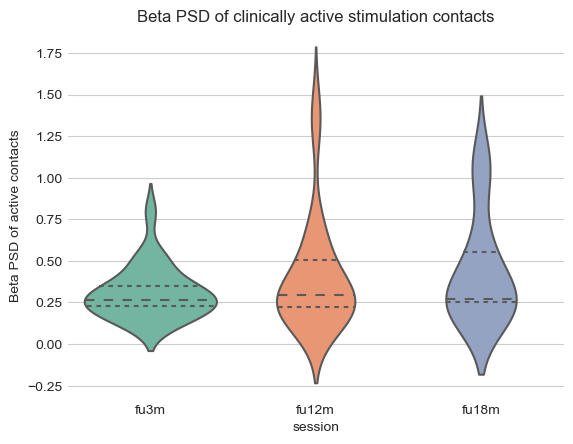

In [25]:
# pairs to compare

fig =plt.figure()

ax = sns.violinplot(data=filteredMonoBeta8Ranks, x="session", y="averaged_monopolar_PSD_beta", inner="quartile", palette="Set2")
ax = sns.despine(left=True, bottom=True) # get rid of figure frame

plt.title("Beta PSD of clinically active stimulation contacts")
plt.ylabel("Beta PSD of active contacts")
# plt.ylim(-1.5, 11)

# annotator = Annotator(ax, )




## 10.b Per Beta rank contact, how many [%] are active?

pickle file loaded:  ClinicalActiveVsNonactiveContacts_relativeToRank1_psd_beta_singleContacts.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


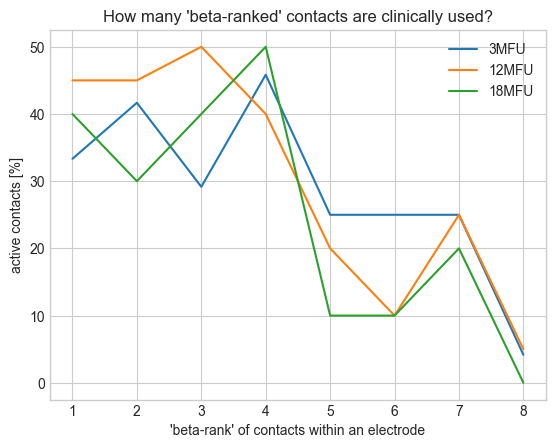

In [169]:
active_vs_inactive = activeStimContacts.active_contacts_per_rank(freqBand="beta")

In [173]:
active_vs_inactive["fu12m_df"]

,session,beta_rank,percentage_active
fu12m_1.0,fu12m,1.0,45.0
fu12m_2.0,fu12m,2.0,45.0
fu12m_3.0,fu12m,3.0,50.0
fu12m_4.0,fu12m,4.0,40.0
fu12m_5.0,fu12m,5.0,20.0
fu12m_6.0,fu12m,6.0,10.0
fu12m_7.0,fu12m,7.0,25.0
fu12m_8.0,fu12m,8.0,5.0


In [159]:
# load Group Mono Ref weighted PSD to ccordinate distance

active_vs_inactive = loadResults.load_ClinicalActiveVsInactive(
    freqBand="beta",
    attribute="relativeToRank1_psd",
    singleContacts_or_average="singleContacts"
)

# TODO: include all longterm follow ups: fu_longterm for all fu appointments > 12m (18,20,22,24) -> load BSSU of longterm fu and rename instead of fu18m, fu20m -> fu_longterm

pickle file loaded:  ClinicalActiveVsNonactiveContacts_relativeToRank1_psd_beta_singleContacts.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [160]:
active_vs_inactive.head()

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,relativePSD_to_beta_Rank1from8,clinicalUse,session_clinicalUse
0,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,5.0,0.920316,active,fu3m_active
1,1C,2.0+0.0j,-0.325000-0.562917j,017_Left,fu3m,0.134140,6.0,0.815652,active,fu3m_active
2,2A,4.0+0.0j,0.650000+0.000000j,017_Left,fu3m,0.158134,2.0,0.961551,active,fu3m_active
3,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu12m,0.428184,1.0,1.000000,active,fu12m_active
4,2A,4.0+0.0j,0.650000+0.000000j,017_Right,fu12m,0.305900,3.0,0.714413,active,fu12m_active


In [151]:
ranks = [1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0]
sessions = ["fu3m", "fu12m", "fu18m"]

percentage_active = {}
sample_size = {}

for session in sessions:

    # filter dependending on session
    session_df = active_vs_inactive.loc[(active_vs_inactive.session == session)]

    # sample size within each session
    sample_counts = session_df.session.value_counts()
    sample_size[f"{session}"] = [session, sample_counts[0]]

    for rank in ranks:
        

        # filter all contacts of the same rank from column "Rank8contacts"
        rank_df = session_df.loc[(active_vs_inactive.Rank8contacts == rank)]

        # calculate percentage of active from all 1.0 ranked contacts
        counts = rank_df.clinicalUse.value_counts() # counts[0] = inactive, counts[1] = active

        inactive_contacts = counts[0]
        
        # if no active contacts in the dataframe, active = 0
        if "active" not in rank_df.values:
            active_contacts = 0
        
        elif "active" in rank_df.values:
            active_contacts = counts[1]
    
        total = inactive_contacts + active_contacts
        percentage_active[f"{session}_{rank}"] = [session, rank, ((active_contacts / total)*100)]



In [152]:
percentage_active_df = pd.DataFrame(percentage_active)
percentage_active_df.rename(index={0:"session", 1:"beta_rank", 2:"percentage_active"}, inplace=True)
percentage_active_df = percentage_active_df.transpose()

sample_size_df = pd.DataFrame(sample_size)
sample_size_df.rename(index={0:"session", 1:"number_of_contacts"}, inplace=True)
sample_size_df = sample_size_df.transpose()



In [153]:
sample_size_df

,session,number_of_contacts
fu3m,fu3m,192
fu12m,fu12m,160
fu18m,fu18m,80


In [154]:
fu3m_df = percentage_active_df.loc[(percentage_active_df.session == "fu3m")]
fu12m_df = percentage_active_df.loc[(percentage_active_df.session == "fu12m")]
fu18m_df = percentage_active_df.loc[(percentage_active_df.session == "fu18m")]

In [112]:
fu12m_df

,session,beta_rank,percentage_active
fu12m_1.0,fu12m,1.0,45.0
fu12m_2.0,fu12m,2.0,45.0
fu12m_3.0,fu12m,3.0,50.0
fu12m_4.0,fu12m,4.0,40.0
fu12m_5.0,fu12m,5.0,20.0
fu12m_6.0,fu12m,6.0,10.0
fu12m_7.0,fu12m,7.0,25.0
fu12m_8.0,fu12m,8.0,5.0


Plot of actively used contacts grouped in beta ranks (total contacts n = 52, all sessions included)

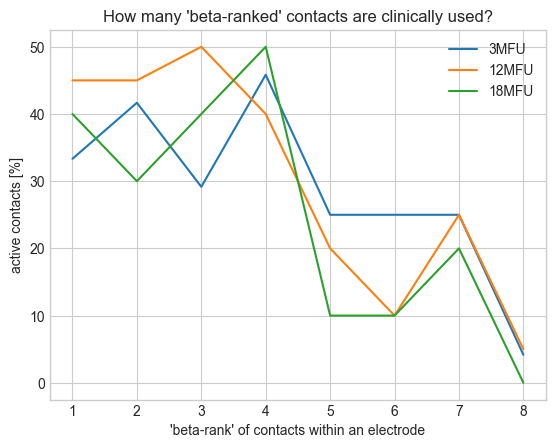

In [161]:
fig = plt.figure()
plt.plot(fu3m_df["beta_rank"], fu3m_df["percentage_active"], label="3MFU")
plt.plot(fu12m_df["beta_rank"], fu12m_df["percentage_active"], label="12MFU")
plt.plot(fu18m_df["beta_rank"], fu18m_df["percentage_active"], label="18MFU")

plt.xlabel("'beta-rank' of contacts within an electrode")
plt.ylabel("active contacts [%]")
plt.title("How many 'beta-ranked' contacts are clinically used?")
plt.legend()

## 10.c Correlation of clinically active contacts and monopolar estimated PSD, per electrode relative to Beta rank 1 contact

Use relative PSD values ranging from 0=lowest PSD to 1=highest PSD

pickle file loaded:  monopol_rel_psd_from0To8_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
new files:  ClinicalActiveVsNonactiveContacts_rel_psd_0_to_1_beta_averageContacts.pickle 
and: ClinicalActiveVsNonactiveContacts_statistics_rel_psd_0_to_1_beta_averageContacts.pickle 
written in in:  c:\Users\jebe12\Research\Longterm_beta_project\results 
new figure: ClinicalActiveVsNonactiveContacts_rel_psd_0_to_1_beta__averageContacts.png 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\figures


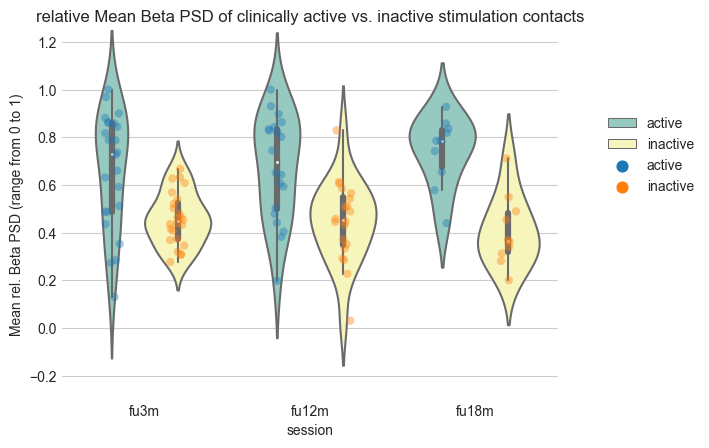

In [221]:
active_vs_inactive = activeStimContacts.active_vs_inactive_contacts_monopolPSD(
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta",
    singleContacts_or_average="averageContacts"
)

# TODO: color code each subject
# what statistical test can I use to compare active vs inactive if sample sizes of single contacts are different?

In [202]:
filterSignal="band-pass"
normalization="rawPsd"
freqBand="beta"

data_monopol_rel_0_to_1 = loadResults.load_monopol_rel_psd_from0To8_pickle(
        filterSignal=filterSignal,
        normalization=normalization,
        freqBand=freqBand)

data_MonoBeta8Ranks = data_monopol_rel_0_to_1

# add another column with session and clinical aggregated for statistical tests (Annotatator)
data_MonoBeta8Ranks["session_clinicalUse"] = data_MonoBeta8Ranks[["session", "clinicalUse"]].agg('_'.join, axis=1)



pickle file loaded:  monopol_rel_psd_from0To8_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [204]:
data_MonoBeta8Ranks.head()

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,relativePSD_beta_from_0_to_1,relativePSD_beta_to_mean_std,currentPolarity,clinicalUse,session_clinicalUse
0,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,5.0,0.631459,-0.098256,1.0,active,fu3m_active
1,1C,2.0+0.0j,-0.325000-0.562917j,017_Left,fu3m,0.134140,6.0,0.153724,-0.811742,0.5,active,fu3m_active
2,2A,4.0+0.0j,0.650000+0.000000j,017_Left,fu3m,0.158134,2.0,0.823492,1.009836,0.5,active,fu3m_active
3,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu12m,0.428184,1.0,1.000000,2.251914,0.25,active,fu12m_active
4,2A,4.0+0.0j,0.650000+0.000000j,017_Right,fu12m,0.305900,3.0,0.306505,0.156010,0.25,active,fu12m_active


PLOT

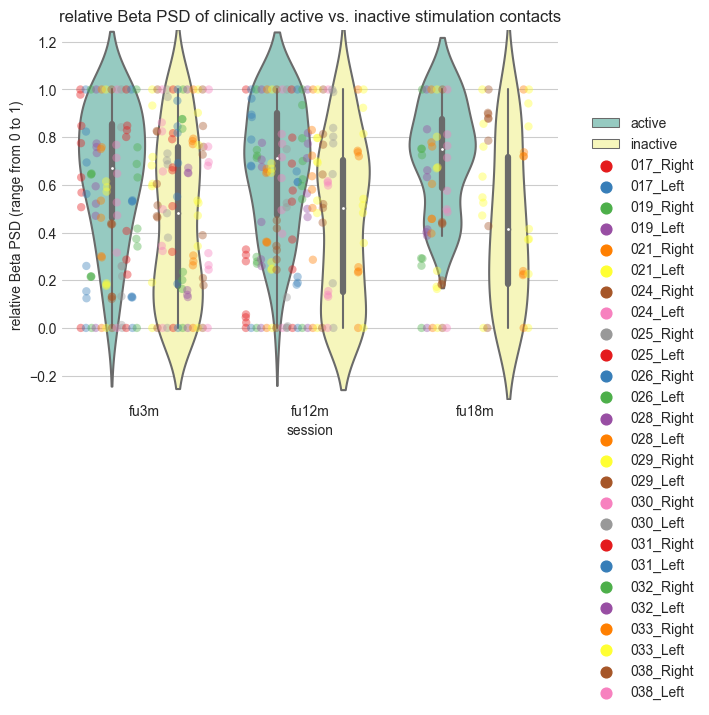

In [223]:
y_values = "relativePSD_beta_from_0_to_1"
y_label = "relative Beta PSD (range from 0 to 1)"
title = "relative Beta PSD of clinically active vs. inactive stimulation contacts"
y_lim = -0.3, 1.25


fig=plt.figure()
ax = fig.add_subplot()

# sns.violinplot(data=data_MonoBeta8Ranks, x="session_clinicalUse", y=y_values, hue="clinicalUse", palette="Set2", inner="box", ax=ax)
sns.violinplot(data=data_MonoBeta8Ranks, x="session", y=y_values, hue="clinicalUse", palette="Set3", inner="box", ax=ax)

sns.stripplot(
    data=data_MonoBeta8Ranks,
    x="session",
    y=y_values,
    hue="subject_hemisphere",
    ax=ax,
    size=6,
    palette="Set1",
    alpha=0.4, # Transparency of dots
    dodge=True, # datapoints of groups active, inactive are plotted next to each other
)

sns.despine(left=True, bottom=True) # get rid of figure frame



plt.title(title)
plt.ylabel(y_label)
plt.ylim(y_lim)
plt.legend(loc="upper right", bbox_to_anchor=(1.3, 0.8))


Use automatized method

pickle file loaded:  monopol_rel_psd_from0To8_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
new files:  ClinicalActiveVsNonactiveContacts_rel_psd_0_to_1_beta_averageContacts.pickle 
and: ClinicalActiveVsNonactiveContacts_statistics_rel_psd_0_to_1_beta_averageContacts.pickle 
written in in:  c:\Users\jebe12\Research\Longterm_beta_project\results 
new figure: ClinicalActiveVsNonactiveContacts_rel_psd_0_to_1_beta__averageContacts.png 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\figures


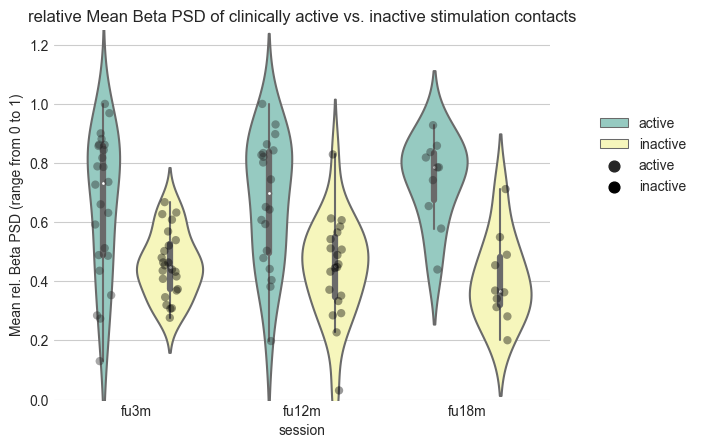

In [156]:
active_vs_inactive = activeStimContacts.active_vs_inactive_contacts_monopolPSD(
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta",
    singleContacts_or_average="averageContacts"
)

In [152]:
active_vs_inactive["results_dictionary"]["significance_results"]

,W-val,alternative,p-val,RBC,CLES,comparison_relativePsdToRank1_averageContacts
Wilcoxon,48.0,two-sided,0.002516,0.680000,0.767361,fu3m_active_fu3m_inactive
Wilcoxon,27.0,two-sided,0.002325,0.742857,0.787500,fu12m_active_fu12m_inactive
Wilcoxon,0.0,two-sided,0.001953,1.000000,0.940000,fu18m_active_fu18m_inactive


In [153]:
active_vs_inactive["results_dictionary"]["description_results"]

,number_observations,min_and_max,mean,variance,skewness,kurtosis
fu3m_active_averageContacts,24,"(0.1299940935730989, 1.0)",0.6617,0.058356,-0.590657,-0.717699
fu3m_inactive_averageContacts,24,"(0.2766563688285066, 0.6678130339626598)",0.456828,0.012221,0.255682,-0.819237
fu12m_active_averageContacts,20,"(0.19793822740065792, 1.0)",0.673343,0.047197,-0.467585,-0.732703
fu12m_inactive_averageContacts,20,"(0.03098309601885988, 0.8291354380495756)",0.446257,0.028974,-0.240253,0.77301
fu18m_active_averageContacts,10,"(0.43989002175094477, 0.9280632824894369)",0.74281,0.021393,-0.883318,-0.117465
fu18m_inactive_averageContacts,10,"(0.20074907220995758, 0.7119152811764736)",0.407333,0.021926,0.710592,-0.112462


pickle file loaded:  GroupMonopolar_weightedPsdCoordinateDistance_relToRank1_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results
Excel file loaded:  BestClinicalStimulation.xlsx 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\data
new files:  ClinicalActiveVsNonactiveContacts_relativeToRank1_psd_beta_averageContacts.pickle 
and: ClinicalActiveVsNonactiveContacts_statistics_relativeToRank1_psd_beta_averageContacts.pickle 
written in in:  c:\Users\jebe12\Research\Longterm_beta_project\results 
new figure: ClinicalActiveVsNonactiveContacts_relativeToRank1_psd_beta__averageContacts.png 
written in:  c:\Users\jebe12\Research\Longterm_beta_project\figures


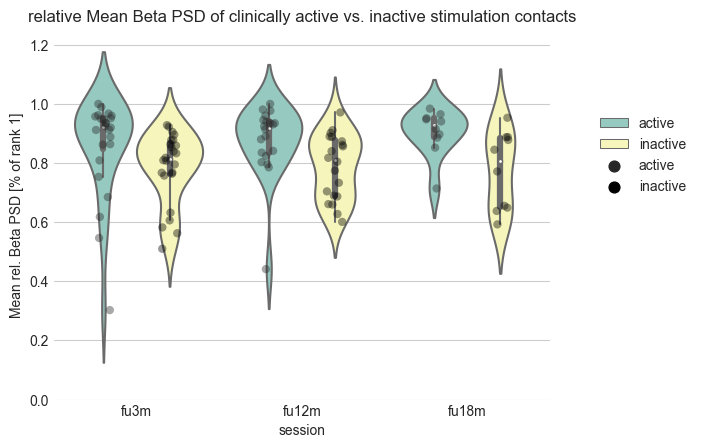

In [145]:
correlateMonoRef_PSDtoRank1 = activeStimContacts.correlateActiveClinicalContacts_monopolPSDrelToRank1(
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta",
    singleContacts_or_average="averageContacts"
)

In [147]:
correlateMonoRef_PSDtoRank1["weightedByCoordinate_Dataframe"].head()

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,relativePSD_to_beta_Rank1from8
0,0,0.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.206574,8.0,0.783786
1,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.263559,1.0,1.000000
2,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,5.0,0.920316
3,1B,2.0+0.0j,-0.325000+0.562917j,017_Right,fu3m,0.235433,7.0,0.893283
4,1C,2.0+0.0j,-0.325000-0.562917j,017_Right,fu3m,0.238925,6.0,0.906535


In [58]:
correlateMonoRef_PSDtoRank1["data_MonoBeta8Ranks"].head()

,subject_hemisphere,session,MEAN_beta_rank,MEANrelToRank1psd,clinicalUse,session_clinicalUse
017_Right_fu3m_active,017_Right,fu3m,5.000000,0.920316,active,fu3m_active
017_Right_fu3m_inactive,017_Right,fu3m,4.428571,0.928176,inactive,fu3m_inactive
017_Right_fu12m_active,017_Right,fu12m,2.500000,0.785359,active,fu12m_active
017_Right_fu12m_inactive,017_Right,fu12m,6.500000,0.600950,inactive,fu12m_inactive
017_Left_fu3m_active,017_Left,fu3m,4.000000,0.888601,active,fu3m_active


In [59]:
correlateMonoRef_PSDtoRank1["results_dictionary"]["significance_results"]

,W-val,alternative,p-val,RBC,CLES,comparison_relativePsdToRank1_averageContacts
Wilcoxon,58.0,two-sided,0.025139,0.541502,0.756198,fu3m_active_fu3m_inactive
Wilcoxon,34.0,two-sided,0.006390,0.676190,0.762500,fu12m_active_fu12m_inactive
Wilcoxon,0.0,two-sided,0.001953,1.000000,0.830000,fu18m_active_fu18m_inactive


In [55]:
correlateMonoRef_PSDtoRank1["results_dictionary"]["description_results"]

,number_observations,min_and_max,mean,variance,skewness,kurtosis
fu3m_active_averageContacts,24,"(0.3026663776335989, 1.0)",0.854456,0.027409,-1.981882,3.480675
fu3m_inactive_averageContacts,24,"(nan, nan)",NaN,NaN,NaN,NaN
fu12m_active_averageContacts,20,"(0.4412559315594231, 1.0)",0.87665,0.014731,-2.379065,6.355339
fu12m_inactive_averageContacts,20,"(0.6009504562069026, 0.9712032890307591)",0.787413,0.01189,-0.174353,-1.23703
fu18m_active_averageContacts,10,"(0.7140489728455736, 0.9841013634239277)",0.898072,0.005626,-1.471054,1.795994
fu18m_inactive_averageContacts,10,"(0.5925656320881224, 0.9531112974116278)",0.769181,0.016095,-0.061307,-1.480394


In [6]:
loaded_data = loadResults.load_GroupMonoRef_weightedPsdCoordinateDistance_pickle(
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta")

pickle file loaded:  GroupMonopolar_weightedPsdCoordinateDistance_relToRank1_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [17]:
loaded_data.head()

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank,relativePSD_to_beta_Rank1
0,0,0.0+0.0j,0.00+0.00j,017_Right,fu3m,0.206574,10.0,0.783786
1,1,2.0+0.0j,0.00+0.00j,017_Right,fu3m,0.242470,7.0,0.919984
2,2,4.0+0.0j,0.00+0.00j,017_Right,fu3m,0.254409,4.0,0.965286
3,3,6.0+0.0j,0.00+0.00j,017_Right,fu3m,0.263559,1.0,1.000000
4,1A,2.0+0.0j,0.65+0.00j,017_Right,fu3m,0.242557,6.0,0.920316


In [21]:
list_sub_hem = list(loaded_data.subject_hemisphere.unique())
list_sub_hem

['017_Right',
 '017_Left',
 '019_Right',
 '019_Left',
 '021_Right',
 '021_Left',
 '024_Right',
 '024_Left',
 '025_Right',
 '025_Left',
 '026_Right',
 '026_Left',
 '028_Right',
 '028_Left',
 '029_Right',
 '029_Left',
 '030_Right',
 '030_Left',
 '031_Right',
 '031_Left',
 '032_Right',
 '032_Left',
 '033_Right',
 '033_Left',
 '038_Right',
 '038_Left']

In [22]:
STN_data = loaded_data[loaded_data.subject_hemisphere == "017_Right"]
STN_data

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank,relativePSD_to_beta_Rank1
0,0,0.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.206574,10.0,0.783786
1,1,2.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.242470,7.0,0.919984
2,2,4.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.254409,4.0,0.965286
3,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.263559,1.0,1.000000
4,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,6.0,0.920316
5,1B,2.0+0.0j,-0.325000+0.562917j,017_Right,fu3m,0.235433,9.0,0.893283
6,1C,2.0+0.0j,-0.325000-0.562917j,017_Right,fu3m,0.238925,8.0,0.906535
7,2A,4.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.262323,2.0,0.995312
8,2B,4.0+0.0j,-0.325000+0.562917j,017_Right,fu3m,0.250728,5.0,0.951316
9,2C,4.0+0.0j,-0.325000-0.562917j,017_Right,fu3m,0.254862,3.0,0.967003


In [28]:
contacts = ["0", "1A", "1B", "1C", "2A", "2B", "2C", "3"]

rank8_data = STN_data[STN_data["contact"].isin(contacts)]
rank8_data

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,rank,relativePSD_to_beta_Rank1
0,0,0.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.206574,10.0,0.783786
3,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.263559,1.0,1.000000
4,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,6.0,0.920316
5,1B,2.0+0.0j,-0.325000+0.562917j,017_Right,fu3m,0.235433,9.0,0.893283
6,1C,2.0+0.0j,-0.325000-0.562917j,017_Right,fu3m,0.238925,8.0,0.906535
7,2A,4.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.262323,2.0,0.995312
8,2B,4.0+0.0j,-0.325000+0.562917j,017_Right,fu3m,0.250728,5.0,0.951316
9,2C,4.0+0.0j,-0.325000-0.562917j,017_Right,fu3m,0.254862,3.0,0.967003
10,0,0.0+0.0j,0.000000+0.000000j,017_Right,fu12m,0.251854,10.0,0.588191
13,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu12m,0.428184,1.0,1.000000


## 10.d Linear mixed effects model for rel. PSD predicting the current polarity of a clinical contact

pip install statsmodels
import statsmodels.formula.api as smf

In [ ]:
# load a Dataframe containing 
    # dependent variable = current polarity
    # fixed effect = monopolar PSD relative to highest PSD
    # and random effect = STN (subject_hemisphere)

In [10]:


freqBand = "beta"
sessions = ["fu3m", "fu12m", "fu18m"]
contacts = ["0", "1A", "1B", "1C", "2A", "2B", "2C", "3"]
weightedByCoordinate_Dataframe = pd.DataFrame() # concat all Dataframes from all sub, hem, sessions

# load Dataframe with PSD values of all channels and STNs
data_weightedByCoordinates = loadResults.load_GroupMonoRef_weightedPsdCoordinateDistance_pickle(
        filterSignal="band-pass",
        normalization="rawPsd",
        freqBand="beta")

# first check, which STNs and sessions exist in data 
sub_hem_keys = list(data_weightedByCoordinates.subject_hemisphere.unique())


for STN in sub_hem_keys:

    # select only one STN
    STN_data = data_weightedByCoordinates[data_weightedByCoordinates.subject_hemisphere == STN]


    for ses in sessions:

        # first check, if session exists in STN data
        if ses not in STN_data.session.values:
            continue

        
        # get the dataframe per session
        STN_session_data = STN_data[STN_data.session == ses]

        # choose only directional contacts and Ring contacts 0, 3 and rank again only the chosen contacts
        STN_session_data = STN_session_data[STN_session_data["contact"].isin(contacts)]
        STN_session_data["Rank8contacts"] = STN_session_data["averaged_monopolar_PSD_beta"].rank(ascending=False)
        STN_session_data_copy = STN_session_data.copy()
        STN_session_data_copy.drop(["rank"], axis=1, inplace=True)

        # calculate the relative PSD to the highest PSD of the 8 remaining contacts
        beta_rank_1 = STN_session_data_copy[STN_session_data_copy["Rank8contacts"] == 1.0] # taking the row containing 1.0 in rank
        beta_rank_1 = beta_rank_1[f"averaged_monopolar_PSD_{freqBand}"].values[0] # just taking psdAverage of rank 1.0

        # new column for rel. PSD to beta_rank_1 PSD
        STN_session_data_copy[f"relativePSD_to_{freqBand}_Rank1from8"] = STN_session_data_copy.apply(lambda row: row[f"averaged_monopolar_PSD_{freqBand}"] / beta_rank_1, axis=1) # in each row add to new value psd/beta_rank1
        STN_session_data_copy.drop([f"relativePSD_to_{freqBand}_Rank1"], axis=1, inplace=True)
        # session_weightedByCoordinates_copy["subject_hemisphere_monoChannel"] = session_weightedByCoordinates_copy[["subject_hemisphere", "monopolarChannels"]].agg("_".join, axis=1)
        

        weightedByCoordinate_Dataframe = pd.concat([weightedByCoordinate_Dataframe, STN_session_data_copy], ignore_index=True)



pickle file loaded:  GroupMonopolar_weightedPsdCoordinateDistance_relToRank1_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [11]:
weightedByCoordinate_Dataframe

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,relativePSD_to_beta_Rank1from8
0,0,0.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.206574,8.0,0.783786
1,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu3m,0.263559,1.0,1.000000
2,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,5.0,0.920316
3,1B,2.0+0.0j,-0.325000+0.562917j,017_Right,fu3m,0.235433,7.0,0.893283
4,1C,2.0+0.0j,-0.325000-0.562917j,017_Right,fu3m,0.238925,6.0,0.906535
...,...,...,...,...,...,...,...,...
427,1B,2.0+0.0j,-0.325000+0.562917j,038_Left,fu3m,2.080709,2.0,0.850418
428,1C,2.0+0.0j,-0.325000-0.562917j,038_Left,fu3m,1.958221,4.0,0.800355
429,2A,4.0+0.0j,0.650000+0.000000j,038_Left,fu3m,1.292512,7.0,0.528270
430,2B,4.0+0.0j,-0.325000+0.562917j,038_Left,fu3m,1.397901,5.0,0.571344


In [12]:
#################### LOAD CLINICAL STIMULATION PARAMETERS #####################

bestClinicalStim_file = loadResults.load_BestClinicalStimulation_excel()

# get sheet with best clinical contacts
BestClinicalContacts = bestClinicalStim_file["BestClinicalContacts"]



##################### FILTER THE MONOBETA8RANKS_DF: clinically ACTIVE contacts #####################
activeMonoBeta8Ranks = pd.DataFrame()

for idx, row in BestClinicalContacts.iterrows():

    activeContacts = str(BestClinicalContacts.CathodalContact.values[idx]) # e.g. "2A_2B_2C_3"
    # split active Contacts into list with single contact strings
    activeContacts_list = activeContacts.split("_") # e.g. ["2A", "2B", "2C", "3"]

    sub_hem = BestClinicalContacts.subject_hemisphere.values[idx]
    session = BestClinicalContacts.session.values[idx]
    currentPolarity = BestClinicalContacts.currentPolarity.values[idx]

    # get rows with equal sub_hem and session and with monopolarChannel in the list of activeContacts
    sub_hem_ses_rows = weightedByCoordinate_Dataframe.loc[(weightedByCoordinate_Dataframe["subject_hemisphere"]==sub_hem) & (weightedByCoordinate_Dataframe["session"]==session) & (weightedByCoordinate_Dataframe["contact"].isin(activeContacts_list))]
    # add a column and fill the cell with the current Polarity
    sub_hem_ses_rows_copy = sub_hem_ses_rows.copy()
    sub_hem_ses_rows_copy["currentPolarity"] = currentPolarity
    
    # concatenate single rows to new Dataframe
    activeMonoBeta8Ranks = pd.concat([activeMonoBeta8Ranks, sub_hem_ses_rows_copy], ignore_index=True)

# add a column "clinicalUse" to the Dataframe and fill with "active"
activeMonoBeta8Ranks["clinicalUse"] = "active"




##################### FILTER THE MONOBETA8RANKS_DF: clinically INACTIVE contacts #####################
inactiveMonoBeta8Ranks = pd.DataFrame()

for idx, row in BestClinicalContacts.iterrows():

    inactiveContacts = str(BestClinicalContacts.InactiveContacts.values[idx]) # e.g. "2A_2B_2C_3"
    # split active Contacts into list with single contact strings
    inactiveContacts_list = inactiveContacts.split("_") # e.g. ["2A", "2B", "2C", "3"]

    sub_hem = BestClinicalContacts.subject_hemisphere.values[idx]
    session = BestClinicalContacts.session.values[idx]

    # get rows with equal sub_hem and session and with monopolarChannel in the list of activeContacts
    sub_hem_ses_rows = weightedByCoordinate_Dataframe.loc[(weightedByCoordinate_Dataframe["subject_hemisphere"]==sub_hem) & (weightedByCoordinate_Dataframe["session"]==session) & (weightedByCoordinate_Dataframe["contact"].isin(inactiveContacts_list))]
    # add a column and fill the cell with the current Polarity
    sub_hem_ses_rows_copy = sub_hem_ses_rows.copy()
    sub_hem_ses_rows_copy["currentPolarity"] = "0"

    # concatenate single rows to new Dataframe
    inactiveMonoBeta8Ranks = pd.concat([inactiveMonoBeta8Ranks, sub_hem_ses_rows_copy], ignore_index=True)

# add a column "clinicalUse" to the Dataframe and fill with "non_active"
inactiveMonoBeta8Ranks["clinicalUse"] = "inactive"



##################### CONCATENATE BOTH DATAFRAMES: CLINICALLY ACTIVE and INACTIVE CONTACTS #####################
active_and_inactive_MonoBeta8Ranks = pd.concat([activeMonoBeta8Ranks, inactiveMonoBeta8Ranks], ignore_index=True)



Excel file loaded:  BestClinicalStimulation.xlsx 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\data


In [13]:
active_and_inactive_MonoBeta8Ranks

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,relativePSD_to_beta_Rank1from8,currentPolarity,clinicalUse
0,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,5.0,0.920316,1.0,active
1,1C,2.0+0.0j,-0.325000-0.562917j,017_Left,fu3m,0.134140,6.0,0.815652,0.5,active
2,2A,4.0+0.0j,0.650000+0.000000j,017_Left,fu3m,0.158134,2.0,0.961551,0.5,active
3,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu12m,0.428184,1.0,1.000000,0.25,active
4,2A,4.0+0.0j,0.650000+0.000000j,017_Right,fu12m,0.305900,3.0,0.714413,0.25,active
...,...,...,...,...,...,...,...,...,...,...
427,0,0.0+0.0j,0.000000+0.000000j,038_Left,fu3m,2.446689,1.0,1.000000,0,inactive
428,3,6.0+0.0j,0.000000+0.000000j,038_Left,fu3m,0.918773,8.0,0.375517,0,inactive
429,1A,2.0+0.0j,0.650000+0.000000j,038_Left,fu3m,1.981272,3.0,0.809777,0,inactive
430,1B,2.0+0.0j,-0.325000+0.562917j,038_Left,fu3m,2.080709,2.0,0.850418,0,inactive


In [14]:

from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()

active_and_inactive_MonoBeta8Ranks["group"] = le.fit_transform(active_and_inactive_MonoBeta8Ranks["subject_hemisphere"])

active_and_inactive_MonoBeta8Ranks["currentPolarity"] = active_and_inactive_MonoBeta8Ranks["currentPolarity"].astype(float)



In [15]:
active_and_inactive_MonoBeta8Ranks

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,relativePSD_to_beta_Rank1from8,currentPolarity,clinicalUse,group
0,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,5.0,0.920316,1.00,active,1
1,1C,2.0+0.0j,-0.325000-0.562917j,017_Left,fu3m,0.134140,6.0,0.815652,0.50,active,0
2,2A,4.0+0.0j,0.650000+0.000000j,017_Left,fu3m,0.158134,2.0,0.961551,0.50,active,0
3,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu12m,0.428184,1.0,1.000000,0.25,active,1
4,2A,4.0+0.0j,0.650000+0.000000j,017_Right,fu12m,0.305900,3.0,0.714413,0.25,active,1
...,...,...,...,...,...,...,...,...,...,...,...
427,0,0.0+0.0j,0.000000+0.000000j,038_Left,fu3m,2.446689,1.0,1.000000,0.00,inactive,24
428,3,6.0+0.0j,0.000000+0.000000j,038_Left,fu3m,0.918773,8.0,0.375517,0.00,inactive,24
429,1A,2.0+0.0j,0.650000+0.000000j,038_Left,fu3m,1.981272,3.0,0.809777,0.00,inactive,24
430,1B,2.0+0.0j,-0.325000+0.562917j,038_Left,fu3m,2.080709,2.0,0.850418,0.00,inactive,24


In [29]:
independent_variable = active_and_inactive_MonoBeta8Ranks["relativePSD_to_beta_Rank1from8"]
dependent_variable = active_and_inactive_MonoBeta8Ranks["currentPolarity"]

random_effect = active_and_inactive_MonoBeta8Ranks["subject_hemisphere"]





In [31]:
active_and_inactive_MonoBeta8Ranks["currentPolarity"]


0      1.00
1      0.50
2      0.50
3      0.25
4      0.25
       ... 
417    0.00
418    0.00
419    0.00
420    0.00
421    0.00
Name: currentPolarity, Length: 422, dtype: float64

                        Mixed Linear Model Regression Results
Model:                    MixedLM         Dependent Variable:         currentPolarity
No. Observations:         422             Method:                     REML           
No. Groups:               26              Scale:                      0.0385         
Min. group size:          8               Log-Likelihood:             76.7784        
Max. group size:          24              Converged:                  Yes            
Mean group size:          16.2                                                       
-------------------------------------------------------------------------------------
                                           Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-------------------------------------------------------------------------------------
Intercept                                  -0.146    0.065 -2.255 0.024 -0.274 -0.019
relativePSD_to_beta_Rank1from8              0.334    0.079  4.237 0.000  0.179

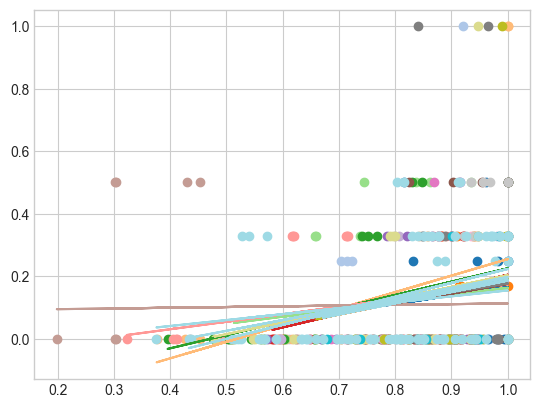

In [49]:

result = smf.mixedlm("currentPolarity ~ relativePSD_to_beta_Rank1from8", data=active_and_inactive_MonoBeta8Ranks, groups="group",
                     re_formula="1 + relativePSD_to_beta_Rank1from8").fit()
print(result.summary())

yp = result.fittedvalues
active_and_inactive_MonoBeta8Ranks["predictions"] = yp

for group in active_and_inactive_MonoBeta8Ranks.group.unique():
    sub_data = active_and_inactive_MonoBeta8Ranks[active_and_inactive_MonoBeta8Ranks.group==group]

    plt.scatter(sub_data["relativePSD_to_beta_Rank1from8"],sub_data["currentPolarity"],color=plt.cm.tab20(group), label="_nolegend_")
    plt.plot(sub_data["relativePSD_to_beta_Rank1from8"],sub_data["predictions"],color=plt.cm.tab20(group))





In [43]:
result.cov_params()

,Intercept,relativePSD_to_beta_Rank1from8,group Var,group x relativePSD_to_beta_Rank1from8 Cov,relativePSD_to_beta_Rank1from8 Var
Intercept,0.004212,-0.005027,-0.004149,-0.000042,0.007452
relativePSD_to_beta_Rank1from8,-0.005027,0.006209,0.004734,0.000321,-0.009199
group Var,-0.004149,0.004734,0.067697,-0.074040,0.075752
group x relativePSD_to_beta_Rank1from8 Cov,-0.000042,0.000321,-0.074040,0.107907,-0.149574
relativePSD_to_beta_Rank1from8 Var,0.007452,-0.009199,0.075752,-0.149574,0.247165


In [37]:
yp

0      0.158932
1      0.128847
2      0.170756
3      0.181821
4      0.099786
         ...   
417    0.181833
418    0.002452
419    0.127192
420    0.138866
421    0.124486
Length: 422, dtype: float64

In [37]:
# try the linear mixed effects model for seperate sessions (fu3m, fu12m, fu18m) and for different thresholds (relPSD = 1.0, > 0.9, > 0.8, > 0.7 etc)

# first try for all values

independent_variable = active_and_inactive_MonoBeta8Ranks["relativePSD_to_beta_Rank1from8"]
dependent_variable = active_and_inactive_MonoBeta8Ranks["currentPolarity"]



formula = "currentPolarity ~ relativePSD_to_beta_Rank1from8 + (relativePSD_to_beta_Rank1from8|subject_hemisphere)"

model = sm.MixedLM(active_and_inactive_MonoBeta8Ranks["currentPolarity"], data=active_and_inactive_MonoBeta8Ranks, groups=active_and_inactive_MonoBeta8Ranks["subject_hemisphere"])

TypeError: MixedLM.__init__() missing 1 required positional argument: 'exog'

In [38]:
independent_variable = active_and_inactive_MonoBeta8Ranks["relativePSD_to_beta_Rank1from8"]
dependent_variable = active_and_inactive_MonoBeta8Ranks["currentPolarity"]

y, x = dmatrices("currentPolarity ~ relativePSD_to_beta_Rank1from8", data=active_and_inactive_MonoBeta8Ranks)


In [44]:
linear_model = sm.OLS(y,x).fit()

## 10.e logistic regression, setting a threshold for relative beta PSD to highest PSD within an electrode, predicting active contacts

In [127]:
monopol_relPsd_0_to_8 = loadResults.load_monopol_rel_psd_from0To8_pickle(
    filterSignal="band-pass",
    normalization="rawPsd",
    freqBand="beta"
)



pickle file loaded:  monopol_rel_psd_from0To8_beta_rawPsd_band-pass.pickle 
loaded from:  c:\Users\jebe12\Research\Longterm_beta_project\results


In [193]:
monopol_relPsd_0_to_8

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,relativePSD_beta_from_0_to_1,relativePSD_beta_to_mean_std,currentPolarity,clinicalUse
0,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,5.0,0.631459,-0.098256,1.0,active
1,1C,2.0+0.0j,-0.325000-0.562917j,017_Left,fu3m,0.134140,6.0,0.153724,-0.811742,0.5,active
2,2A,4.0+0.0j,0.650000+0.000000j,017_Left,fu3m,0.158134,2.0,0.823492,1.009836,0.5,active
3,3,6.0+0.0j,0.000000+0.000000j,017_Right,fu12m,0.428184,1.0,1.000000,2.251914,0.25,active
4,2A,4.0+0.0j,0.650000+0.000000j,017_Right,fu12m,0.305900,3.0,0.306505,0.156010,0.25,active
5,2B,4.0+0.0j,-0.325000+0.562917j,017_Right,fu12m,0.301154,4.0,0.279589,0.074664,0.25,active
6,2C,4.0+0.0j,-0.325000-0.562917j,017_Right,fu12m,0.309875,2.0,0.329044,0.224129,0.25,active
7,3,6.0+0.0j,0.000000+0.000000j,017_Left,fu12m,0.212629,8.0,0.000000,-2.296615,0.25,active
8,2A,4.0+0.0j,0.650000+0.000000j,017_Left,fu12m,0.255729,1.0,1.000000,0.823776,0.25,active
9,2B,4.0+0.0j,-0.325000+0.562917j,017_Left,fu12m,0.251168,3.0,0.894184,0.493589,0.25,active


In [175]:
shortDF = monopol_relPsd_0_to_8.loc[(monopol_relPsd_0_to_8.session == "fu3m")]

shortDF.head()

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,relativePSD_beta_from_0_to_1,relativePSD_beta_to_mean_std,currentPolarity,clinicalUse
0,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,5.0,0.631459,-0.098256,1.0,active
1,1C,2.0+0.0j,-0.325000-0.562917j,017_Left,fu3m,0.134140,6.0,0.153724,-0.811742,0.5,active
2,2A,4.0+0.0j,0.650000+0.000000j,017_Left,fu3m,0.158134,2.0,0.823492,1.009836,0.5,active
11,0,0.0+0.0j,0.000000+0.000000j,019_Right,fu3m,0.796842,1.0,1.000000,1.649256,1.0,active
12,1A,2.0+0.0j,0.650000+0.000000j,019_Left,fu3m,0.524650,1.0,1.000000,1.327071,0.33,active


In [92]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

In [178]:
# exchange active with 1 and inactive with 0
clinicalUse_as_int = shortDF.replace(to_replace="active", value=1)
clinicalUse_as_int = clinicalUse_as_int.replace(to_replace="inactive", value=0)
clinicalUse_as_int.head()

,contact,coord_z,coord_xy,subject_hemisphere,session,averaged_monopolar_PSD_beta,Rank8contacts,relativePSD_beta_from_0_to_1,relativePSD_beta_to_mean_std,currentPolarity,clinicalUse
0,1A,2.0+0.0j,0.650000+0.000000j,017_Right,fu3m,0.242557,5.0,0.631459,-0.098256,1.0,1
1,1C,2.0+0.0j,-0.325000-0.562917j,017_Left,fu3m,0.134140,6.0,0.153724,-0.811742,0.5,1
2,2A,4.0+0.0j,0.650000+0.000000j,017_Left,fu3m,0.158134,2.0,0.823492,1.009836,0.5,1
11,0,0.0+0.0j,0.000000+0.000000j,019_Right,fu3m,0.796842,1.0,1.000000,1.649256,1.0,1
12,1A,2.0+0.0j,0.650000+0.000000j,019_Left,fu3m,0.524650,1.0,1.000000,1.327071,0.33,1


In [179]:
# split the data into a test dataset = 0.25
x_train, x_test, y_train, y_test = train_test_split(clinicalUse_as_int.relativePSD_beta_from_0_to_1.values, 
                                                    clinicalUse_as_int.clinicalUse.values, 
                                                    test_size=0.25, 
                                                    random_state=16)

# x = relativePSD_to_beta_Rank1from8 column
# y = clinicalUse column

{'whiskers': [<matplotlib.lines.Line2D at 0x13956e1c8e0>,
 'caps': [<matplotlib.lines.Line2D at 0x13956e1d1b0>,
 'boxes': [<matplotlib.lines.Line2D at 0x13956e1c5b0>,
 'medians': [<matplotlib.lines.Line2D at 0x13956e1d4e0>,
 'fliers': [<matplotlib.lines.Line2D at 0x13956e1e170>,
 'means': []}

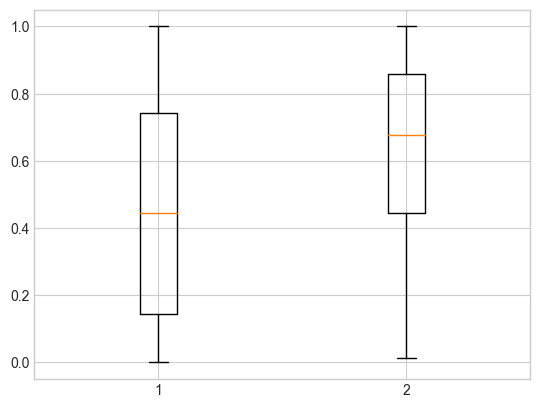

In [180]:
meh =[np.array(x_train[y_train==0]).ravel(),
np.array(x_train[y_train==1]).ravel()]
plt.boxplot(meh)


In [181]:
x_train = x_train.reshape(-1, 1)
x_test = x_test.reshape(-1, 1)




In [187]:
# all parameters not specified are set to their defaults
logisticRegr = LogisticRegression(C=100,  solver='newton-cg')

# train the model on the data
logisticRegr.fit(x_train, y_train)

LogisticRegression(C=100, solver='newton-cg')

In [188]:
y_pred = logisticRegr.predict(x_test)
y_pred

array([0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 1], dtype=int64)

In [184]:
from sklearn.model_selection import  RepeatedStratifiedKFold, GridSearchCV
solvers = ['newton-cg', 'lbfgs', 'liblinear']
penalty = ['l2']
c_values = [100, 10, 1.0, 0.1, 0.01]

model = LogisticRegression()


# define grid search
grid = dict(solver=solvers,penalty=penalty,C=c_values)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='balanced_accuracy',error_score=0) # "f1"
grid_result = grid_search.fit(x_train, y_train)

# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.500000 using {'C': 1.0, 'penalty': 'l2', 'solver': 'liblinear'}
0.496389 (0.093415) with: {'C': 100, 'penalty': 'l2', 'solver': 'newton-cg'}
0.496389 (0.093415) with: {'C': 100, 'penalty': 'l2', 'solver': 'lbfgs'}
0.496389 (0.093415) with: {'C': 100, 'penalty': 'l2', 'solver': 'liblinear'}
0.488889 (0.092209) with: {'C': 10, 'penalty': 'l2', 'solver': 'newton-cg'}
0.488889 (0.092209) with: {'C': 10, 'penalty': 'l2', 'solver': 'lbfgs'}
0.488889 (0.092209) with: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
0.493333 (0.028087) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'newton-cg'}
0.493333 (0.028087) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
0.500000 (0.000000) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'liblinear'}
0.500000 (0.000000) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'newton-cg'}
0.500000 (0.000000) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'lbfgs'}
0.500000 (0.000000) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'liblinear'}
0.500000 (0.000000) wit

In [189]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[30,  5],
       [11,  2]], dtype=int64)

Text(0.5, 427.9555555555555, 'Predicted label')

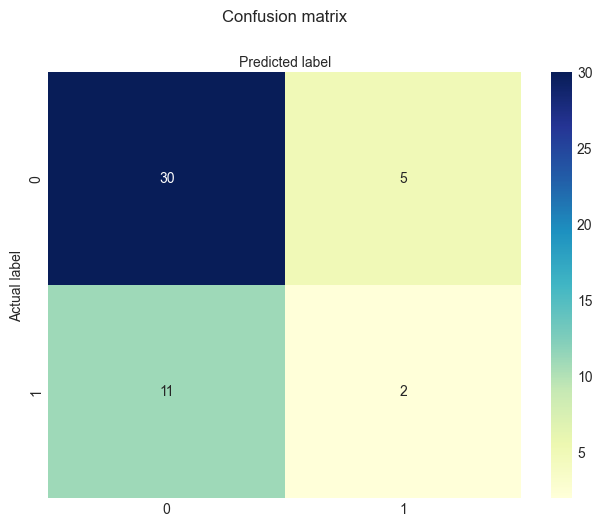

In [190]:
class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)

# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')


In [191]:
from sklearn.metrics import classification_report

target_names = ['inactive', 'active']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

    inactive       0.73      0.86      0.79        35
      active       0.29      0.15      0.20        13

    accuracy                           0.67        48
   macro avg       0.51      0.51      0.49        48
weighted avg       0.61      0.67      0.63        48



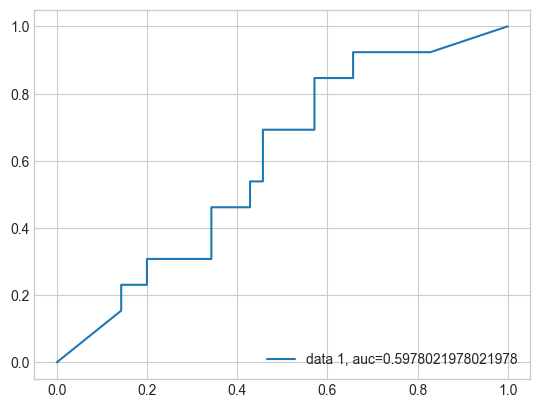

In [192]:
y_pred_proba = logisticRegr.predict_proba(x_test)[::,1]
fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)
auc = metrics.roc_auc_score(y_test, y_pred_proba)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

In [117]:
logisticRegr.coef_

array([[2.56138201]])